<h1> Laptop Price Prediction </h2> 

In this notebook we explore, analyze and preprocess a dataset that encompasses laptop specifications and their respective prices, before building, testing and evaluating statistical models to predict these prices based on the specifications. 

# **[1]** Import Libraries and Data

In [505]:
# Basic Libraries
import pandas as pd
import numpy as np

# EDA
import plotly.express as px
# from bokeh.plotting import figure, output_file, show
from matplotlib import pyplot as plt
import seaborn as sns

# Preprocessing and Feature Engineering
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# Modelling
from sklearn.tree import DecisionTreeRegressor, plot_tree
import statsmodels.api as sm

# Evaluation
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy import stats

In [506]:
! pip install dataprep
from dataprep.eda import plot, plot_correlation

In [507]:
df_url = "https://raw.githubusercontent.com/karlcatsky/SLDS-Group-Project/main/LaptopPrices.csv"
df = pd.read_csv(df_url)

# **[2]** Exploratory Data Analysis

##  [2.1] Dataset Overview

In [508]:
dtypes = df.dtypes
dtypes_df = pd.DataFrame({
    'Original Columns': dtypes.index,
    'Original Data-Types': dtypes.values
})
dtypes_df

,Original Columns,Original Data-Types
0,Company,object
1,Product,object
2,TypeName,object
3,Inches,float64
4,ScreenResolution,object
5,Cpu,object
6,Ram,object
7,Memory,object
8,Gpu,object
9,OpSys,object


In [509]:
# Get an overview of the dataset
print(df.head())
print(df.info())
print(df.describe())

  Company      Product   TypeName  Inches                    ScreenResolution  \
0   Apple  MacBook Pro  Ultrabook    13.3  IPS Panel Retina Display 2560x1600   
1   Apple  Macbook Air  Ultrabook    13.3                            1440x900   
2      HP       250 G6   Notebook    15.6                   Full HD 1920x1080   
3   Apple  MacBook Pro  Ultrabook    15.4  IPS Panel Retina Display 2880x1800   
4   Apple  MacBook Pro  Ultrabook    13.3  IPS Panel Retina Display 2560x1600   

                          Cpu   Ram               Memory  \
0        Intel Core i5 2.3GHz   8GB            128GB SSD   
1        Intel Core i5 1.8GHz   8GB  128GB Flash Storage   
2  Intel Core i5 7200U 2.5GHz   8GB            256GB SSD   
3        Intel Core i7 2.7GHz  16GB            512GB SSD   
4        Intel Core i5 3.1GHz   8GB            256GB SSD   

                            Gpu  OpSys  Weight  Price_euros  
0  Intel Iris Plus Graphics 640  macOS  1.37kg      1339.69  
1        Intel HD Graphics 6

In [510]:
df.describe()

,Inches,Price_euros
count,1303.000000,1303.000000
mean,15.017191,1123.686992
std,1.426304,699.009043
min,10.100000,174.000000
25%,14.000000,599.000000
50%,15.600000,977.000000
75%,15.600000,1487.880000
max,18.400000,6099.000000


## [2.2]  Target Variable: Price_euros

Distribution of laptop prices

In [511]:
print("Median laptop price: ", df['Price_euros'].median())

Median laptop price:  977.0


In [512]:
print("Number of price points: ", len(df['Price_euros'].unique()))

Number of price points:  791


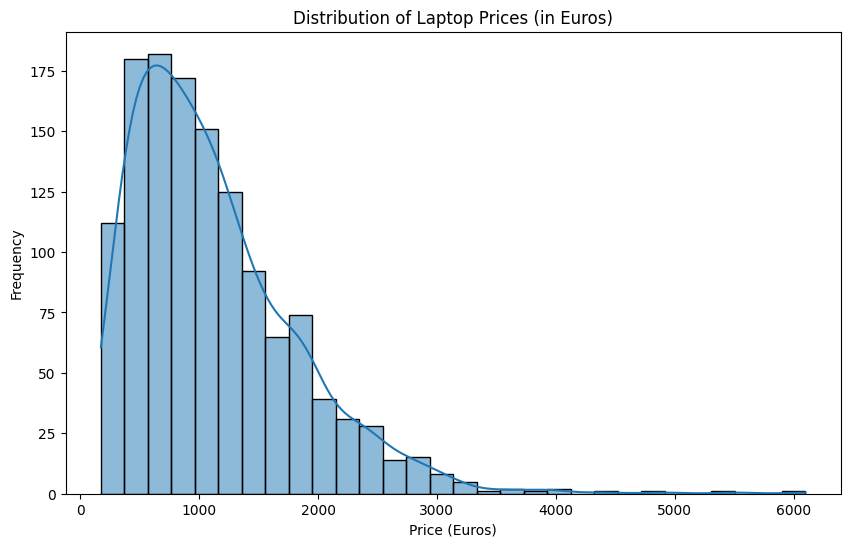

In [513]:
# Explore distributions
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.histplot(df['Price_euros'], bins=30, kde=True)
plt.title('Distribution of Laptop Prices (in Euros)')
plt.xlabel('Price (Euros)')
plt.ylabel('Frequency')
plt.show()

The distribution on its face does not appear to be normal, but let's confirm with a normaltest

In [514]:
statistic_train, p_value = stats.normaltest(df['Price_euros'])

alpha = 0.05
if p_value < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

The data does not appear to be normally distributed: reject the Null Hypothesis


Outlier Analysis

- We will consider removing the extreme outliers above 4000 euros, visualized in the histogram above as those small bumps at the right tail. Large deltas of several hundred euros outliers separate these outliers from each other, while some are distant from the main body of the distribution by thousands. 4k is nearly double the 95th percentile, and more than one IQR above 95th percentile.
- We will use Tukey's Method: identify and remove extreme outliers, defined as those lying more than three times the IQR (above the third quartile).

In [515]:
# Tukey threshold = Q3 + IQR * 3
Q1 = df['Price_euros'].quantile(0.25)
Q3 = df['Price_euros'].quantile(0.75)
IQR = Q3 - Q1

Tukey_threshold = Q3 + IQR * 3
extreme_price_outliers = df.loc[df['Price_euros'] > Tukey_threshold]

extreme_price_outliers


,Company,Product,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price_euros
196,Razer,Blade Pro,Gaming,17.3,4K Ultra HD / Touchscreen 3840x2160,Intel Core i7 7820HK 2.9GHz,32GB,1TB SSD,Nvidia GeForce GTX 1080,Windows 10,3.49kg,6099.0
610,Lenovo,Thinkpad P51,Notebook,15.6,IPS Panel 4K Ultra HD 3840x2160,Intel Xeon E3-1535M v6 3.1GHz,32GB,1TB SSD,Nvidia Quadro M2200M,Windows 10,2.5kg,4899.0
749,HP,Zbook 17,Workstation,17.3,IPS Panel Full HD 1920x1080,Intel Xeon E3-1535M v5 2.9GHz,16GB,256GB SSD,Nvidia Quadro M2000M,Windows 7,3kg,4389.0
830,Razer,Blade Pro,Gaming,17.3,4K Ultra HD / Touchscreen 3840x2160,Intel Core i7 7820HK 2.9GHz,32GB,512GB SSD,Nvidia GeForce GTX 1080,Windows 10,3.49kg,5499.0


Extreme outlier analysis: all contain an Nvidia GPU, Intel processor 2.9GHz or higher, HD screen resolution, 15.6" or 17.4" screen-size, 256GB memory or higher, 16GB RAM or higher, Windows 7 or more recent, weight between 2.5 and 3.5 kg, Gaming, Notebook or Workstation types. Zbook 17 looks the most anomalous with only 16GB Ram.

Note that mean exceeds median by nearly 1std due to outliers. however, outliers don't appear especially extreme (yet) since they resemble


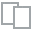
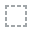
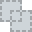
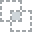
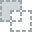
...
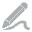
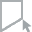
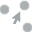
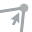
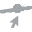

In [516]:
plot(df, 'Price_euros')

## [2.3] Product

In [517]:
df['Product'].value_counts()

XPS 13                                     30
Inspiron 3567                              29
250 G6                                     21
Legion Y520-15IKBN                         19
Vostro 3568                                19
                                           ..
15-bw007nv (A10-9620P/6GB/128GB/Radeon      1
SmartBook 130                               1
A541NA-GO342 (N3350/4GB/500GB/Linux)        1
17-X047na (i3-6006U/8GB/1TB/W10)            1
V330-15IKB (i5-8250U/4GB/500GB/FHD/W10)     1
Name: Product, Length: 618, dtype: int64

In [518]:
product_unique = df['Product'].unique()
print("Number of observations in the dataset: ", len(df.index))
print("Number of unique laptops in the dataset: ", len(product_unique))

Number of observations in the dataset:  1303
Number of unique laptops in the dataset:  618


The large number of unique values for Product in the dataset suggests that this variable will not be useful for modelling. It is more like an index than a feature.

## [2.3] Company: Market Share represented in the data sample

In [519]:
print(len(df['Company'].unique()))

19


In [520]:
df['Company'].value_counts()

Dell         297
Lenovo       297
HP           274
Asus         158
Acer         103
MSI           54
Toshiba       48
Apple         21
Samsung        9
Razer          7
Mediacom       7
Microsoft      6
Xiaomi         4
Vero           4
Chuwi          3
Google         3
Fujitsu        3
LG             3
Huawei         2
Name: Company, dtype: int64

In [521]:
print(f'Companies in this dataset are: {df.Company.unique()} \n\n Number of Companies: {len(df.Company.unique())}')

Companies in this dataset are: ['Apple' 'HP' 'Acer' 'Asus' 'Dell' 'Lenovo' 'Chuwi' 'MSI' 'Microsoft'
 'Toshiba' 'Huawei' 'Xiaomi' 'Vero' 'Razer' 'Mediacom' 'Samsung' 'Google'
 'Fujitsu' 'LG'] 

 Number of Companies: 19


Distribution of laptops by company

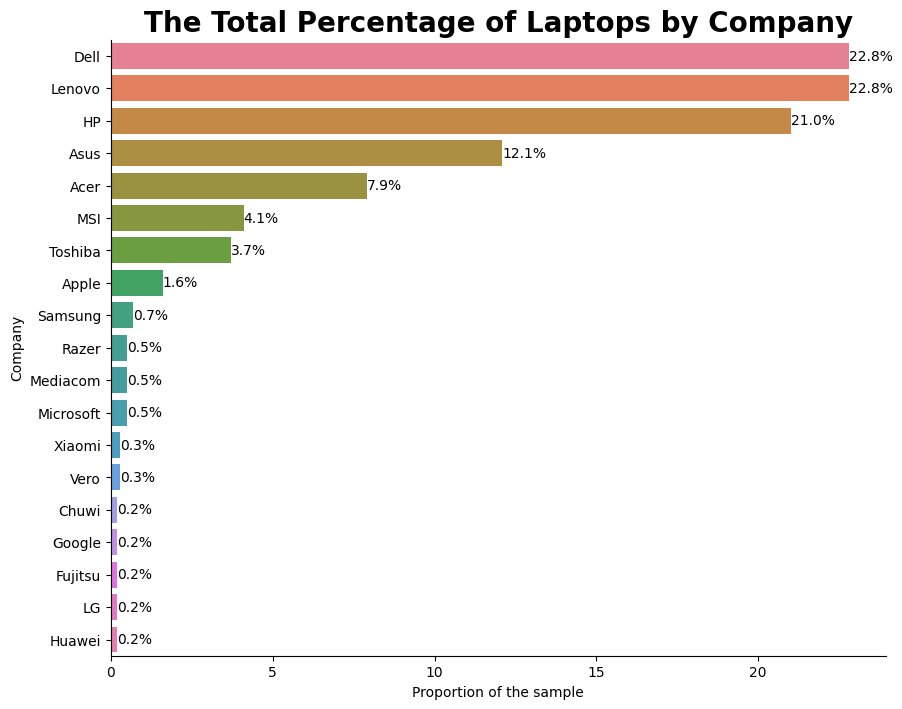

In [522]:
# Calculate the value counts as percentages
value_counts_percentages = (df['Company'].value_counts(normalize=True) * 100).round(1)

# Create a bar plot with Seaborn
plt.figure(figsize=(10, 8))
ax = sns.barplot(y=value_counts_percentages.index, x=value_counts_percentages.values, hue=value_counts_percentages.index, orient='h')

# Annotate each bar with the percentage
for index, value in enumerate(value_counts_percentages):
    ax.text(value, index, f'{value}%', va='center')

# Remove gridlines
ax.grid(False)

# Use despine to remove spines
sns.despine(ax=ax)

# Set the labels and title
ax.set_xlabel('Proportion of the sample')
ax.set_ylabel('Company')
ax.set_title('The Total Percentage of Laptops by Company', fontweight='bold',fontsize=20)

plt.show()

- Dell and Lenovo emerge as the most prevalent laptop manufacturers, each contributing 297 laptops to the dataset.
- HP follows closely behind with 274 laptops, maintaining a significant presence in the sample.
- Asus and Acer exhibit moderate representation, with 158 and 103 laptops, respectively.
- Other manufacturers such as MSI, Toshiba, Apple, and Samsung contribute to the dataset with varying degrees of representation, ranging from single-digit to triple-digit counts.

Relationships between Company and Price

In [523]:
# Grouping and aggregation
grouped_data = df.groupby('Company')['Price_euros'].mean().sort_values(ascending=False)
print("Mean Prices by Company:")
print(grouped_data)

Mean Prices by Company:
Company
Razer        3346.142857
LG           2099.000000
MSI          1728.908148
Google       1677.666667
Microsoft    1612.308333
Apple        1564.198571
Huawei       1424.000000
Samsung      1413.444444
Toshiba      1267.812500
Dell         1186.068990
Xiaomi       1133.462500
Asus         1104.169367
Lenovo       1086.384444
HP           1067.774854
Fujitsu       729.000000
Acer          626.775825
Chuwi         314.296667
Mediacom      295.000000
Vero          217.425000
Name: Price_euros, dtype: float64


The mean prices of laptops vary significantly across different manufacturers. Razer tops the list with an average price of €3346.14, followed by LG at €2099.00, and MSI at €1728.91. Other notable brands include Google (€1677.67), Microsoft (€1612.31), and Apple (€1564.20). On the lower end of the spectrum, we find brands like Acer (€626.78), Chuwi (€314.30), and Mediacom (€295.00).

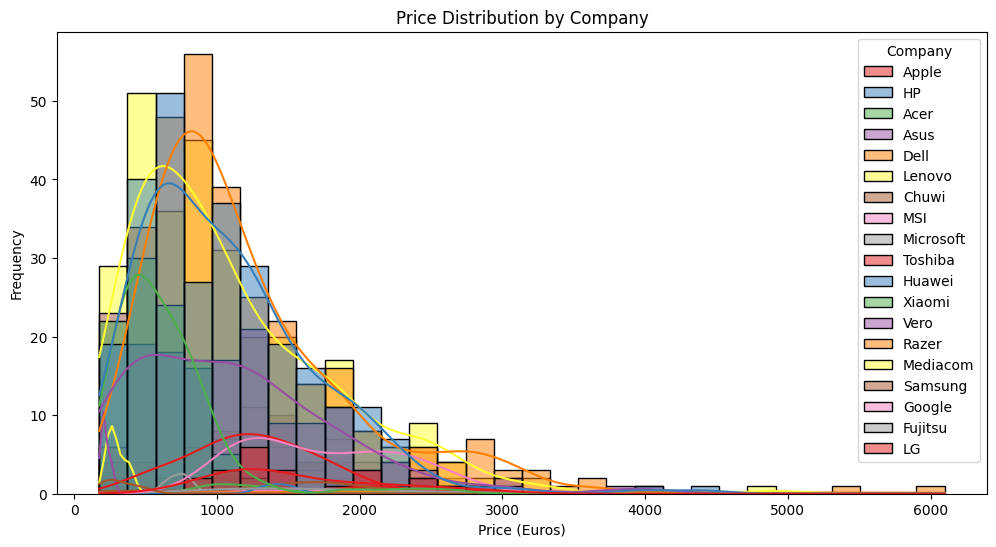

In [524]:
# Stratified price distribution by 'Company'
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='Price_euros', hue='Company', bins=30, kde=True, palette='Set1')
plt.title('Price Distribution by Company')
plt.xlabel('Price (Euros)')
plt.ylabel('Frequency')
#plt.legend(title='Company', bbox_to_anchor=(1, 1))
plt.show()


## [2.4] Laptop Types ('TypeName')

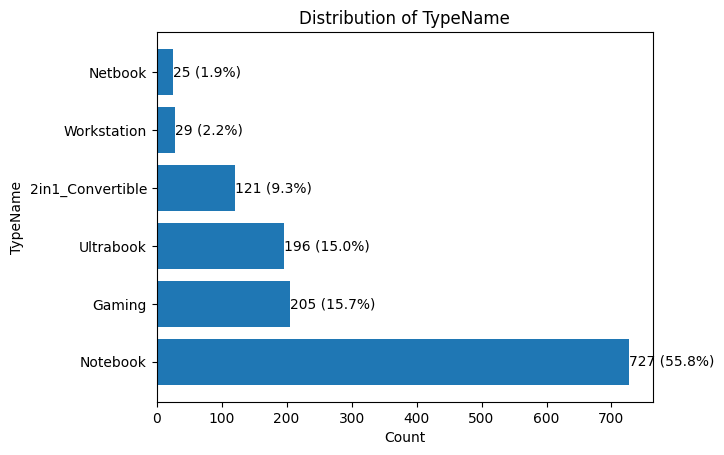

In [525]:
# distribution of laptop types available
value_counts = df['TypeName'].value_counts()
percentages = value_counts / len(df) * 100
plt.barh(value_counts.index, value_counts)
for i, v in enumerate(value_counts):
    plt.text(v, i, f'{v} ({percentages.iloc[i]:.1f}%)', va='center')
plt.title('Distribution of TypeName')
plt.xlabel('Count')
plt.ylabel('TypeName')

# Display the plot
plt.show()

Notebooks are the most prevalent, followed by Gaming laptops and Ultrabooks. The distribution reflects the diversity of laptop types available, catering to various user preferences and needs.

<ipython-input-526-e29bee0c1c25>:7: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  ax = sns.barplot(x='TypeName', y='Price_euros', data=average_prices, ci=None)


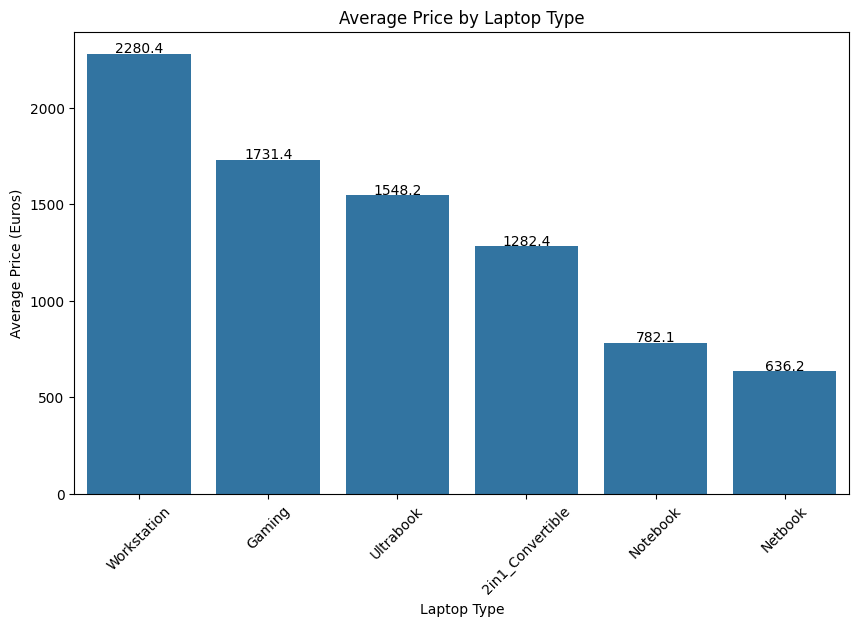

In [526]:
# Calculate the average prices by 'TypeName'
average_prices = df.groupby('TypeName')['Price_euros'].mean().reset_index()

average_prices = average_prices.sort_values('Price_euros', ascending=False)

plt.figure(figsize=(10, 6))
ax = sns.barplot(x='TypeName', y='Price_euros', data=average_prices, ci=None)
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width() / 2, height + 5, f'{height:.1f}', ha='center')
plt.title('Average Price by Laptop Type')
plt.xlabel('Laptop Type')
plt.ylabel('Average Price (Euros)')
plt.xticks(rotation=45)
plt.show()

We can observe a good range of average price for the respective laptop types, which suggests that this variable may be useful in predicting price. We will later use one-hot encoding to create binary variables for these typenames.

The boxplot below can also give us an idea of the frequency of types and the price distribution ranges.

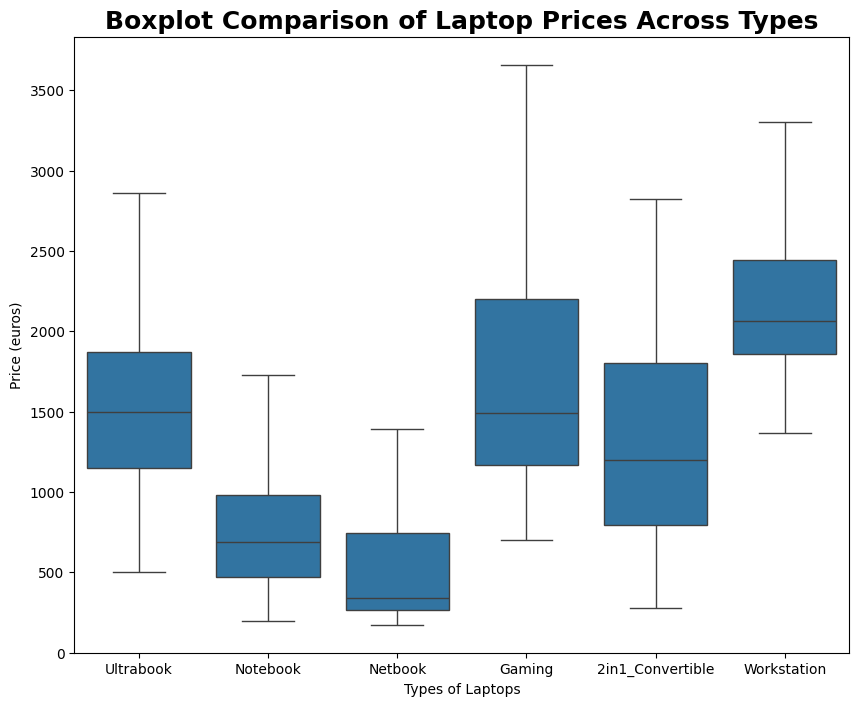

<Figure size 640x480 with 0 Axes>

In [527]:
plt.figure(figsize=(10, 8))
barplot = sns.boxplot(y='Price_euros', x='TypeName',data=df,showfliers=False)

# Set the labels and title
plt.xlabel('Types of Laptops')
plt.ylabel('Price (euros)')
plt.title('Boxplot Comparison of Laptop Prices Across Types',fontweight='bold',fontsize= 18)

plt.show()
sns.despine()

The boxplot shows we have a good number of samples for each type, which allays the potential concern that the average price (displayed in the barchart above) might be calculated from insufficient samples.

## [2.5] Screen Size ('Inches')

In [528]:
inches_nunique = len(df['Inches'].unique())
print(f"{inches_nunique} unique values for 'Inches'")

18 unique values for 'Inches'


In [529]:
print("Value counts for 'Inches': ")
print(df['Inches'].value_counts())

Value counts for 'Inches': 
15.6    665
14.0    197
13.3    164
17.3    164
12.5     39
11.6     33
12.0      6
13.5      6
13.9      6
12.3      5
10.1      4
15.4      4
15.0      4
13.0      2
18.4      1
17.0      1
14.1      1
11.3      1
Name: Inches, dtype: int64


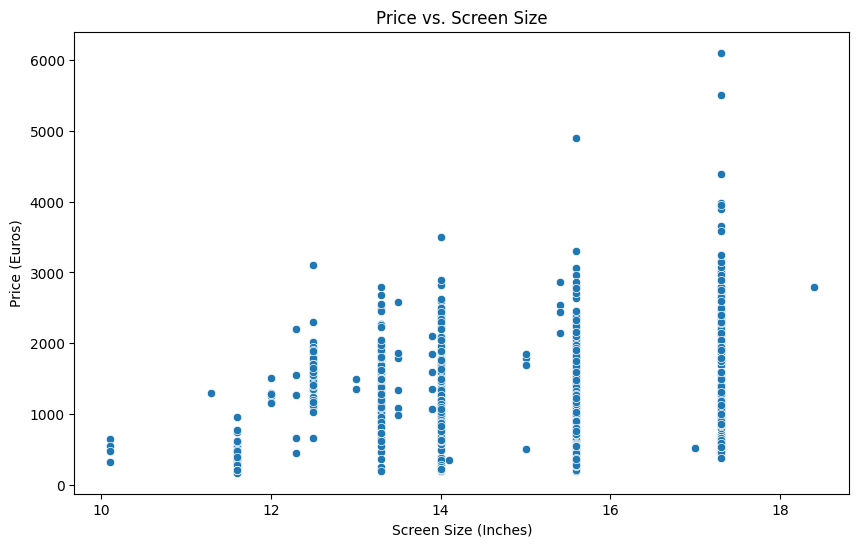

In [530]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Inches', y='Price_euros', data=df)
plt.title('Price vs. Screen Size')
plt.xlabel('Screen Size (Inches)')
plt.ylabel('Price (Euros)')
plt.show()

From the data points, we can observe a positive correlation between screen size and price. As the screen size increases, the prices of laptops tend to be higher on average. However, there is a significant spread in the prices for any given screen size, indicating that factors other than just screen size also influence the pricing.

## [2.6] Screen Resolution

Unique Values

In [531]:
screenres_nunique = df.ScreenResolution.unique()
print("Number of unique values for 'ScreenResolution': ")
print(len(screenres_nunique))

Number of unique values for 'ScreenResolution': 
40


We can see that the specs are formatted with a textual description of the panel type: IPS, Touchscreen etc. along with [width_resolution]x[height_resolution], e.g. 3200x1800.

In [532]:
print("Value counts for 'ScreenResolution'")
print(df['ScreenResolution'].value_counts())

Value counts for 'ScreenResolution'
Full HD 1920x1080                                507
1366x768                                         281
IPS Panel Full HD 1920x1080                      230
IPS Panel Full HD / Touchscreen 1920x1080         53
Full HD / Touchscreen 1920x1080                   47
1600x900                                          23
Touchscreen 1366x768                              16
Quad HD+ / Touchscreen 3200x1800                  15
IPS Panel 4K Ultra HD 3840x2160                   12
IPS Panel 4K Ultra HD / Touchscreen 3840x2160     11
4K Ultra HD / Touchscreen 3840x2160               10
4K Ultra HD 3840x2160                              7
Touchscreen 2560x1440                              7
IPS Panel 1366x768                                 7
IPS Panel Quad HD+ / Touchscreen 3200x1800         6
IPS Panel Retina Display 2560x1600                 6
IPS Panel Retina Display 2304x1440                 6
Touchscreen 2256x1504                              6
IPS Panel 

There are four main panel types: IPS, TN, VA and OLED. All these are LCD.
Quad HD is equivalent to 2560x1440, which is between full HD and 4k. These attributes are already captured by the resolution numbers, e.g. 3200x1800 for Quad and 1920x1080 for Full. 1366x768 is between 720p and 1080p. 1600x900 is between that and the full HD 1080. This is helpful: it means we can disregard all the text data that simply describes the resolution numbers.

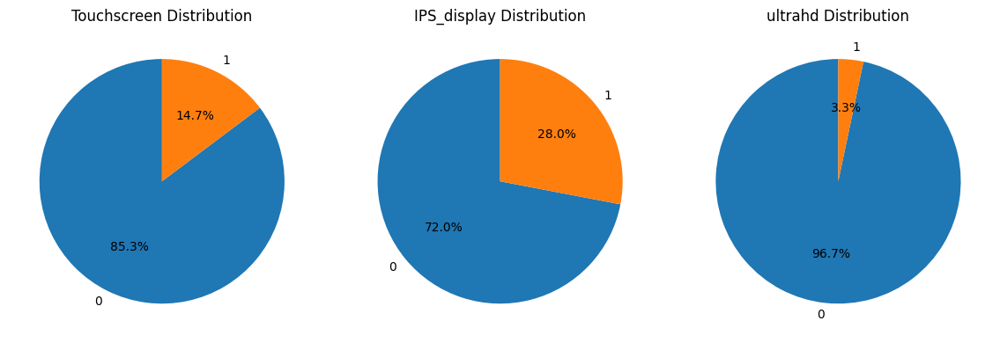

In [533]:
df['Touchscreen']=df['ScreenResolution'].apply(lambda x:1 if 'Touchscreen' in x else 0)
df['IPS_display']=df['ScreenResolution'].apply(lambda x:1 if 'IPS' in x else 0)
df['ultrahd']=df['ScreenResolution'].apply(lambda x:1 if '4K' in x else 0)

import matplotlib.pyplot as plt
import pandas as pd

fig, axes = plt.subplots(1, 3, figsize=(12, 4))

columns = ['Touchscreen', 'IPS_display', 'ultrahd']

for i, column in enumerate(columns):
    # Calculate value counts
    value_counts = df[column].value_counts()

    percentages = value_counts / len(df) * 100

    axes[i].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=90)

    axes[i].set_title(f'{column} Distribution')
    plt.tight_layout()
plt.show()

- Touchscreen Distribution:
85.3% of laptops do not have a touchscreen display.
14.7% of laptops have a touchscreen display.

- IPSdisplay Distribution:
72.0% of laptops do not have an IPS (In-Plane Switching) display.
28.0% of laptops have an IPS display.

- ultrahd Distribution:
96.7% of laptops do not have an ultra high-definition (ultrahd) display.
3.3% of laptops have an ultrahd display.

- the charts indicate that the majority of laptops in this dataset lack features like touchscreens, IPS displays, and ultrahd displays.

## [2.7] CPU

In [534]:
print("Number of unique values for 'CPU'")
print(len(df['Cpu'].unique()))

Number of unique values for 'CPU'
118


In [535]:
print("Value counts for 'CPU'")
print(df['Cpu'].value_counts())

Value counts for 'CPU'
Intel Core i5 7200U 2.5GHz       190
Intel Core i7 7700HQ 2.8GHz      146
Intel Core i7 7500U 2.7GHz       134
Intel Core i7 8550U 1.8GHz        73
Intel Core i5 8250U 1.6GHz        72
                                ... 
Intel Core M M3-6Y30 0.9GHz        1
AMD A9-Series 9420 2.9GHz          1
Intel Core i3 6006U 2.2GHz         1
AMD A6-Series 7310 2GHz            1
Intel Xeon E3-1535M v6 3.1GHz      1
Name: Cpu, Length: 118, dtype: int64


## [2.8] RAM

In the bar plot below, the blue bars represent a statistical estimate of the price based on the laptop's RAM, with the black lines representing an error bar, indicating the uncertainty of the estimate. We can see for instance that the estimate of ~4000 euros for a laptop with 64GB RAM is entirely certain, while estimates for laptops with 24GB RAM are least certain. We can observe a fairly linear relationship between price and exponent-2 of RAM. This suggests that RAM is likely to be a useful feature in predicting price.

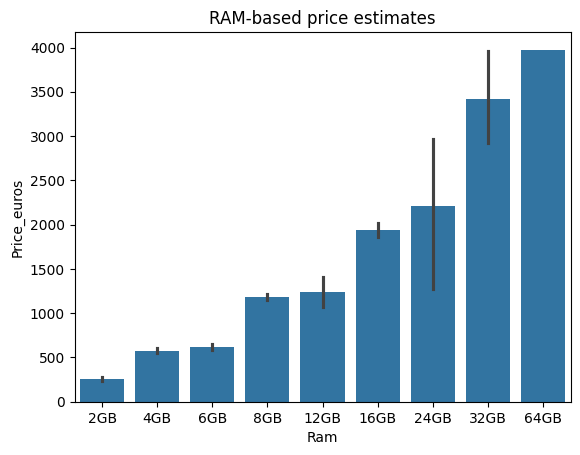

In [536]:
Ram_order = ['2GB', '4GB', '6GB', '8GB', '12GB', '16GB', '24GB', '32GB', '64GB']
plt.figure()
Ram_price_plot = sns.barplot(x='Ram',y='Price_euros',data=df,order=Ram_order)
Ram_price_plot.set_title('RAM-based price estimates')
plt.show()

We can see that only one laptop in the dataset has 64GB RAM, which explains why the price estimate is so certain.

In [537]:
df['Ram'].value_counts()

8GB     619
4GB     375
16GB    200
6GB      41
12GB     25
2GB      22
32GB     17
24GB      3
64GB      1
Name: Ram, dtype: int64

Below we look at the specs for those 24GB RAM laptops which had the greatest uncertainty in price estimate, of which there are only 3 in the dataset. We can see that the highest price for these laptops -- 2968 euros -- is more than double the lowest price -- 1269 euros.

In [538]:
GB24 = df.loc[df['Ram'] == "24GB"]
GB24

,Company,Product,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd
438,Lenovo,ThinkPad T470s,Ultrabook,14.0,2560x1440,Intel Core i7 7500U 2.7GHz,24GB,512GB SSD,Intel HD Graphics 620,Windows 10,1.32kg,2382.0,0,0,0
494,Asus,Rog G752VL-UH71T,Gaming,17.3,IPS Panel Full HD / Touchscreen 1920x1080,Intel Core i7 6700HQ 2.6GHz,24GB,256GB SSD + 1TB HDD,Nvidia GeForce GTX 965M,Windows 10,4.33kg,1269.0,1,1,0
517,Asus,ROG Zephyrus,Gaming,15.6,Full HD 1920x1080,Intel Core i7 7700HQ 2.8GHz,24GB,512GB SSD,Nvidia GeForce GTX1080,Windows 10,2.24kg,2968.0,0,0,0


We create a new variable, 'Ram_Price_Ratio', which tells us, for each laptop, how many euros each GB RAM costs, and get some descriptive statistics.

In [539]:
# Transform Ram to an int so we can compute values against price
df['Ram'] = df['Ram'].str.replace('GB', '').astype(int)

In [540]:
# Create a new variable: RAM to Price ratio
df['Ram_Price_Ratio'] = df['Price_euros'] / df['Ram']

# get descriptive statistics for this new variable
df['Ram_Price_Ratio'].describe()

count    1303.000000
mean      139.045635
std        58.756376
min        39.968750
25%        98.363906
50%       124.875000
75%       167.500000
max       493.675000
Name: Ram_Price_Ratio, dtype: float64

The mean number of euros paid for each GB of RAM (ceteris paribus) is 139.05, and standard deviation is 58.76. The maximum cost for each GB RAM is 493.68, while the minimum is 39.97.

Some more comprehensive descriptive stats from dataprep show a skewness of 1.4422, but an otherwise fairly normal distribution.


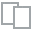
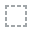
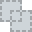
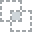
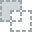
...
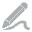
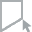
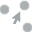
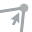
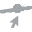

In [541]:
plot(df, 'Ram_Price_Ratio')

Visualized as the histogram below

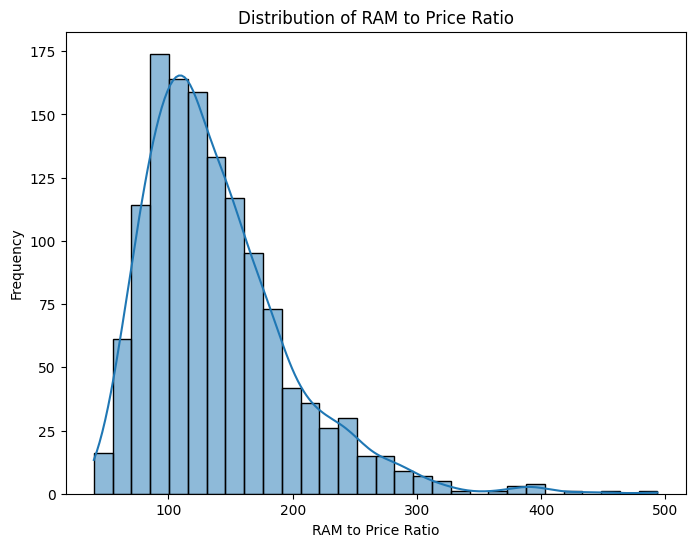

In [542]:
# Visualize the distribution of the new feature
plt.figure(figsize=(8, 6))
sns.histplot(data=df, x='Ram_Price_Ratio', bins=30, kde=True)
plt.title('Distribution of RAM to Price Ratio')
plt.xlabel('RAM to Price Ratio')
plt.ylabel('Frequency')
plt.show()


## [2.9] Memory

In [543]:
print("number of unique values for 'Memory'")
print(len(df['Memory'].unique()))

number of unique values for 'Memory'
39


In [544]:
print("Value counts for 'Memory'")
print(df['Memory'].value_counts())

Value counts for 'Memory'
256GB SSD                        412
1TB HDD                          223
500GB HDD                        132
512GB SSD                        118
128GB SSD +  1TB HDD              94
128GB SSD                         76
256GB SSD +  1TB HDD              73
32GB Flash Storage                38
2TB HDD                           16
64GB Flash Storage                15
512GB SSD +  1TB HDD              14
1TB SSD                           14
256GB SSD +  2TB HDD              10
1.0TB Hybrid                       9
256GB Flash Storage                8
16GB Flash Storage                 7
32GB SSD                           6
180GB SSD                          5
128GB Flash Storage                4
512GB SSD +  2TB HDD               3
16GB SSD                           3
512GB Flash Storage                2
1TB SSD +  1TB HDD                 2
256GB SSD +  500GB HDD             2
128GB SSD +  2TB HDD               2
256GB SSD +  256GB SSD             2
512GB SSD + 

## [2.10] Gpu

In [545]:
print("number of unique values for 'Gpu'")
print(len(df['Gpu'].unique()))

number of unique values for 'Gpu'
110


In [546]:
print("Value counts for 'Gpu'")
print(df['Gpu'].value_counts())

Value counts for 'Gpu'
Intel HD Graphics 620      281
Intel HD Graphics 520      185
Intel UHD Graphics 620      68
Nvidia GeForce GTX 1050     66
Nvidia GeForce GTX 1060     48
                          ... 
AMD Radeon R5 520            1
AMD Radeon R7                1
Intel HD Graphics 540        1
AMD Radeon 540               1
ARM Mali T860 MP4            1
Name: Gpu, Length: 110, dtype: int64


## [2.11] OpSys

In [547]:
print("number of unique values for 'OpSys'")
print(len(df['OpSys'].unique()))

number of unique values for 'OpSys'
9


In [548]:
print("value counts for 'OpSys'")
print(df['OpSys'].value_counts())

value counts for 'OpSys'
Windows 10      1072
No OS             66
Linux             62
Windows 7         45
Chrome OS         27
macOS             13
Mac OS X           8
Windows 10 S       8
Android            2
Name: OpSys, dtype: int64


## [2.12] Weight

In [549]:
print("Number of unique value for 'Weight'")
print(len(df['Weight'].unique()))

Number of unique value for 'Weight'
179


In [550]:
print("Value counts for 'Weight'")
print(df['Weight'].value_counts())

Value counts for 'Weight'
2.2kg     121
2.1kg      58
2.4kg      44
2.3kg      41
2.5kg      38
         ... 
3.25kg      1
4.7kg       1
1.55kg      1
1.18kg      1
4.0kg       1
Name: Weight, Length: 179, dtype: int64


## [2.8]  Relationships between predictor variables

In [551]:
df['Weight'].unique()

array(['1.37kg', '1.34kg', '1.86kg', '1.83kg', '2.1kg', '2.04kg', '1.3kg',
       '1.6kg', '2.2kg', '0.92kg', '1.22kg', '0.98kg', '2.5kg', '1.62kg',
       '1.91kg', '2.3kg', '1.35kg', '1.88kg', '1.89kg', '1.65kg',
       '2.71kg', '1.2kg', '1.44kg', '2.8kg', '2kg', '2.65kg', '2.77kg',
       '3.2kg', '0.69kg', '1.49kg', '2.4kg', '2.13kg', '2.43kg', '1.7kg',
       '1.4kg', '1.8kg', '1.9kg', '3kg', '1.252kg', '2.7kg', '2.02kg',
       '1.63kg', '1.96kg', '1.21kg', '2.45kg', '1.25kg', '1.5kg',
       '2.62kg', '1.38kg', '1.58kg', '1.85kg', '1.23kg', '1.26kg',
       '2.16kg', '2.36kg', '2.05kg', '1.32kg', '1.75kg', '0.97kg',
       '2.9kg', '2.56kg', '1.48kg', '1.74kg', '1.1kg', '1.56kg', '2.03kg',
       '1.05kg', '4.4kg', '1.90kg', '1.29kg', '2.0kg', '1.95kg', '2.06kg',
       '1.12kg', '1.42kg', '3.49kg', '3.35kg', '2.23kg', '4.42kg',
       '2.69kg', '2.37kg', '4.7kg', '3.6kg', '2.08kg', '4.3kg', '1.68kg',
       '1.41kg', '4.14kg', '2.18kg', '2.24kg', '2.67kg', '2.14kg',
       '1.

In [552]:
df.columns

Index(['Company', 'Product', 'TypeName', 'Inches', 'ScreenResolution', 'Cpu',
       'Ram', 'Memory', 'Gpu', 'OpSys', 'Weight', 'Price_euros', 'Touchscreen',
       'IPS_display', 'ultrahd', 'Ram_Price_Ratio'],
      dtype='object')

Correlation heatmap

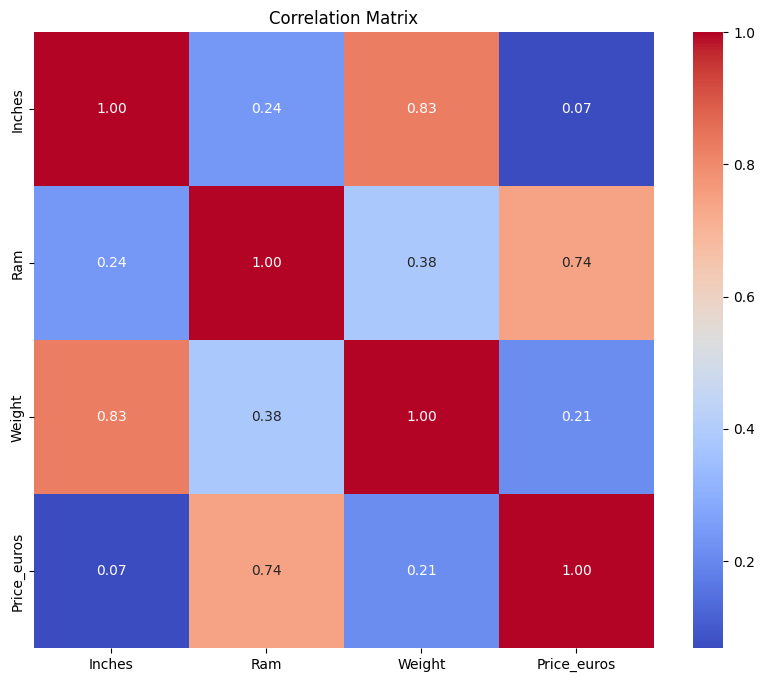

In [553]:
df['Weight'] = df['Weight'].replace('kg', '', regex=True).astype(float)

# Compute correlation matrix
correlation_matrix = df[['Inches', 'Ram', 'Weight', 'Price_euros']].corr()

# Visualize correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()


- Screen size (inches) has a moderate positive correlation of 0.83 with Weight. This suggests that larger screen sizes tend to be associated with heavier laptop weights.
- Ram has a moderate positive correlation of 0.74 with Price_euros, indicating that laptops with more RAM tend to be more expensive.
- Weight has a weak positive correlation of 0.21 with Price_euros, suggesting that heavier laptops are slightly more expensive on average.
- Screen size (inches) has a weak positive correlation of 0.24 with Ram and a very weak positive correlation of 0.07 with Price_euros.


In [554]:
correlation_matrix

,Inches,Ram,Weight,Price_euros
Inches,1.000000,0.237993,0.827631,0.068197
Ram,0.237993,1.000000,0.383874,0.743007
Weight,0.827631,0.383874,1.000000,0.210370
Price_euros,0.068197,0.743007,0.210370,1.000000


Paired Plots

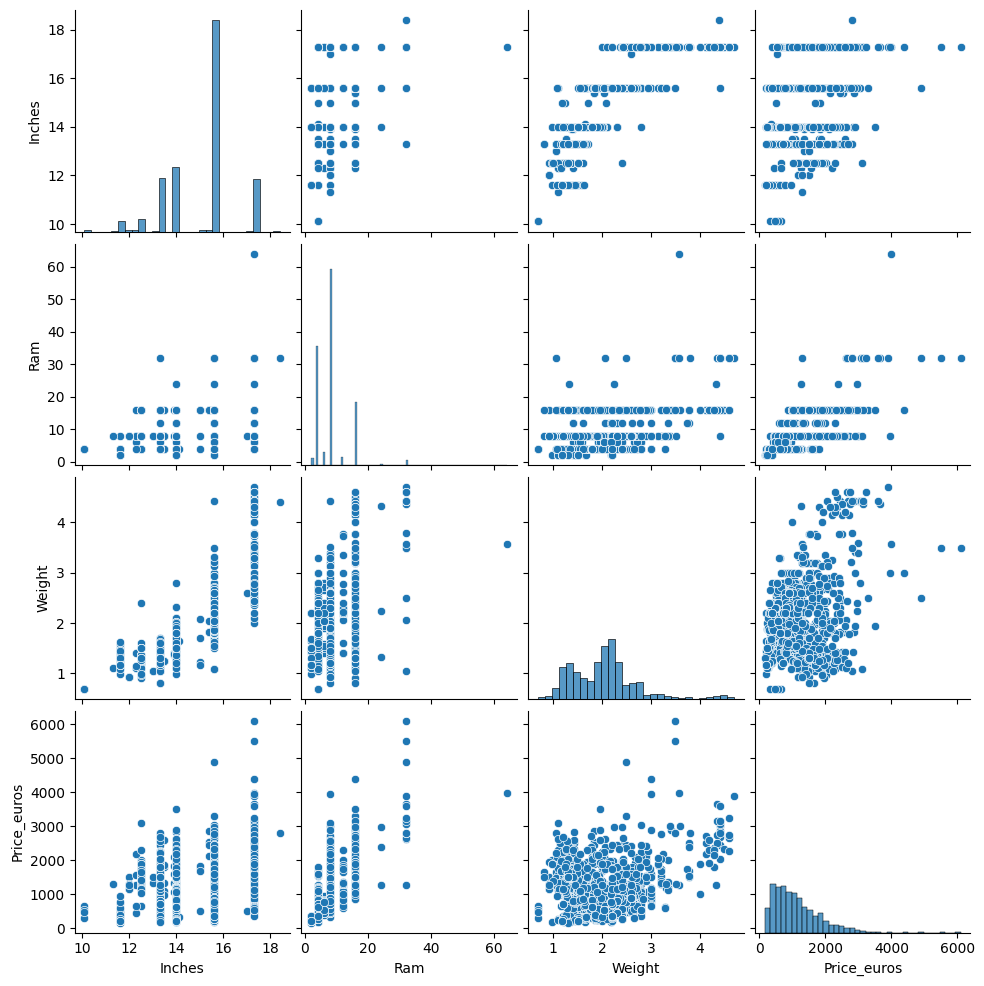

In [555]:
# Pair plot of numerical variables
sns.pairplot(df[['Inches', 'Ram', 'Weight', 'Price_euros']])
plt.show()

# **[3]** Preprocessing



In [556]:
df_cleaned = df.copy()

In [557]:
df_cleaned.columns

Index(['Company', 'Product', 'TypeName', 'Inches', 'ScreenResolution', 'Cpu',
       'Ram', 'Memory', 'Gpu', 'OpSys', 'Weight', 'Price_euros', 'Touchscreen',
       'IPS_display', 'ultrahd', 'Ram_Price_Ratio'],
      dtype='object')

## [3.1] Price: dropping extreme outliers, log transformation

In [558]:
extreme_price_outliers.index

Int64Index([196, 610, 749, 830], dtype='int64')

In [559]:
df_cleaned = df_cleaned.drop(extreme_price_outliers.index)

We saw in [2.2] above that the target variable was not normally distributed. Let's first check if removing the extreme outliers has changed that at all.


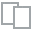
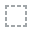
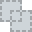
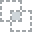
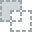
...
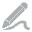
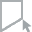
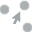
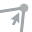
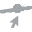

In [560]:
plot(df_cleaned, 'Price_euros')

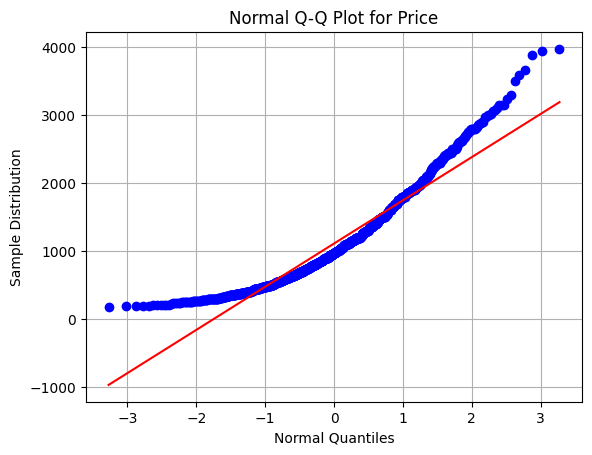

In [561]:
stats.probplot(df_cleaned['Price_euros'], dist="norm", plot=plt)
plt.xlabel('Normal Quantiles')
plt.ylabel('Sample Distribution')
plt.title('Normal Q-Q Plot for Price')
plt.grid(True)
plt.show()

We can see from the Q-Q plot that the distribution is non-normal. In case this ends up being an issue for our linear regression models, we'll create a new column that log-transforms the target variable.

In [562]:
df_cleaned['Log_Price_euros'] = np.log(df_cleaned['Price_euros'])

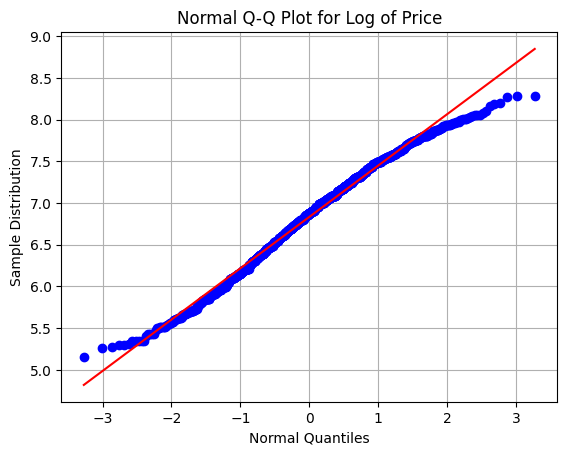

In [563]:
stats.probplot(df_cleaned['Log_Price_euros'], dist="norm", plot=plt)
plt.xlabel('Normal Quantiles')
plt.ylabel('Sample Distribution')
plt.title('Normal Q-Q Plot for Log of Price')
plt.grid(True)
plt.show()

We can see that log-transforming has improved the normality of the distribution, without eliminating all abnormality. Let's apply the normaltest to see if we can reject the Null Hypothesis that the distribution is normal at alpha < 0.05

In [564]:
statistic_log, p_value_log = stats.normaltest(df_cleaned['Log_Price_euros'])

print("P-value that data is normal: ", p_value_log)

alpha = 0.05
if p_value_log < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

P-value that data is normal:  7.677842639130011e-10
The data does not appear to be normally distributed: reject the Null Hypothesis


We can reject the Null Hypothesis that the data is normally distributed, but hopefully our log transformation has still improved the normality.

## **[3.2]** Product: dropping column

Dropping 'product' column (effectively an index: too many unique values)

In [565]:
df_cleaned = df_cleaned.drop('Product', axis=1)

## [3.3] Company and Typename: One-Hot Encoding

one-hot encoding company and typename

In [566]:
company = pd.get_dummies(data=df_cleaned['Company'], prefix="Company", dtype=int)
typename = pd.get_dummies(df_cleaned['TypeName'], prefix="TypeName", dtype=int)
df_cleaned = pd.concat([df_cleaned, company, typename], axis=1)
df_cleaned = df_cleaned.drop(['Company', 'TypeName'], axis=1)

In [567]:
len(company.columns)

19

In [568]:
len(typename.columns)

6

## [3.4] ScreenResolution: Simplify to int 'Pixels'

Resolution

In [569]:
# create a new column which extracts the resolution from the ScreenResolution column
resolution_pattern = r'(\d+x\d+)$'
res = df['ScreenResolution'].str.extract(resolution_pattern)[0]
df_cleaned[['res_width', 'res_height']] = res.str.split('x', expand=True).astype(int)

In [570]:
df_cleaned['Pixels'] = df_cleaned['res_width'] * df_cleaned['res_height']

In [571]:
df_cleaned['ScreenResolution'].unique()

array(['IPS Panel Retina Display 2560x1600', '1440x900',
       'Full HD 1920x1080', 'IPS Panel Retina Display 2880x1800',
       '1366x768', 'IPS Panel Full HD 1920x1080',
       'IPS Panel Retina Display 2304x1440',
       'IPS Panel Full HD / Touchscreen 1920x1080',
       'Full HD / Touchscreen 1920x1080',
       'Touchscreen / Quad HD+ 3200x1800',
       'IPS Panel Touchscreen 1920x1200', 'Touchscreen 2256x1504',
       'Quad HD+ / Touchscreen 3200x1800', 'IPS Panel 1366x768',
       'IPS Panel 4K Ultra HD / Touchscreen 3840x2160',
       'IPS Panel Full HD 2160x1440',
       '4K Ultra HD / Touchscreen 3840x2160', 'Touchscreen 2560x1440',
       '1600x900', 'IPS Panel 4K Ultra HD 3840x2160',
       '4K Ultra HD 3840x2160', 'Touchscreen 1366x768',
       'IPS Panel Full HD 1366x768', 'IPS Panel 2560x1440',
       'IPS Panel Full HD 2560x1440',
       'IPS Panel Retina Display 2736x1824', 'Touchscreen 2400x1600',
       '2560x1440', 'IPS Panel Quad HD+ 2560x1440',
       'IPS Panel 

We create a dummy variable for Touchscreen. The other text data tends to be captured well enough in the resolution numbers (e.g. 4K = 3840x2160; HD+ = 2560x1440 etc.)

In [572]:
df_cleaned['Touchscreen'] = df['ScreenResolution'].str.contains('Touchscreen').astype(int)
df_cleaned['Touchscreen']

0       0
1       0
2       0
3       0
4       0
       ..
1298    1
1299    1
1300    0
1301    0
1302    0
Name: Touchscreen, Length: 1299, dtype: int64

We can now drop ScreenResolution, res_height and res_width from the cleaned dataset.

In [573]:
df_cleaned.drop(['ScreenResolution', 'res_height', 'res_width'], axis=1, inplace=True)

## [3.5] GPU: Dummy Variable for Brand Maker

Note: despite our best efforts, we were unable to accomplish the same kind of detailed preprocessing with this column as we were with the CPU column (2.4. below). This was due to the much greater variation in GPU naming conventions.

GPU: extract brand

In [574]:
# extracting brand (GPU maker)

In [575]:
df_cleaned['Gpu_AMD'] = df_cleaned['Gpu'].str.startswith('AMD').astype(int)
df_cleaned['Gpu_AMD']

0       0
1       0
2       0
3       1
4       0
       ..
1298    0
1299    0
1300    0
1301    1
1302    0
Name: Gpu_AMD, Length: 1299, dtype: int64

In [576]:
df_cleaned['Gpu_Intel'] = df_cleaned['Gpu'].str.startswith('Intel').astype(int)
df_cleaned['Gpu_Intel']

0       1
1       1
2       1
3       0
4       1
       ..
1298    1
1299    1
1300    1
1301    0
1302    1
Name: Gpu_Intel, Length: 1299, dtype: int64

In [577]:
df_cleaned['Gpu_Nvidia'] = df_cleaned['Gpu'].str.startswith('Nvidia').astype(int)
df_cleaned['Gpu_Nvidia']

0       0
1       0
2       0
3       0
4       0
       ..
1298    0
1299    0
1300    0
1301    0
1302    0
Name: Gpu_Nvidia, Length: 1299, dtype: int64

In [578]:
df_cleaned = df_cleaned.drop('Gpu', axis=1)

## [3.6] CPU

We break down the CPU column into:
- dummy variables for CPU maker
- Dummies for Processor Family e.g. Core, Pentium etc.
- Model Number (since higher numbers tend to signify newer processors)

In [579]:
df['Cpu'].value_counts()

Intel Core i5 7200U 2.5GHz       190
Intel Core i7 7700HQ 2.8GHz      146
Intel Core i7 7500U 2.7GHz       134
Intel Core i7 8550U 1.8GHz        73
Intel Core i5 8250U 1.6GHz        72
                                ... 
Intel Core M M3-6Y30 0.9GHz        1
AMD A9-Series 9420 2.9GHz          1
Intel Core i3 6006U 2.2GHz         1
AMD A6-Series 7310 2GHz            1
Intel Xeon E3-1535M v6 3.1GHz      1
Name: Cpu, Length: 118, dtype: int64

### [3.6.1] Brand: Dummy Variables

In [580]:
# extract brand

df_cleaned['Cpu_Intel'] = df['Cpu'].str.startswith('Intel').astype(int)
df_cleaned['Cpu_Intel']

0       1
1       1
2       1
3       1
4       1
       ..
1298    1
1299    1
1300    1
1301    1
1302    1
Name: Cpu_Intel, Length: 1299, dtype: int64

In [581]:
unintel = df_cleaned.loc[df_cleaned['Cpu_Intel'] == 0]

In [582]:
df_cleaned['Cpu_AMD'] = df['Cpu'].str.startswith('AMD').astype(int)
df_cleaned['Cpu_AMD']

0       0
1       0
2       0
3       0
4       0
       ..
1298    0
1299    0
1300    0
1301    0
1302    0
Name: Cpu_AMD, Length: 1299, dtype: int64

In [583]:
df_cleaned['Cpu_Samsung'] = df['Cpu'].str.startswith('Samsung').astype(int)
df_cleaned['Cpu_Samsung']

0       0
1       0
2       0
3       0
4       0
       ..
1298    0
1299    0
1300    0
1301    0
1302    0
Name: Cpu_Samsung, Length: 1299, dtype: int64

In [584]:
df_cleaned.loc[df_cleaned['Cpu_Samsung'] == 1]

,Inches,Cpu,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,TypeName_Notebook,TypeName_Ultrabook,TypeName_Workstation,Pixels,Gpu_AMD,Gpu_Intel,Gpu_Nvidia,Cpu_Intel,Cpu_AMD,Cpu_Samsung
1191,12.3,Samsung Cortex A72&A53 2.0GHz,4,32GB Flash Storage,Chrome OS,1.15,659.0,1,1,0,...,0,0,0,3840000,0,0,0,0,0,1


Because there is only one Samsung CPU in the whole dataset, we don't need a separate column for this one laptop: it can be represented by 0s in the other two columns.

In [585]:
df_cleaned = df_cleaned.drop('Cpu_Samsung', axis=1)

Removing CPU Brand name (our approach is to progressively shrink down the Cpu column as we go)

In [586]:
df_cleaned['Cpu'] = df_cleaned['Cpu'].str.split(n=1).str[1]
df_cleaned['Cpu'].unique()

array(['Core i5 2.3GHz', 'Core i5 1.8GHz', 'Core i5 7200U 2.5GHz',
       'Core i7 2.7GHz', 'Core i5 3.1GHz', 'A9-Series 9420 3GHz',
       'Core i7 2.2GHz', 'Core i7 8550U 1.8GHz', 'Core i5 8250U 1.6GHz',
       'Core i3 6006U 2GHz', 'Core i7 2.8GHz', 'Core M m3 1.2GHz',
       'Core i7 7500U 2.7GHz', 'Core i7 2.9GHz', 'Core i3 7100U 2.4GHz',
       'Atom x5-Z8350 1.44GHz', 'Core i5 7300HQ 2.5GHz',
       'E-Series E2-9000e 1.5GHz', 'Core i5 1.6GHz',
       'Core i7 8650U 1.9GHz', 'Atom x5-Z8300 1.44GHz',
       'E-Series E2-6110 1.5GHz', 'A6-Series 9220 2.5GHz',
       'Celeron Dual Core N3350 1.1GHz', 'Core i3 7130U 2.7GHz',
       'Core i7 7700HQ 2.8GHz', 'Core i5 2.0GHz', 'Ryzen 1700 3GHz',
       'Pentium Quad Core N4200 1.1GHz', 'Atom x5-Z8550 1.44GHz',
       'Celeron Dual Core N3060 1.6GHz', 'Core i5 1.3GHz',
       'FX 9830P 3GHz', 'Core i7 7560U 2.4GHz', 'E-Series 6110 1.5GHz',
       'Core i5 6200U 2.3GHz', 'Core M 6Y75 1.2GHz',
       'Core i5 7500U 2.7GHz', 'Core i3 6006U

### [3.6.2] Cpu_frequency: extracting a float in GB

In [587]:
cs_pattern = r'(\s*\d+\.?\d*GHz\s*)'
df_cleaned['Cpu_frequency'] = df_cleaned['Cpu'].str.extract(cs_pattern)
df_cleaned['Cpu_frequency']

0        2.3GHz
1        1.8GHz
2        2.5GHz
3        2.7GHz
4        3.1GHz
         ...   
1298     2.5GHz
1299     2.5GHz
1300     1.6GHz
1301     2.5GHz
1302     1.6GHz
Name: Cpu_frequency, Length: 1299, dtype: object

In [588]:
df_cleaned['Cpu_frequency'] = df_cleaned['Cpu_frequency'].str.replace('GHz', '')
df_cleaned['Cpu_frequency'].unique()

array([' 2.3', ' 1.8', ' 2.5', ' 2.7', ' 3.1', ' 3', ' 2.2', ' 1.6', ' 2',
       ' 2.8', ' 1.2', ' 2.9', ' 2.4', ' 1.44', ' 1.5', ' 1.9', ' 1.1',
       ' 2.0', ' 1.3', ' 2.6', ' 3.6', ' 1.60', ' 3.2', ' 1.0', ' 2.1',
       ' 0.9', ' 1.92', ' 2.50', ' 2.70'], dtype=object)

In [589]:
df_cleaned['Cpu_frequency'] = df_cleaned['Cpu_frequency'].astype(float)
df_cleaned['Cpu_frequency'].info()

<class 'pandas.core.series.Series'>
Int64Index: 1299 entries, 0 to 1302
Series name: Cpu_frequency
Non-Null Count  Dtype  
--------------  -----  
1299 non-null   float64
dtypes: float64(1)
memory usage: 20.3 KB


Removing frequency from Cpu column for next preprocessing steps

In [590]:
df_cleaned['Cpu'] = df['Cpu'].str.split().str[:-1].str.join(' ')

In [591]:
df_cleaned['Cpu'].value_counts()

Intel Core i5 7200U     193
Intel Core i7 7700HQ    147
Intel Core i7 7500U     135
Intel Core i3 6006U      81
Intel Core i7 8550U      73
                       ... 
AMD Ryzen 1600            1
Intel Core M 7Y30         1
Intel Core i7 6920HQ      1
AMD E-Series E2-6110      1
Intel Core M M3-6Y30      1
Name: Cpu, Length: 91, dtype: int64

### [3.6.3] Model Number

#### [3.6.3.1] Extracting Model Number

In [592]:
# replace - with a space to disentangle series from mn
df_cleaned['Cpu'] = df_cleaned['Cpu'].str.replace('-', ' ')
df_cleaned['Cpu'].unique()

array(['Intel Core i5', 'Intel Core i5 7200U', 'Intel Core i7',
       'AMD A9 Series 9420', 'Intel Core i7 8550U', 'Intel Core i5 8250U',
       'Intel Core i3 6006U', 'Intel Core M m3', 'Intel Core i7 7500U',
       'Intel Core i3 7100U', 'Intel Atom x5 Z8350',
       'Intel Core i5 7300HQ', 'AMD E Series E2 9000e',
       'Intel Core i7 8650U', 'Intel Atom x5 Z8300',
       'AMD E Series E2 6110', 'AMD A6 Series 9220',
       'Intel Celeron Dual Core N3350', 'Intel Core i3 7130U',
       'Intel Core i7 7700HQ', 'AMD Ryzen 1700',
       'Intel Pentium Quad Core N4200', 'Intel Atom x5 Z8550',
       'Intel Celeron Dual Core N3060', 'AMD FX 9830P',
       'Intel Core i7 7560U', 'AMD E Series 6110', 'Intel Core i5 6200U',
       'Intel Core M 6Y75', 'Intel Core i5 7500U', 'Intel Core i7 6920HQ',
       'Intel Core i5 7Y54', 'Intel Xeon E3 1505M V6',
       'Intel Core i7 6500U', 'AMD E Series 9000e',
       'AMD A10 Series A10 9620P', 'Intel Core i7 7820HK',
       'AMD A6 Series A6 922

removing version numbers: there are too few of these to be worth adding a new column

In [593]:
# remove anomalies like "V6" (too few to be overly concerned about)
import re

def remove_vn(cpu_spec):
  pattern = r'\b[vV]\d{1}\b$'
  return re.sub(pattern, '', cpu_spec)

df_cleaned['Cpu'] = df_cleaned['Cpu'].apply(remove_vn)
df_cleaned['Cpu'].unique()

array(['Intel Core i5', 'Intel Core i5 7200U', 'Intel Core i7',
       'AMD A9 Series 9420', 'Intel Core i7 8550U', 'Intel Core i5 8250U',
       'Intel Core i3 6006U', 'Intel Core M m3', 'Intel Core i7 7500U',
       'Intel Core i3 7100U', 'Intel Atom x5 Z8350',
       'Intel Core i5 7300HQ', 'AMD E Series E2 9000e',
       'Intel Core i7 8650U', 'Intel Atom x5 Z8300',
       'AMD E Series E2 6110', 'AMD A6 Series 9220',
       'Intel Celeron Dual Core N3350', 'Intel Core i3 7130U',
       'Intel Core i7 7700HQ', 'AMD Ryzen 1700',
       'Intel Pentium Quad Core N4200', 'Intel Atom x5 Z8550',
       'Intel Celeron Dual Core N3060', 'AMD FX 9830P',
       'Intel Core i7 7560U', 'AMD E Series 6110', 'Intel Core i5 6200U',
       'Intel Core M 6Y75', 'Intel Core i5 7500U', 'Intel Core i7 6920HQ',
       'Intel Core i5 7Y54', 'Intel Xeon E3 1505M ',
       'Intel Core i7 6500U', 'AMD E Series 9000e',
       'AMD A10 Series A10 9620P', 'Intel Core i7 7820HK',
       'AMD A6 Series A6 9220'

In [594]:
df_cleaned['Cpu_original'] = df['Cpu']
Cpu_specs = ['Cpu_original', 'Cpu', 'Cpu_frequency', 'Cpu_model_no.']

In [595]:
# # Extracting model number from CPU column

# # Identify rows where there's definitely no model number because last word has less than 4 chars (minimum model number length)
no_mn = df_cleaned['Cpu'].str.split().str[-1].str.len() < 4

# # Set Model_Number to NA for rows without model number
# df_cleaned.loc[no_mn, 'Cpu_model_no.'] = pd.NA

# # For rows with model number, extract it as the last word in Cpu
# df_cleaned.loc[~no_mn, 'Cpu_model_no.'] = df_cleaned.loc[~no_mn, 'Cpu'].str.split().str[-1]

# # Remove model number component from Cpu column
# df_cleaned['Cpu'] = df_cleaned.apply(lambda row: ' '.join(row['Cpu'].split()[:-1]) if row['Cpu_model_no.'] is not pd.NA else row['Cpu'], axis=1)

# df_cleaned[Cpu_specs]

In [596]:
df_cleaned.loc[no_mn, 'Cpu_model_no.'] = pd.NA

In [597]:
df_cleaned[Cpu_specs][no_mn]

,Cpu_original,Cpu,Cpu_frequency,Cpu_model_no.
0,Intel Core i5 2.3GHz,Intel Core i5,2.3,NaN
1,Intel Core i5 1.8GHz,Intel Core i5,1.8,NaN
3,Intel Core i7 2.7GHz,Intel Core i7,2.7,NaN
4,Intel Core i5 3.1GHz,Intel Core i5,3.1,NaN
6,Intel Core i7 2.2GHz,Intel Core i7,2.2,NaN
7,Intel Core i5 1.8GHz,Intel Core i5,1.8,NaN
12,Intel Core i7 2.8GHz,Intel Core i7,2.8,NaN
14,Intel Core M m3 1.2GHz,Intel Core M m3,1.2,NaN
15,Intel Core i5 2.3GHz,Intel Core i5,2.3,NaN
17,Intel Core i7 2.9GHz,Intel Core i7,2.9,NaN


In [598]:
 # For rows with model number, extract it as the last word in Cpu
df_cleaned.loc[~no_mn, 'Cpu_model_no.'] = df_cleaned.loc[~no_mn, 'Cpu'].str.split().str[-1]
df_cleaned[Cpu_specs][~no_mn]

,Cpu_original,Cpu,Cpu_frequency,Cpu_model_no.
2,Intel Core i5 7200U 2.5GHz,Intel Core i5 7200U,2.5,7200U
5,AMD A9-Series 9420 3GHz,AMD A9 Series 9420,3.0,9420
8,Intel Core i7 8550U 1.8GHz,Intel Core i7 8550U,1.8,8550U
9,Intel Core i5 8250U 1.6GHz,Intel Core i5 8250U,1.6,8250U
10,Intel Core i5 7200U 2.5GHz,Intel Core i5 7200U,2.5,7200U
...,...,...,...,...
1298,Intel Core i7 6500U 2.5GHz,Intel Core i7 6500U,2.5,6500U
1299,Intel Core i7 6500U 2.5GHz,Intel Core i7 6500U,2.5,6500U
1300,Intel Celeron Dual Core N3050 1.6GHz,Intel Celeron Dual Core N3050,1.6,N3050
1301,Intel Core i7 6500U 2.5GHz,Intel Core i7 6500U,2.5,6500U


In [599]:
# # Remove model number component from Cpu column if row has a mn
df_cleaned['Cpu'] = df_cleaned.apply(lambda row: ' '.join(row['Cpu'].split()[:-1]) if row['Cpu_model_no.'] is not pd.NA and row['Cpu'].split()[-1] == row['Cpu_model_no.'] else row['Cpu'], axis=1)
df_cleaned[Cpu_specs]

,Cpu_original,Cpu,Cpu_frequency,Cpu_model_no.
0,Intel Core i5 2.3GHz,Intel Core i5,2.3,NaN
1,Intel Core i5 1.8GHz,Intel Core i5,1.8,NaN
2,Intel Core i5 7200U 2.5GHz,Intel Core i5,2.5,7200U
3,Intel Core i7 2.7GHz,Intel Core i7,2.7,NaN
4,Intel Core i5 3.1GHz,Intel Core i5,3.1,NaN
...,...,...,...,...
1298,Intel Core i7 6500U 2.5GHz,Intel Core i7,2.5,6500U
1299,Intel Core i7 6500U 2.5GHz,Intel Core i7,2.5,6500U
1300,Intel Celeron Dual Core N3050 1.6GHz,Intel Celeron Dual Core,1.6,N3050
1301,Intel Core i7 6500U 2.5GHz,Intel Core i7,2.5,6500U


#### [3.6.3.2] Extracting series letters and mapping to performance & efficiency scales

In [600]:
intel_mns = df_cleaned[(df_cleaned['Cpu_Intel'] == 1) & (~df_cleaned['Cpu_model_no.'].isna())]
intel_mns_uniq = intel_mns['Cpu_model_no.'].unique()
intel_mns_uniq

array(['7200U', '8550U', '8250U', '6006U', '7500U', '7100U', 'Z8350',
       '7300HQ', '8650U', 'Z8300', 'N3350', '7130U', '7700HQ', 'N4200',
       'Z8550', 'N3060', '7560U', '6200U', '6Y75', '6920HQ', '7Y54',
       '1505M', '6500U', '7820HK', '6600U', '3205U', '7820HQ', '7600U',
       '3855U', 'N3710', '7300U', 'N3450', '6440HQ', '6820HQ', '7Y75',
       '7440HQ', '7660U', '7Y30', '7Y57', '6700HQ', '6100U', '6820HK',
       'N3160', '6300U', 'N3050', '6Y30', '6300HQ', '6260U', '4405U',
       '6560U', '4405Y', 'N3700', '6Y54'], dtype=object)

In [601]:
AMD_mns = df_cleaned[(df_cleaned['Cpu_AMD'] == 1) & (~df_cleaned['Cpu_model_no.'].isna())]
AMD_mns_uniq = AMD_mns['Cpu_model_no.'].unique()
AMD_mns_uniq

array(['9420', '9000e', '6110', '9220', '1700', '9830P', '9620P', '9600P',
       '7410', '9720P', '1600', '7110', '9000', '7310', '9700P', '7210',
       '8800P', '9410'], dtype=object)

In [602]:
Samsung_mns = df_cleaned[(df_cleaned['Cpu_Intel'] == 0) & (df_cleaned['Cpu_AMD'] == 0) & (~df_cleaned['Cpu_model_no.'].isna())]
Samsung_mns_uniq = Samsung_mns['Cpu_model_no.'].unique()
Samsung_mns_uniq

array(['A72&A53'], dtype=object)

Samsung has only one CPU with anomalous naming convention

Intel has mn letters: U, Z, HQ, N, HK, M, Y

Model number letter meanings:
Intel:
- U = balance between performance and efficiency
- Y = efficient
- Z = low-power
- N = efficient
- HQ = high performance
- HK = performance-maximizing
- M = power-efficient, thermal-efficient

AMD:
- e = power-efficient
- P = performance-optimized


So we could add a CPU performance:efficiency column, where:
- U = 0 (balance)
- Y = -2 (very efficient)
- N = -1 (efficiency prioritizing)
- H = 1 (performance)

In [603]:
no_mns = df_cleaned['Cpu_model_no.'].isna()
no_mns

0        True
1        True
2       False
3        True
4        True
        ...  
1298    False
1299    False
1300    False
1301    False
1302    False
Name: Cpu_model_no., Length: 1299, dtype: bool

In [604]:
no_mns_rows = df_cleaned.loc[no_mns]
no_mns_rows[Cpu_specs]

,Cpu_original,Cpu,Cpu_frequency,Cpu_model_no.
0,Intel Core i5 2.3GHz,Intel Core i5,2.3,NaN
1,Intel Core i5 1.8GHz,Intel Core i5,1.8,NaN
3,Intel Core i7 2.7GHz,Intel Core i7,2.7,NaN
4,Intel Core i5 3.1GHz,Intel Core i5,3.1,NaN
6,Intel Core i7 2.2GHz,Intel Core i7,2.2,NaN
7,Intel Core i5 1.8GHz,Intel Core i5,1.8,NaN
12,Intel Core i7 2.8GHz,Intel Core i7,2.8,NaN
14,Intel Core M m3 1.2GHz,Intel Core M m3,1.2,NaN
15,Intel Core i5 2.3GHz,Intel Core i5,2.3,NaN
17,Intel Core i7 2.9GHz,Intel Core i7,2.9,NaN


dealing with model number variants by creating two scales: power and efficiency.

In [605]:
df_cleaned['MN_series'] = df_cleaned['Cpu_model_no.'].str.extract(r'([a-zA-Z]+)')
df_cleaned['MN_series'].unique()

array([nan, 'U', 'Z', 'HQ', 'e', 'N', 'P', 'Y', 'M', 'HK', 'A'],
      dtype=object)

In [606]:
# getting rid of anomaly 'A'
df_cleaned['MN_series'] = df_cleaned['MN_series'].replace('A', pd.NA)
df_cleaned['MN_series'] = df_cleaned['MN_series'].fillna('nan')
df_cleaned['MN_series'].unique()

array(['nan', 'U', 'Z', 'HQ', 'e', 'N', 'P', 'Y', 'M', 'HK'], dtype=object)

Performance Rankings:

1. HK
2. HQ, P
3. U
4. N
5. M
6. Y, e
7. Z

Efficiency Rankings:

1. Y, e
2. M
3. N
4. Z
5. U
6. HQ, P
7. HK




In [607]:
# mn series maps

performance_map = {
    'Z': 0,
    'Y': 1,
    'e': 1,
    'M': 2,
    'N': 3,
    'U': 4,
    'HQ': 5,
    'P': 5,
    'HK': 6
}

efficiency_map = {
    'HK': 0,
    'HQ': 1,
    'P': 1,
    'U': 2,
    'Z': 3,
    'N': 4,
    'M': 5,
    'Y': 6,
    'e': 6
}

df_cleaned['Cpu_performance'] = df_cleaned['MN_series'].map(performance_map)
df_cleaned['Cpu_efficiency'] = df_cleaned['MN_series'].map(efficiency_map)

print(df_cleaned['Cpu_performance'].unique())
print(df_cleaned['Cpu_efficiency'].unique())

[nan  4.  0.  5.  1.  3.  2.  6.]
[nan  2.  3.  1.  6.  4.  5.  0.]


In [608]:
mdn_perf = df_cleaned['Cpu_performance'].median()
print(mdn_perf)
mdn_eff = df_cleaned['Cpu_efficiency'].median()
print(mdn_eff)

4.0
2.0


The median performance rank is roughly 4 and the median efficiency is roughly 2. We will impute these two values to the missing values in these columns.

In [609]:
df_cleaned['Cpu_performance'].fillna(4, inplace=True)
df_cleaned['Cpu_efficiency'].fillna(2, inplace=True)

print(df_cleaned['Cpu_performance'].unique())
print(df_cleaned['Cpu_efficiency'].unique())

[4. 0. 5. 1. 3. 2. 6.]
[2. 3. 1. 6. 4. 5. 0.]


We can now remove the 'MN_series' column

In [610]:
df_cleaned = df_cleaned.drop('MN_series', axis=1)
df_cleaned.columns

Index(['Inches', 'Cpu', 'Ram', 'Memory', 'OpSys', 'Weight', 'Price_euros',
       'Touchscreen', 'IPS_display', 'ultrahd', 'Ram_Price_Ratio',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_original', 'Cpu_model_no.', 'Cpu_performance',
       'Cpu_efficiency'],
      dtype='object')

#### [3.6.3.3] Casting remaining number to an integer and imputing medians to NAs

Now we remove letters from the model number column

In [611]:
df_cleaned['Cpu_model_no.'].unique()

array([nan, '7200U', '9420', '8550U', '8250U', '6006U', '7500U', '7100U',
       'Z8350', '7300HQ', '9000e', '8650U', 'Z8300', '6110', '9220',
       'N3350', '7130U', '7700HQ', '1700', 'N4200', 'Z8550', 'N3060',
       '9830P', '7560U', '6200U', '6Y75', '6920HQ', '7Y54', '1505M',
       '6500U', '9620P', '7820HK', '6600U', '3205U', '7820HQ', '9600P',
       '7600U', '7410', '3855U', 'N3710', '9720P', '7300U', 'N3450',
       '6440HQ', '6820HQ', '1600', '7Y75', '7440HQ', '7660U', '7Y30',
       '7Y57', '6700HQ', '6100U', '7110', '6820HK', 'N3160', '6300U',
       '9000', 'N3050', '6Y30', '6300HQ', '7310', '6260U', '9700P',
       '4405U', '7210', '6560U', '8800P', '4405Y', 'N3700', '6Y54',
       'A72&A53', '9410'], dtype=object)

In [612]:
df_cleaned['Cpu_model_no.'].info()

<class 'pandas.core.series.Series'>
Int64Index: 1299 entries, 0 to 1302
Series name: Cpu_model_no.
Non-Null Count  Dtype 
--------------  ----- 
1278 non-null   object
dtypes: object(1)
memory usage: 20.3+ KB


In [613]:
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].str.replace(r'(\d)Y(\d)', r'\g<1>0\2').str.rstrip('Y')
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].str.replace('[a-zA-Z]', '', regex=True)
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].replace('44050', '4405')
df_cleaned['Cpu_model_no.'].unique()

array([nan, '7200', '9420', '8550', '8250', '6006', '7500', '7100',
       '8350', '7300', '9000', '8650', '8300', '6110', '9220', '3350',
       '7130', '7700', '1700', '4200', '3060', '9830', '7560', '6200',
       '6075', '6920', '7054', '1505', '6500', '9620', '7820', '6600',
       '3205', '9600', '7600', '7410', '3855', '3710', '9720', '3450',
       '6440', '6820', '1600', '7075', '7440', '7660', '7030', '7057',
       '6700', '6100', '7110', '3160', '6300', '3050', '6030', '7310',
       '6260', '9700', '4405', '7210', '6560', '8800', '3700', '6054',
       '72&53', '9410'], dtype=object)

we'll also remove the anomalous &

In [614]:
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].str.replace('&', '')
df_cleaned['Cpu_model_no.'].unique()

array([nan, '7200', '9420', '8550', '8250', '6006', '7500', '7100',
       '8350', '7300', '9000', '8650', '8300', '6110', '9220', '3350',
       '7130', '7700', '1700', '4200', '3060', '9830', '7560', '6200',
       '6075', '6920', '7054', '1505', '6500', '9620', '7820', '6600',
       '3205', '9600', '7600', '7410', '3855', '3710', '9720', '3450',
       '6440', '6820', '1600', '7075', '7440', '7660', '7030', '7057',
       '6700', '6100', '7110', '3160', '6300', '3050', '6030', '7310',
       '6260', '9700', '4405', '7210', '6560', '8800', '3700', '6054',
       '7253', '9410'], dtype=object)

Now we can cast model_number to an int

In [615]:
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].fillna('-1')
df_cleaned['Cpu_model_no.'] = df_cleaned['Cpu_model_no.'].astype(int)
df_cleaned['Cpu_model_no.'].info()

<class 'pandas.core.series.Series'>
Int64Index: 1299 entries, 0 to 1302
Series name: Cpu_model_no.
Non-Null Count  Dtype
--------------  -----
1299 non-null   int64
dtypes: int64(1)
memory usage: 20.3 KB


for missing model numbers, we can impute the median number for each CPU brand

In [616]:
intel_mns = df_cleaned[(df_cleaned['Cpu_Intel'] == 1) & (df_cleaned['Cpu_model_no.'] != -1)]
intel_mns_uniq = intel_mns['Cpu_model_no.'].unique()
intel_mdn_mn = intel_mns['Cpu_model_no.'].median()
intel_mdn_mn

7200.0

In [617]:
intel_no_mn = (df_cleaned['Cpu_Intel'] == 1) & (df_cleaned['Cpu_model_no.'] == -1)
df_cleaned.loc[intel_no_mn, 'Cpu_model_no.'] = intel_mdn_mn
df_cleaned

,Inches,Cpu,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,Gpu_AMD,Gpu_Intel,Gpu_Nvidia,Cpu_Intel,Cpu_AMD,Cpu_frequency,Cpu_original,Cpu_model_no.,Cpu_performance,Cpu_efficiency
0,13.3,Intel Core i5,8,128GB SSD,macOS,1.37,1339.69,0,1,0,...,0,1,0,1,0,2.3,Intel Core i5 2.3GHz,7200,4.0,2.0
1,13.3,Intel Core i5,8,128GB Flash Storage,macOS,1.34,898.94,0,0,0,...,0,1,0,1,0,1.8,Intel Core i5 1.8GHz,7200,4.0,2.0
2,15.6,Intel Core i5,8,256GB SSD,No OS,1.86,575.00,0,0,0,...,0,1,0,1,0,2.5,Intel Core i5 7200U 2.5GHz,7200,4.0,2.0
3,15.4,Intel Core i7,16,512GB SSD,macOS,1.83,2537.45,0,1,0,...,1,0,0,1,0,2.7,Intel Core i7 2.7GHz,7200,4.0,2.0
4,13.3,Intel Core i5,8,256GB SSD,macOS,1.37,1803.60,0,1,0,...,0,1,0,1,0,3.1,Intel Core i5 3.1GHz,7200,4.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1298,14.0,Intel Core i7,4,128GB SSD,Windows 10,1.80,638.00,1,1,0,...,0,1,0,1,0,2.5,Intel Core i7 6500U 2.5GHz,6500,4.0,2.0
1299,13.3,Intel Core i7,16,512GB SSD,Windows 10,1.30,1499.00,1,1,0,...,0,1,0,1,0,2.5,Intel Core i7 6500U 2.5GHz,6500,4.0,2.0
1300,14.0,Intel Celeron Dual Core,2,64GB Flash Storage,Windows 10,1.50,229.00,0,0,0,...,0,1,0,1,0,1.6,Intel Celeron Dual Core N3050 1.6GHz,3050,3.0,4.0
1301,15.6,Intel Core i7,6,1TB HDD,Windows 10,2.19,764.00,0,0,0,...,1,0,0,1,0,2.5,Intel Core i7 6500U 2.5GHz,6500,4.0,2.0


In [618]:
AMD_mns = df_cleaned[(df_cleaned['Cpu_AMD'] == 1) & (df_cleaned['Cpu_model_no.'] != -1)]
AMD_mdn_mn = AMD_mns['Cpu_model_no.'].median()

AMD_no_mn = (df_cleaned['Cpu_AMD'] == 1) & (df_cleaned['Cpu_model_no.'] == -1)
df_cleaned.loc[AMD_no_mn, 'Cpu_model_no.'] = AMD_mdn_mn
df_cleaned['Cpu_model_no.'].value_counts()

7200    214
7700    147
7500    136
6006     81
8550     77
       ... 
7310      1
6920      1
8300      1
6440      1
9700      1
Name: Cpu_model_no., Length: 65, dtype: int64

In [619]:
df_cleaned['Cpu_model_no.'].unique()

array([7200, 9420, 8550, 8250, 6006, 7500, 7100, 8350, 7300, 9000, 8650,
       8300, 6110, 9220, 3350, 7130, 7700, 1700, 4200, 3060, 9830, 7560,
       6200, 6075, 6920, 7054, 1505, 6500, 9620, 7820, 6600, 3205, 9600,
       7600, 7410, 3855, 3710, 9720, 3450, 6440, 6820, 1600, 7075, 7440,
       7660, 7030, 7057, 6700, 6100, 7110, 3160, 6300, 3050, 6030, 7310,
       6260, 9700, 4405, 7210, 6560, 8800, 3700, 6054, 7253, 9410])

In [620]:
df_cleaned.columns

Index(['Inches', 'Cpu', 'Ram', 'Memory', 'OpSys', 'Weight', 'Price_euros',
       'Touchscreen', 'IPS_display', 'ultrahd', 'Ram_Price_Ratio',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_original', 'Cpu_model_no.', 'Cpu_performance',
       'Cpu_efficiency'],
      dtype='object')

### [3.6.4]  Processor Family: Rankings

In [621]:
df_cleaned['Cpu'].unique()

array(['Intel Core i5', 'Intel Core i7', 'AMD A9 Series', 'Intel Core i3',
       'Intel Core M m3', 'Intel Atom x5', 'AMD E Series E2',
       'AMD A6 Series', 'Intel Celeron Dual Core', 'AMD Ryzen',
       'Intel Pentium Quad Core', 'AMD FX', 'AMD E Series',
       'Intel Core M', 'Intel Xeon E3', 'AMD A10 Series A10',
       'AMD A6 Series A6', 'AMD A10 Series', 'AMD A8 Series',
       'AMD A12 Series', 'Intel Celeron Quad Core', 'AMD A9 Series A9',
       'Intel Core M M3', 'Intel Atom', 'Intel Pentium Dual Core',
       'AMD A4 Series', 'Intel Core M m7', 'Intel Core M M7',
       'Intel Atom X5', 'Samsung Cortex'], dtype=object)

We are then left with:

- a processor family, like Core, Atom, Pentium Dual Core, FX etc.
- > These all conveniently come right at the start of the string
- > the exceptions are the "Series" CPUs.
- and a line in that family, like i3, i5, i7 etc.
- Instead of decomposing these two elements, our approach will be to simply build a ranking map by analyzing correlation with price (as a proxy for input costs)

Since processor family is now all that's left in the CPU column, we can simply rename this column to Cpu_family

In [622]:
df_cleaned.rename({'Cpu': 'Cpu_family'}, axis=1, inplace=True)

In [623]:
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'OpSys', 'Weight',
       'Price_euros', 'Touchscreen', 'IPS_display', 'ultrahd',
       'Ram_Price_Ratio', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_original', 'Cpu_model_no.', 'Cpu_performance',
       'Cpu_efficiency'],
      dtype='object')

In [624]:
intel = df_cleaned.loc[df_cleaned['Cpu_Intel'] == 1]

In [625]:
intel_pfs = intel['Cpu_family'].unique()

Core (unknown) -> Celeron Dual Core -> Celeron Quad Core -> Pentium Dual Core -> Pentium Quad Core -> Core i3 -> Core i5 -> Core i7 -> Xeon. M and Atom are harder to rank.

In [626]:
# iterate through intel_pfs
#   locate all rows in df_cleaned['Cpu_family'] containing this value
mean_price = df_cleaned['Price_euros'].mean()
median_price = df_cleaned['Price_euros'].median()

intel_processor_family = []
intel_means = []
intel_medians = []
# iterate through unique values of intel_pfs
for val in intel_pfs:
  # append unique value to list
  intel_processor_family.append(val)
  #
  var = intel.loc[intel['Cpu_family'] == val]
  mean = var['Price_euros'].mean()
  intel_means.append(mean)
  median = var['Price_euros'].median()
  intel_medians.append(median)

intel_price_by_pf = pd.DataFrame({'Processor Family': intel_processor_family, 'Mean Price': intel_means, 'Overall Mean': mean_price, 'Median Price': intel_medians, 'Overall Median': median_price})
by_mean = intel_price_by_pf.sort_values('Mean Price', ascending=False)
by_mean


,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median
8,Intel Xeon E3,2524.000000,1111.06863,2524.0,977.0
1,Intel Core i7,1579.766838,1111.06863,1468.0,977.0
7,Intel Core M,1413.000000,1111.06863,1289.5,977.0
13,Intel Core M m7,1299.000000,1111.06863,1299.0,977.0
14,Intel Core M M7,1159.000000,1111.06863,1159.0,977.0
3,Intel Core M m3,1125.700000,1111.06863,1125.7,977.0
0,Intel Core i5,1015.015248,1111.06863,955.0,977.0
10,Intel Core M M3,669.000000,1111.06863,669.0,977.0
12,Intel Pentium Dual Core,565.300000,1111.06863,581.9,977.0
2,Intel Core i3,541.625956,1111.06863,499.0,977.0


In [627]:
intel_pf_map = {
    'Celeron Dual Core': 0,
    'Atom': 1,
    'Celeron Quad Core': 2,
    'Pentium Quad Core': 3,
    'Core i3': 4,
    'Pentium Dual Core': 5,
    'Core i5': 6,
    'Core M': 7,
    'Core': 8,
    'Core i7': 9,
    'Xeon': 10
}

In [628]:
by_median = intel_price_by_pf.sort_values('Median Price', ascending=False)
by_median

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median
8,Intel Xeon E3,2524.000000,1111.06863,2524.0,977.0
1,Intel Core i7,1579.766838,1111.06863,1468.0,977.0
13,Intel Core M m7,1299.000000,1111.06863,1299.0,977.0
7,Intel Core M,1413.000000,1111.06863,1289.5,977.0
14,Intel Core M M7,1159.000000,1111.06863,1159.0,977.0
3,Intel Core M m3,1125.700000,1111.06863,1125.7,977.0
0,Intel Core i5,1015.015248,1111.06863,955.0,977.0
10,Intel Core M M3,669.000000,1111.06863,669.0,977.0
12,Intel Pentium Dual Core,565.300000,1111.06863,581.9,977.0
2,Intel Core i3,541.625956,1111.06863,499.0,977.0


In [629]:
mean_price = df_cleaned['Price_euros'].mean()
mean_price

1111.0686297151656

In [630]:
median_price = df_cleaned['Price_euros'].median()
median_price

977.0

In [631]:
AMD = df_cleaned.loc[df_cleaned['Cpu_AMD'] == 1]
AMD

,Inches,Cpu_family,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,Gpu_AMD,Gpu_Intel,Gpu_Nvidia,Cpu_Intel,Cpu_AMD,Cpu_frequency,Cpu_original,Cpu_model_no.,Cpu_performance,Cpu_efficiency
5,15.6,AMD A9 Series,4,500GB HDD,Windows 10,2.10,400.00,0,0,0,...,1,0,0,0,1,3.0,AMD A9-Series 9420 3GHz,9420,4.0,2.0
22,15.6,AMD E Series E2,4,500GB HDD,No OS,1.86,258.00,0,0,0,...,1,0,0,0,1,1.5,AMD E-Series E2-9000e 1.5GHz,9000,1.0,6.0
31,14.0,AMD E Series E2,2,32GB Flash Storage,Windows 10,1.65,199.00,0,0,0,...,1,0,0,0,1,1.5,AMD E-Series E2-6110 1.5GHz,6110,4.0,2.0
32,17.3,AMD A6 Series,4,500GB HDD,Windows 10,2.71,439.00,0,0,0,...,1,0,0,0,1,2.5,AMD A6-Series 9220 2.5GHz,9220,4.0,2.0
47,17.3,AMD Ryzen,8,256GB SSD + 1TB HDD,Windows 10,3.20,1299.00,0,0,0,...,1,0,0,0,1,3.0,AMD Ryzen 1700 3GHz,1700,4.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1240,15.6,AMD A12 Series,6,256GB SSD,Windows 10,2.20,597.57,0,0,0,...,1,0,0,0,1,3.6,AMD A12-Series 9720P 3.6GHz,9720,5.0,1.0
1251,15.6,AMD A6 Series,4,500GB HDD,Windows 10,1.86,399.00,0,0,0,...,1,0,0,0,1,2.5,AMD A6-Series 9220 2.5GHz,9220,4.0,2.0
1266,15.6,AMD A9 Series,6,1.0TB Hybrid,Windows 10,2.04,549.99,0,0,0,...,1,0,0,0,1,2.9,AMD A9-Series 9410 2.9GHz,9410,4.0,2.0
1280,15.6,AMD A9 Series,6,1.0TB Hybrid,Windows 10,2.04,549.99,0,0,0,...,1,0,0,0,1,2.9,AMD A9-Series 9410 2.9GHz,9410,4.0,2.0


In [632]:
AMD_pfs = AMD['Cpu_family'].unique()
AMD_pfs

array(['AMD A9 Series', 'AMD E Series E2', 'AMD A6 Series', 'AMD Ryzen',
       'AMD FX', 'AMD E Series', 'AMD A10 Series A10', 'AMD A6 Series A6',
       'AMD A10 Series', 'AMD A8 Series', 'AMD A12 Series',
       'AMD A9 Series A9', 'AMD A4 Series'], dtype=object)

In [633]:
# basic figures for AMD processors
AMD_processor_family = []
AMD_means = []
AMD_medians = []

for val in AMD_pfs:
  AMD_processor_family.append(val)
  var = AMD.loc[AMD['Cpu_family'] == val]
  mean = var['Price_euros'].mean()
  AMD_means.append(mean)
  median = var['Price_euros'].median()
  AMD_medians.append(median)

AMD_price_by_pf = pd.DataFrame({'Processor Family': AMD_processor_family, 'Mean Price': AMD_means, 'Overall Mean': mean_price, 'Median Price': AMD_medians, 'Overall Median': median_price})
AMD_pfs_by_mean = AMD_price_by_pf.sort_values('Mean Price', ascending=False)
AMD_pfs_by_mean

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median
3,AMD Ryzen,1685.500000,1111.06863,1622.000,977.0
4,AMD FX,849.000000,1111.06863,849.000,977.0
10,AMD A12 Series,655.071250,1111.06863,613.285,977.0
11,AMD A9 Series A9,649.500000,1111.06863,649.500,977.0
8,AMD A10 Series,575.502500,1111.06863,574.000,977.0
6,AMD A10 Series A10,571.950000,1111.06863,571.950,977.0
0,AMD A9 Series,466.657333,1111.06863,469.000,977.0
7,AMD A6 Series A6,462.395000,1111.06863,462.395,977.0
9,AMD A8 Series,448.500000,1111.06863,459.000,977.0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0


In [634]:
AMD_pfs_by_mdn = AMD_price_by_pf.sort_values('Median Price', ascending=False)
AMD_pfs_by_mdn

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median
3,AMD Ryzen,1685.500000,1111.06863,1622.000,977.0
4,AMD FX,849.000000,1111.06863,849.000,977.0
11,AMD A9 Series A9,649.500000,1111.06863,649.500,977.0
10,AMD A12 Series,655.071250,1111.06863,613.285,977.0
8,AMD A10 Series,575.502500,1111.06863,574.000,977.0
6,AMD A10 Series A10,571.950000,1111.06863,571.950,977.0
0,AMD A9 Series,466.657333,1111.06863,469.000,977.0
7,AMD A6 Series A6,462.395000,1111.06863,462.395,977.0
9,AMD A8 Series,448.500000,1111.06863,459.000,977.0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0


In [635]:
cortex = df_cleaned.loc[df_cleaned['Cpu_family'] == 'Cortex']
cortex['Price_euros']

Series([], Name: Price_euros, dtype: float64)

In [636]:
# altogther now

agg_pfs = pd.concat([AMD_price_by_pf, intel_price_by_pf])

cort = pd.DataFrame({'Processor Family': "Cortex", "Mean Price": cortex['Price_euros'], "Overall Mean": mean_price, "Median Price": cortex['Price_euros'], "Overall Median": median_price})

agg_pfs = pd.concat([agg_pfs, cort])

pfs_by_mean = agg_pfs.sort_values('Mean Price')

pfs_by_mean

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median
15,Intel Atom X5,203.400000,1111.06863,203.400,977.0
11,Intel Atom,265.000000,1111.06863,265.000,977.0
1,AMD E Series E2,288.750000,1111.06863,303.500,977.0
5,AMD E Series,310.598000,1111.06863,299.000,977.0
5,Intel Celeron Dual Core,312.236375,1111.06863,298.500,977.0
4,Intel Atom x5,342.206000,1111.06863,252.000,977.0
12,AMD A4 Series,379.000000,1111.06863,379.000,977.0
9,Intel Celeron Quad Core,390.250000,1111.06863,374.000,977.0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0
6,Intel Pentium Quad Core,421.122222,1111.06863,389.000,977.0


an easy way to assign a rank is to divide by 300 and round to nearest int. Or, add mean and median together, divide by 600, round to nearest int and subtract 1.

In [637]:
agg_pfs['rank'] = round(((agg_pfs['Mean Price'] + agg_pfs['Median Price']) / 600) - 1).astype(int)
agg_pfs

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median,rank
0,AMD A9 Series,466.657333,1111.06863,469.000,977.0,1
1,AMD E Series E2,288.750000,1111.06863,303.500,977.0,0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0,0
3,AMD Ryzen,1685.500000,1111.06863,1622.000,977.0,5
4,AMD FX,849.000000,1111.06863,849.000,977.0,2
5,AMD E Series,310.598000,1111.06863,299.000,977.0,0
6,AMD A10 Series A10,571.950000,1111.06863,571.950,977.0,1
7,AMD A6 Series A6,462.395000,1111.06863,462.395,977.0,1
8,AMD A10 Series,575.502500,1111.06863,574.000,977.0,1
9,AMD A8 Series,448.500000,1111.06863,459.000,977.0,1


In [638]:
agg_pfs.reset_index(drop=True, inplace=True)
agg_pfs

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median,rank
0,AMD A9 Series,466.657333,1111.06863,469.000,977.0,1
1,AMD E Series E2,288.750000,1111.06863,303.500,977.0,0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0,0
3,AMD Ryzen,1685.500000,1111.06863,1622.000,977.0,5
4,AMD FX,849.000000,1111.06863,849.000,977.0,2
5,AMD E Series,310.598000,1111.06863,299.000,977.0,0
6,AMD A10 Series A10,571.950000,1111.06863,571.950,977.0,1
7,AMD A6 Series A6,462.395000,1111.06863,462.395,977.0,1
8,AMD A10 Series,575.502500,1111.06863,574.000,977.0,1
9,AMD A8 Series,448.500000,1111.06863,459.000,977.0,1


We are scaling Xeon's rank down to 6, to ensure a continuous scale and for fear of overweighting this feature.

In [639]:
agg_pfs.iloc[21, agg_pfs.columns.get_loc('rank')] = 6
agg_pfs

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median,rank
0,AMD A9 Series,466.657333,1111.06863,469.000,977.0,1
1,AMD E Series E2,288.750000,1111.06863,303.500,977.0,0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0,0
3,AMD Ryzen,1685.500000,1111.06863,1622.000,977.0,5
4,AMD FX,849.000000,1111.06863,849.000,977.0,2
5,AMD E Series,310.598000,1111.06863,299.000,977.0,0
6,AMD A10 Series A10,571.950000,1111.06863,571.950,977.0,1
7,AMD A6 Series A6,462.395000,1111.06863,462.395,977.0,1
8,AMD A10 Series,575.502500,1111.06863,574.000,977.0,1
9,AMD A8 Series,448.500000,1111.06863,459.000,977.0,1


In [640]:
agg_pfs_by_rank = agg_pfs.sort_values('rank')
agg_pfs_by_rank

,Processor Family,Mean Price,Overall Mean,Median Price,Overall Median,rank
28,Intel Atom X5,203.400000,1111.06863,203.400,977.0,0
1,AMD E Series E2,288.750000,1111.06863,303.500,977.0,0
2,AMD A6 Series,392.054444,1111.06863,398.490,977.0,0
24,Intel Atom,265.000000,1111.06863,265.000,977.0,0
5,AMD E Series,310.598000,1111.06863,299.000,977.0,0
22,Intel Celeron Quad Core,390.250000,1111.06863,374.000,977.0,0
19,Intel Pentium Quad Core,421.122222,1111.06863,389.000,977.0,0
18,Intel Celeron Dual Core,312.236375,1111.06863,298.500,977.0,0
17,Intel Atom x5,342.206000,1111.06863,252.000,977.0,0
12,AMD A4 Series,379.000000,1111.06863,379.000,977.0,0


In [641]:
pfs_rank_map = dict(zip(agg_pfs['Processor Family'], agg_pfs['rank']))

df_cleaned['Cpu_family'] = df_cleaned['Cpu_family'].map(pfs_rank_map)

df_cleaned['Cpu_family'].unique()

df_cleaned.loc[df_cleaned['Cpu_family'].isna()]

,Inches,Cpu_family,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,Gpu_AMD,Gpu_Intel,Gpu_Nvidia,Cpu_Intel,Cpu_AMD,Cpu_frequency,Cpu_original,Cpu_model_no.,Cpu_performance,Cpu_efficiency
1191,12.3,NaN,4,32GB Flash Storage,Chrome OS,1.15,659.0,1,1,0,...,0,0,0,0,0,2.0,Samsung Cortex A72&A53 2.0GHz,7253,4.0,2.0


Dealing with anomaly: Cortex A72&A53

In [642]:
df.iloc[1191]

Company                                     Samsung
Product                             Chromebook Plus
TypeName                           2in1_Convertible
Inches                                         12.3
ScreenResolution    IPS Panel Touchscreen 2400x1600
Cpu                   Samsung Cortex A72&A53 2.0GHz
Ram                                               4
Memory                           32GB Flash Storage
Gpu                               ARM Mali T860 MP4
OpSys                                     Chrome OS
Weight                                         1.15
Price_euros                                   659.0
Touchscreen                                       1
IPS_display                                       1
ultrahd                                           0
Ram_Price_Ratio                              164.75
Name: 1191, dtype: object

In [643]:
cortex = df_cleaned.iloc[1191]
cortex_rank = round((cortex['Price_euros'] / 600) - 1)
print(cortex_rank)
df_cleaned.at[1191, 'Cpu_family'] = cortex_rank

1


In [644]:
df_cleaned['Cpu_family'].unique()
df_cleaned.loc[df_cleaned['Cpu_family'].isna()]

,Inches,Cpu_family,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,Gpu_AMD,Gpu_Intel,Gpu_Nvidia,Cpu_Intel,Cpu_AMD,Cpu_frequency,Cpu_original,Cpu_model_no.,Cpu_performance,Cpu_efficiency


In [645]:
df_cleaned['Cpu_family'] = df_cleaned['Cpu_family'].astype(int)

In [646]:
df_cleaned['Cpu_family']

0       2
1       2
2       2
3       4
4       2
       ..
1298    4
1299    4
1300    0
1301    4
1302    0
Name: Cpu_family, Length: 1299, dtype: int64

In [647]:
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'OpSys', 'Weight',
       'Price_euros', 'Touchscreen', 'IPS_display', 'ultrahd',
       'Ram_Price_Ratio', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_original', 'Cpu_model_no.', 'Cpu_performance',
       'Cpu_efficiency'],
      dtype='object')

Now that we're all done, we can drop 'Cpu_original'

In [648]:
df_cleaned = df_cleaned.drop('Cpu_original', axis=1)
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'OpSys', 'Weight',
       'Price_euros', 'Touchscreen', 'IPS_display', 'ultrahd',
       'Ram_Price_Ratio', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency'],
      dtype='object')

Finally we'll list these CPU specs together

In [649]:
Cpu_specs = ['Cpu_Intel', 'Cpu_AMD', 'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency', 'Cpu_family']

## [3.7] Memory

In [650]:
original_mem_vals = df['Memory'].value_counts()
original_mem_vals

256GB SSD                        412
1TB HDD                          223
500GB HDD                        132
512GB SSD                        118
128GB SSD +  1TB HDD              94
128GB SSD                         76
256GB SSD +  1TB HDD              73
32GB Flash Storage                38
2TB HDD                           16
64GB Flash Storage                15
512GB SSD +  1TB HDD              14
1TB SSD                           14
256GB SSD +  2TB HDD              10
1.0TB Hybrid                       9
256GB Flash Storage                8
16GB Flash Storage                 7
32GB SSD                           6
180GB SSD                          5
128GB Flash Storage                4
512GB SSD +  2TB HDD               3
16GB SSD                           3
512GB Flash Storage                2
1TB SSD +  1TB HDD                 2
256GB SSD +  500GB HDD             2
128GB SSD +  2TB HDD               2
256GB SSD +  256GB SSD             2
512GB SSD +  256GB SSD             1
5

### [3.7.1] Drive Type(s): Dummy Variables

creating binary columns for storage types (Hard Drive Disk, Solid State Drive, both together, Flash Memory or Hybrid memory). Laptops with multiple types of memory, for example with both an HDD and an SSD can simply be represented by a 1 in both columns.

In [651]:
memory_cols = []

In [652]:
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'OpSys', 'Weight',
       'Price_euros', 'Touchscreen', 'IPS_display', 'ultrahd',
       'Ram_Price_Ratio', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency'],
      dtype='object')

In [653]:
# Flash
df_cleaned['Memory_Flash'] = df_cleaned['Memory'].str.contains("Flash").astype(int)
memory_cols.append('Memory_Flash')

# Hybrid
df_cleaned['Memory_Hybrid'] = df_cleaned['Memory'].str.contains("Hybrid").astype(int)
memory_cols.append('Memory_Hybrid')

# HDD
df_cleaned['Memory_HDD'] = df_cleaned['Memory'].str.contains("HDD")
df_cleaned['Memory_HDD'].astype(int)
memory_cols.append('Memory_HDD')

In [654]:
# SSD
df_cleaned['Memory_SSD'] = df_cleaned['Memory'].str.contains("SSD")
df_cleaned['Memory_SSD'].astype(int)
memory_cols.append('Memory_SSD')

In [655]:
len(memory_cols)

4

### [3.7.2] Total GBs: extracting int

In [656]:
# remove any .0s

df_cleaned['Memory'] = df_cleaned['Memory'].str.replace(r"1.0TB", "1TB")
df_cleaned['Memory'].unique()

array(['128GB SSD', '128GB Flash Storage', '256GB SSD', '512GB SSD',
       '500GB HDD', '256GB Flash Storage', '1TB HDD',
       '32GB Flash Storage', '128GB SSD +  1TB HDD',
       '256GB SSD +  256GB SSD', '64GB Flash Storage',
       '256GB SSD +  1TB HDD', '256GB SSD +  2TB HDD', '32GB SSD',
       '2TB HDD', '64GB SSD', '1TB Hybrid', '512GB SSD +  1TB HDD',
       '1TB SSD', '256GB SSD +  500GB HDD', '128GB SSD +  2TB HDD',
       '512GB SSD +  512GB SSD', '16GB SSD', '16GB Flash Storage',
       '512GB SSD +  256GB SSD', '512GB SSD +  2TB HDD',
       '64GB Flash Storage +  1TB HDD', '180GB SSD', '1TB HDD +  1TB HDD',
       '32GB HDD', '1TB SSD +  1TB HDD', '512GB Flash Storage',
       '128GB HDD', '240GB SSD', '8GB SSD', '508GB Hybrid',
       '512GB SSD +  1TB Hybrid', '256GB SSD +  1TB Hybrid'], dtype=object)

In [657]:
# change TB to 000

df_cleaned['Memory'] = df_cleaned['Memory'].str.replace("TB", "000")
df_cleaned['Memory'].unique()

array(['128GB SSD', '128GB Flash Storage', '256GB SSD', '512GB SSD',
       '500GB HDD', '256GB Flash Storage', '1000 HDD',
       '32GB Flash Storage', '128GB SSD +  1000 HDD',
       '256GB SSD +  256GB SSD', '64GB Flash Storage',
       '256GB SSD +  1000 HDD', '256GB SSD +  2000 HDD', '32GB SSD',
       '2000 HDD', '64GB SSD', '1000 Hybrid', '512GB SSD +  1000 HDD',
       '1000 SSD', '256GB SSD +  500GB HDD', '128GB SSD +  2000 HDD',
       '512GB SSD +  512GB SSD', '16GB SSD', '16GB Flash Storage',
       '512GB SSD +  256GB SSD', '512GB SSD +  2000 HDD',
       '64GB Flash Storage +  1000 HDD', '180GB SSD',
       '1000 HDD +  1000 HDD', '32GB HDD', '1000 SSD +  1000 HDD',
       '512GB Flash Storage', '128GB HDD', '240GB SSD', '8GB SSD',
       '508GB Hybrid', '512GB SSD +  1000 Hybrid',
       '256GB SSD +  1000 Hybrid'], dtype=object)

In [658]:
# now we can remove all letters
import re

df_cleaned['Memory_GB'] = df_cleaned['Memory'].str.replace('[A-Za-z]', '', regex=True)

df_cleaned['Memory_GB'].unique()

array(['128 ', '128  ', '256 ', '512 ', '500 ', '256  ', '1000 ', '32  ',
       '128  +  1000 ', '256  +  256 ', '64  ', '256  +  1000 ',
       '256  +  2000 ', '32 ', '2000 ', '64 ', '512  +  1000 ',
       '256  +  500 ', '128  +  2000 ', '512  +  512 ', '16 ', '16  ',
       '512  +  256 ', '512  +  2000 ', '64   +  1000 ', '180 ',
       '1000  +  1000 ', '512  ', '240 ', '8 ', '508 '], dtype=object)

In [659]:
df_cleaned['Memory'].info()

<class 'pandas.core.series.Series'>
Int64Index: 1299 entries, 0 to 1302
Series name: Memory
Non-Null Count  Dtype 
--------------  ----- 
1299 non-null   object
dtypes: object(1)
memory usage: 52.6+ KB


In [660]:
df_cleaned['Memory']

0                 128GB SSD
1       128GB Flash Storage
2                 256GB SSD
3                 512GB SSD
4                 256GB SSD
               ...         
1298              128GB SSD
1299              512GB SSD
1300     64GB Flash Storage
1301               1000 HDD
1302              500GB HDD
Name: Memory, Length: 1299, dtype: object

In [661]:
# deal with additions

df_cleaned['Memory_GB'] = df_cleaned['Memory_GB'].str.replace('\s+\+\s+', ' ', regex=True)
# df_cleaned['Memory'].unique()
# df_cleaned['Memory'] = df_cleaned['Memory'].str.split('+')


# df_cleaned['Memory'] = df_cleaned['Memory'].apply(lambda x: sum(int(i.strip()) for i in x))

# df_cleaned['Memory'] = df_cleaned['Memory'].astype(int)

In [662]:
df_cleaned['Memory_GB'].unique()

array(['128 ', '128  ', '256 ', '512 ', '500 ', '256  ', '1000 ', '32  ',
       '128 1000 ', '256 256 ', '64  ', '256 1000 ', '256 2000 ', '32 ',
       '2000 ', '64 ', '512 1000 ', '256 500 ', '128 2000 ', '512 512 ',
       '16 ', '16  ', '512 256 ', '512 2000 ', '64 1000 ', '180 ',
       '1000 1000 ', '512  ', '240 ', '8 ', '508 '], dtype=object)

In [663]:
df_cleaned['Memory_GB'] = df_cleaned['Memory_GB'].str.split()

In [664]:
df_cleaned['Memory_GB'] = df_cleaned['Memory_GB'].apply(lambda x: sum(int(i.strip()) for i in x))

In [665]:
df_cleaned['Memory_GB'] = df_cleaned['Memory_GB'].astype(int)

In [666]:
df_cleaned['Memory_GB']

0        128
1        128
2        256
3        512
4        256
        ... 
1298     128
1299     512
1300      64
1301    1000
1302     500
Name: Memory_GB, Length: 1299, dtype: int64

In [667]:
df_cleaned['Memory_GB'].unique()

array([ 128,  256,  512,  500, 1000,   32, 1128,   64, 1256, 2256, 2000,
       1512,  756, 2128, 1024,   16,  768, 2512, 1064,  180,  240,    8,
        508])

In [668]:
df_cleaned['Memory_GB'].value_counts()

256     419
1000    245
500     132
512     121
1128     94
128      81
1256     74
32       45
2000     19
64       16
1512     15
2256     10
16       10
180       5
2512      3
756       2
2128      2
1024      1
768       1
1064      1
240       1
8         1
508       1
Name: Memory_GB, dtype: int64

## [3.8] OpSys

### [3.8.1] Dummy Variables for Software Company

In [669]:
df['OpSys'].unique()

array(['macOS', 'No OS', 'Windows 10', 'Mac OS X', 'Linux', 'Android',
       'Windows 10 S', 'Chrome OS', 'Windows 7'], dtype=object)

In [670]:
df_cleaned['Mac'] = df['OpSys'].str.startswith("mac|Mac")

In [671]:
# sort into brand buckets

# Windows

df_cleaned['Windows'] = df_cleaned['OpSys'].str.contains("Windows").astype(int)
df_cleaned['Windows']

0       0
1       0
2       0
3       0
4       0
       ..
1298    1
1299    1
1300    1
1301    1
1302    1
Name: Windows, Length: 1299, dtype: int64

In [672]:
# NB: a separate column for No OS is unnecessary: No OS can be represented by 0s for all the other columns here

# Linux
df_cleaned['Linux'] = df_cleaned['OpSys'].str.contains("Linux").astype(int)

# Google
df_cleaned['Google'] = df_cleaned['OpSys'].str.contains("Chrome OS|Android", regex=True).astype(int)
df_cleaned['Google']

0       0
1       0
2       0
3       0
4       0
       ..
1298    0
1299    0
1300    0
1301    0
1302    0
Name: Google, Length: 1299, dtype: int64

In [673]:
df_cleaned.loc[df_cleaned['Google'] == 1]

,Inches,Cpu_family,Ram,Memory,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,...,Cpu_efficiency,Memory_Flash,Memory_Hybrid,Memory_HDD,Memory_SSD,Memory_GB,Mac,Windows,Linux,Google
50,10.1,0,4,64GB Flash Storage,Android,0.69,319.0,1,1,0,...,3.0,1,0,False,False,64,False,0,0,1
290,15.6,0,2,16GB SSD,Chrome OS,2.19,199.0,0,0,0,...,2.0,0,0,False,True,16,False,0,0,1
317,13.3,0,4,16GB Flash Storage,Chrome OS,1.45,459.9,0,0,0,...,2.0,1,0,False,False,16,False,0,0,1
430,11.6,0,4,16GB Flash Storage,Chrome OS,1.15,269.0,0,0,0,...,4.0,1,0,False,False,16,False,0,0,1
437,12.3,4,16,512GB SSD,Chrome OS,1.10,2199.0,1,0,0,...,6.0,0,0,False,True,512,False,0,0,1
472,12.3,2,8,128GB SSD,Chrome OS,1.10,1275.0,1,0,0,...,6.0,0,0,False,True,128,False,0,0,1
504,11.6,0,4,16GB SSD,Chrome OS,1.25,265.0,0,0,0,...,4.0,0,0,False,True,16,False,0,0,1
584,11.6,0,4,16GB Flash Storage,Chrome OS,1.26,295.0,0,0,0,...,4.0,1,0,False,False,16,False,0,0,1
619,11.6,0,4,32GB Flash Storage,Chrome OS,1.25,379.0,1,1,0,...,4.0,1,0,False,False,32,False,0,0,1
677,11.6,0,8,64GB Flash Storage,Chrome OS,1.40,495.0,1,0,0,...,4.0,1,0,False,False,64,False,0,0,1


In [674]:
df_cleaned['OpSys'].unique()

array(['macOS', 'No OS', 'Windows 10', 'Mac OS X', 'Linux', 'Android',
       'Windows 10 S', 'Chrome OS', 'Windows 7'], dtype=object)

### [3.8.2] Ranking OS within same Company

In [675]:
# compare price relationship between android and chrome
chrome = df_cleaned.loc[df_cleaned['OpSys'].str.contains("Chrome OS")]
android = df_cleaned.loc[df_cleaned['OpSys'].str.contains("Android")]

mean_price_chrome = chrome['Price_euros'].mean()
mean_price_android = android['Price_euros'].mean()
print(mean_price_chrome)
print(mean_price_android)

553.5851851851852
434.0


Chrome has a slightly higher mean price than androids

In [676]:
# ranking OpSys where relevant:
  # 0: No OS
  # 1: windows 7, macOS, Chrome, Linux
  # 2: windows 10, mac OS X, Android
  # 3: Windows 10S

OpSys_map = {
    'No OS': 0,
    'Linux': 1,
    'Windows 7': 1,
    'macOS': 1,
    'Chrome OS': 1,
    'Windows 10': 2,
    'Mac OS X': 2,
    'Android': 2,
    'Windows 10 S': 3
}

In [677]:
df_cleaned['OS_rank'] = df_cleaned['OpSys'].map(OpSys_map)

df_cleaned['OS_rank']

0       1
1       1
2       0
3       1
4       1
       ..
1298    2
1299    2
1300    2
1301    2
1302    2
Name: OS_rank, Length: 1299, dtype: int64

In [678]:
# dropping OpSys column since relevant information is now  extracted

df_cleaned.drop('OpSys', axis=1, inplace=True)
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'Weight', 'Price_euros',
       'Touchscreen', 'IPS_display', 'ultrahd', 'Ram_Price_Ratio',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency',
       'Memory_Flash', 'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD',
       'Memory_GB', 'Mac', 'Windows', 'Linux', 'Google', 'OS_rank'],
      dtype='object')

## [3.9] Tidying

Tidying: dropping and renaming columns

In [679]:
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'Weight', 'Price_euros',
       'Touchscreen', 'IPS_display', 'ultrahd', 'Ram_Price_Ratio',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency',
       'Memory_Flash', 'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD',
       'Memory_GB', 'Mac', 'Windows', 'Linux', 'Google', 'OS_rank'],
      dtype='object')

renaming some columns to ensure consistent conventions and faciliate interpretation

In [680]:
df_cleaned.rename({'IPS_display': 'IPS_display',   'pixels': 'Pixels'}, axis=1, inplace=True)
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Memory', 'Weight', 'Price_euros',
       'Touchscreen', 'IPS_display', 'ultrahd', 'Ram_Price_Ratio',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency',
       'Memory_Flash', 'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD',
       'Memory_GB', 'Mac', 'Windows', 'Linux', 'Google', 'OS_rank'],
      dtype='object')

In [681]:
df_cleaned.drop(['ultrahd', 'Ram_Price_Ratio', 'Memory'], axis=1, inplace=True)
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Weight', 'Price_euros', 'Touchscreen',
       'IPS_display', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency',
       'Memory_Flash', 'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD',
       'Memory_GB', 'Mac', 'Windows', 'Linux', 'Google', 'OS_rank'],
      dtype='object')

In [682]:
df_cleaned['Memory_HDD'] = df_cleaned['Memory_HDD'].astype(int)
df_cleaned['Memory_SSD'] = df_cleaned['Memory_SSD'].astype(int)

In [683]:
df_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1299 entries, 0 to 1302
Data columns (total 53 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Inches                     1299 non-null   float64
 1   Cpu_family                 1299 non-null   int64  
 2   Ram                        1299 non-null   int64  
 3   Weight                     1299 non-null   float64
 4   Price_euros                1299 non-null   float64
 5   Touchscreen                1299 non-null   int64  
 6   IPS_display                1299 non-null   int64  
 7   Log_Price_euros            1299 non-null   float64
 8   Company_Acer               1299 non-null   int64  
 9   Company_Apple              1299 non-null   int64  
 10  Company_Asus               1299 non-null   int64  
 11  Company_Chuwi              1299 non-null   int64  
 12  Company_Dell               1299 non-null   int64  
 13  Company_Fujitsu            1299 non-null   int64

Saving preprocessed dataframe

In [684]:
df_cleaned.to_csv("Laptop_prices_preprocessed")

## [3.10] Further EDA with Preprocessed Data

Now that we've transformed many of our variables into numerical values, we have more potential numerical correlations to examine.

CPU Frequency

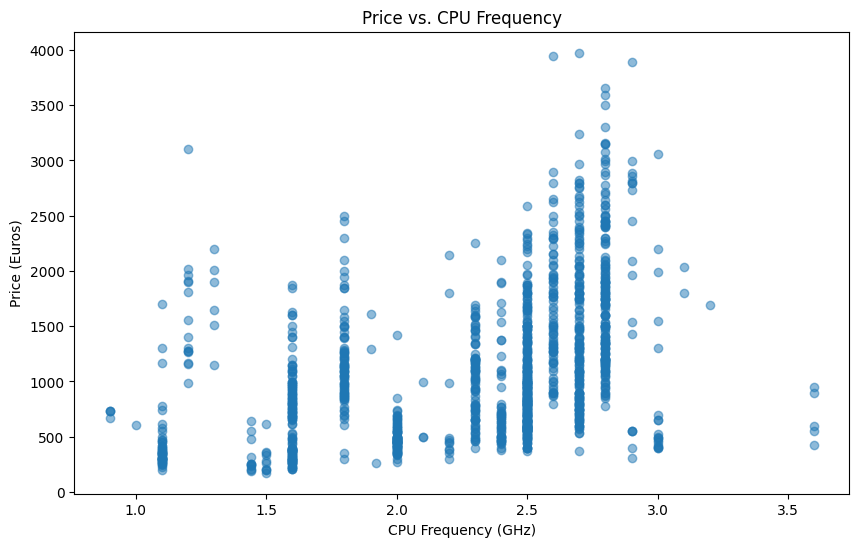

In [685]:
plt.figure(figsize=(10, 6))
plt.scatter(df_cleaned['Cpu_frequency'], df_cleaned['Price_euros'], alpha=0.5)
plt.title('Price vs. CPU Frequency')
plt.xlabel('CPU Frequency (GHz)')
plt.ylabel('Price (Euros)')
plt.show()

We can see there is likely some correlation between Price and CPU frequency, though the relationship is not highly regular. There are outliers on both ends, especially with 3.6GHz laptops selling for quite low prices.

Examining outliers: high CPU frequency and low price.

In [686]:
# examining the 3.6GHz laptops
MHz3600 = df_cleaned.loc[df_cleaned['Cpu_frequency'] == 3.6]
MHz3600_original_specs = df.loc[MHz3600.index]
MHz3600_original_specs

,Company,Product,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,Ram_Price_Ratio
341,Lenovo,IdeaPad 320-15ABR,Notebook,15.6,Full HD 1920x1080,AMD A12-Series 9720P 3.6GHz,12,2TB HDD,AMD Radeon 530,Windows 10,2.2,899.00,0,0,0,74.916667
591,Lenovo,IdeaPad 320-15ABR,Notebook,15.6,Full HD 1920x1080,AMD A12-Series 9720P 3.6GHz,12,512GB SSD,AMD Radeon 530,Windows 10,2.2,949.00,0,0,0,79.083333
702,Lenovo,IdeaPad 320-15ABR,Notebook,15.6,1366x768,AMD A12-Series 9720P 3.6GHz,8,1TB HDD,AMD Radeon R7,Windows 10,2.2,429.00,0,0,0,53.625000
982,Lenovo,IdeaPad 320-15ABR,Notebook,15.6,Full HD 1920x1080,AMD A12-Series 9720P 3.6GHz,6,256GB SSD,AMD Radeon 530,Windows 10,2.2,549.00,0,0,0,91.500000
1240,Lenovo,IdeaPad 320-15ABR,Notebook,15.6,Full HD 1920x1080,AMD A12-Series 9720P 3.6GHz,6,256GB SSD,AMD Radeon 530,Windows 10,2.2,597.57,0,0,0,99.595000


All these high-GHz low-price outliers are the same laptop: Lenovo's IdeaPad 320-15ABR Notebook, although with a range of memory storage options. The price might be explained by the average ScreenResolution and relatively low Ram. It's also possible that the product simply represents unusually good value for a powerful processor.

At the other end of the spectrum we have the anomalous laptop with less than

In [687]:
# outlier at the other end:
#   freq < 1.5 & price > 3000
anomaly = df_cleaned.loc[(df_cleaned['Cpu_frequency'] < 1.5) & (df_cleaned['Price_euros'] > 3000)]
anomaly

,Inches,Cpu_family,Ram,Weight,Price_euros,Touchscreen,IPS_display,Log_Price_euros,Company_Acer,Company_Apple,...,Memory_Flash,Memory_Hybrid,Memory_HDD,Memory_SSD,Memory_GB,Mac,Windows,Linux,Google,OS_rank
911,12.5,4,8,1.09,3100.0,1,0,8.039157,0,0,...,0,0,0,1,240,False,1,0,0,2


The price here might be explained by the 4K ScreenResolution, but otherwise it seems anomalous

Correlations for CPU specs

In [688]:
df_cleaned.columns

Index(['Inches', 'Cpu_family', 'Ram', 'Weight', 'Price_euros', 'Touchscreen',
       'IPS_display', 'Log_Price_euros', 'Company_Acer', 'Company_Apple',
       'Company_Asus', 'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu',
       'Company_Google', 'Company_HP', 'Company_Huawei', 'Company_LG',
       'Company_Lenovo', 'Company_MSI', 'Company_Mediacom',
       'Company_Microsoft', 'Company_Razer', 'Company_Samsung',
       'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Cpu_Intel', 'Cpu_AMD',
       'Cpu_frequency', 'Cpu_model_no.', 'Cpu_performance', 'Cpu_efficiency',
       'Memory_Flash', 'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD',
       'Memory_GB', 'Mac', 'Windows', 'Linux', 'Google', 'OS_rank'],
      dtype='object')

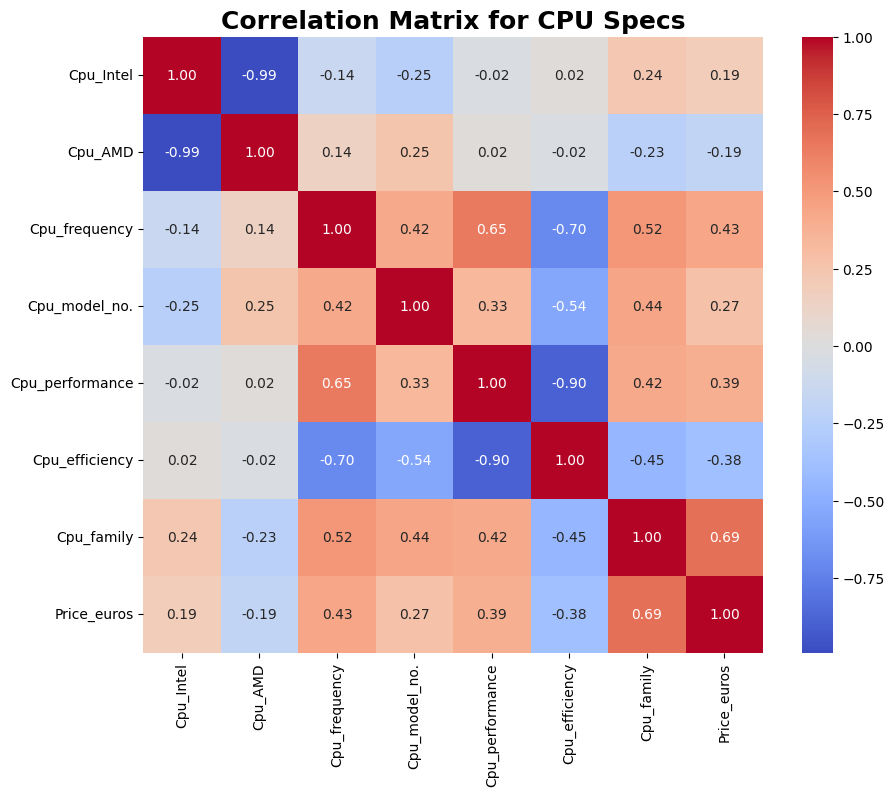

In [689]:
corr_cpu = df_cleaned[Cpu_specs + ['Price_euros']].corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_cpu, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix for CPU Specs',fontweight='bold',fontsize=18)
plt.show()

- **Cpu_frequency** has strong correlation with Cpu_performance and moderate correlation with Cpu_model_no. Even stronger anti-correlation with cpu_efficiency.
- Very strong anti-correlation between **performance** and **efficiency**, which is expected. Performance also correlates with model number, family and price.
- **Cpu_family** has strong negative and positive correlations with all other variables, suggesting this variable on its own might do a good job in capturing the variance in the others.

In section [3.10] below we will conduct Principal Components Analysis to reduce the collinearity of these variables.

Correlations for numerical variables

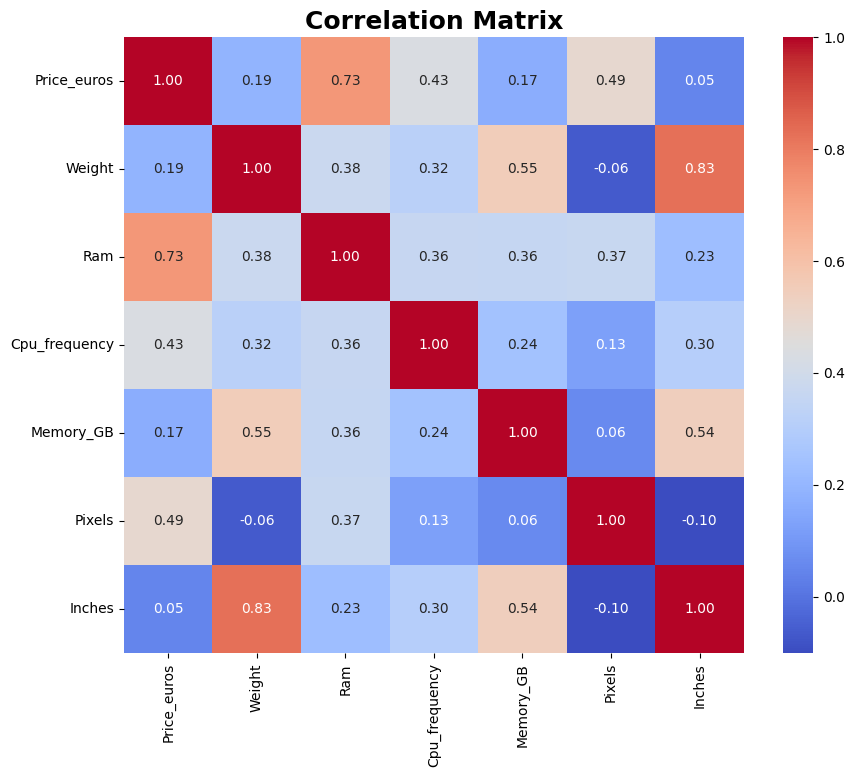

In [690]:
# Select numeric columns for correlation matrix
numeric_cols = ['Price_euros', 'Weight', 'Ram', 'Cpu_frequency', 'Memory_GB', 'Pixels', 'Inches']
corr_matrix = df_cleaned[numeric_cols].corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix',fontweight='bold',fontsize=18)
plt.show()

Aside from the correlations noted in [2.8] above, we can note here:

- strong positive correlation between total drive storage size (**Memory_GB**) and screen size (Inches). This makes sense: larger laptops have space for both larger screens and larger hard drives. Weight has a similar correlation, probably for the same reason. Weight has low positive correlation with Price at 0.21. It's possibile that Weight is simply a proxy for better predictors like Screen Size and Storage Size.
- strong positive correlation between price and screen resolution (**Pixels**). Pixels has low correlation, whether negative or positive, with the other variables. It's likely that these other variables have some relationship with the overall size of the laptop, while Pixels is independent of this. For these reasons we should consider engineering Pixels into our features.
- **Cpu_frequency** has moderately positive correlation with Price at 0.43. It has low-moderate positive correlation with the other variables. It's likely that the larger laptops have more room for faster CPUs and the fans needed to cool them (and vice versa), which would explain these correlations.


## [3.11] CPU: Principal Components Analysis

We first scale the CPU features with the MinMax Scaler since we don't have outliers or negative values in these columns

In [691]:
# Scaling CPU features
Cpu_X = df_cleaned[Cpu_specs + ['Price_euros']]

from sklearn.preprocessing import MinMaxScaler

Cpu_scaler = MinMaxScaler().set_output(transform="pandas")
Cpu_X_scaled = Cpu_scaler.fit_transform(Cpu_X)
Cpu_X_scaled

,Cpu_Intel,Cpu_AMD,Cpu_frequency,Cpu_model_no.,Cpu_performance,Cpu_efficiency,Cpu_family,Price_euros
0,1.0,0.0,0.518519,0.684084,0.666667,0.333333,0.333333,0.306680
1,1.0,0.0,0.333333,0.684084,0.666667,0.333333,0.333333,0.190723
2,1.0,0.0,0.592593,0.684084,0.666667,0.333333,0.333333,0.105499
3,1.0,0.0,0.666667,0.684084,0.666667,0.333333,0.666667,0.621797
4,1.0,0.0,0.814815,0.684084,0.666667,0.333333,0.333333,0.428729
...,...,...,...,...,...,...,...,...
1298,1.0,0.0,0.592593,0.600000,0.666667,0.333333,0.666667,0.122073
1299,1.0,0.0,0.592593,0.600000,0.666667,0.333333,0.666667,0.348592
1300,1.0,0.0,0.259259,0.185586,0.500000,0.666667,0.000000,0.014470
1301,1.0,0.0,0.592593,0.600000,0.666667,0.333333,0.666667,0.155222


In [692]:
from sklearn.decomposition import PCA

pca = PCA()
pca.fit(Cpu_X_scaled)

pc_list = [f"PC{i}" for i in list(range(1, pca.n_features_ + 1))]
pc_list

/usr/local/lib/python3.10/dist-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute `n_features_` was deprecated in version 1.2 and will be removed in 1.4. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8']

In [693]:
pc_data = {
    'Principal Component': pc_list,
    'Explained Variance (%)': (pca.explained_variance_ratio_ * 100).round(2),
}

In [694]:
pc_df = pd.DataFrame(pc_data)
pc_df['Cumulative Explained Variance (%)'] = pc_df['Explained Variance (%)'].cumsum()
pc_df

,Principal Component,Explained Variance (%),Cumulative Explained Variance (%)
0,PC1,41.55,41.55
1,PC2,33.95,75.50
2,PC3,9.95,85.45
3,PC4,6.48,91.93
4,PC5,4.17,96.10
5,PC6,3.25,99.35
6,PC7,0.52,99.87
7,PC8,0.13,100.00


In [695]:
import altair as alt

ev_chart = alt.Chart(pc_df).mark_line().transform_window(
    cum_var='sum(exp_variance)'
).encode(
    x=alt.X('Principal Component:N', sort=list(Cpu_X.columns)),
    y='Cumulative Explained Variance (%):Q'
).properties(width=600)

ev_chart

alt.Chart(...)

In [696]:
pc_loadings = dict(zip(pc_list, pca.components_))
loadings_df = pd.DataFrame(pc_loadings, index=Cpu_X.columns)
loadings_df.reset_index(names='feature_names', inplace=True)
loadings_df

,feature_names,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8
0,Cpu_Intel,-0.175423,-0.647212,-0.165896,-0.116984,0.020286,0.108485,-0.041903,-0.703705
1,Cpu_AMD,0.172929,0.642672,0.165423,0.117187,-0.014283,-0.101980,0.026712,-0.710390
2,Cpu_frequency,-0.390486,0.243342,-0.323221,0.303209,0.517727,0.564198,-0.074198,0.005649
3,Cpu_model_no.,-0.259424,0.255876,0.094489,-0.825155,-0.159283,0.325596,-0.214539,0.002612
4,Cpu_performance,-0.274276,0.121727,-0.432714,0.118786,-0.218300,-0.443403,-0.681412,0.004608
5,Cpu_efficiency,0.345513,-0.164876,0.504521,0.121182,0.236579,0.226138,-0.690664,0.009233
6,Cpu_family,-0.617796,-0.030960,0.529790,-0.017201,0.375318,-0.436960,0.067806,-0.000135
7,Price_euros,-0.378502,-0.021021,0.330535,0.413127,-0.679326,0.338851,0.007848,-0.000726


- PC1 is based mainly on efficiency and contains more AMD than Intel CPUs. PC1 is most likely grouping CPUs that focus on efficiency and price competitiveness.
- PC2 is mostly AMD CPUs and draws on model no., frequency and performance. It is basically neutral regarding price. PC2 is most likely grouping CPUs built for high performance at a reasonable or average price.
- PC3 is more evenly split between AMD and Intel but AMD predominates. It weights efficiency, family and price. This grouping is probably the higher-end version of PC1: highly efficient and highly priced CPUs.
- PC4 seems to be predominantly high-end laptops which balance performance and efficiency together at the higher end of the price range. These are likely high-end and flexible processors.
- PC5 are likely mid-range price-competitive CPUs which balance performance and efficiency, but lean toward performance. Intel predominates over AMD.
- PC6 CPUs are efficient, fast and expensive, with Intel predominating.
- PC7 seems to contain CPUs which are middling for all features and not very price-competitive. These are likely laptops whose price is not very dependent on the CPU.
- PC8 is negative for both Intel and AMD columns, so it is most likely the stand-alone Samsung CPU.

In summary we have:

- PC1: efficient, price-competitive
- PC2: high-performing, mid-market.
- PC3: high-end efficiency, expensive.
- PC4: high-end performance-efficiency balancing.
- PC5: mid-market performance-efficiency balancing.
- PC6: fast, efficient, expensive, predominantly Intel.

PC6 seems quite similar to PC3, only faster and leaning towards Intel. Along with the remaining two PCs, likely doesn't explain much variance. We have seen above that the first 5 PCs explain over 96% of the variance. Probably 5 would be a better number of Principal Components.

Now we'll try PCA with n_components=5

In [697]:
pca1 = PCA(n_components=5)
pca1.fit(Cpu_X_scaled)

PCs_1 = pca1.transform(Cpu_X_scaled)
pca1_df = pd.DataFrame(PCs_1, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5'])

pc1_data = {
    'pc': pca1_df.columns,
    'exp_variance': pca1.explained_variance_ratio_,
}

pc1_df = pd.DataFrame(pc1_data)
pc1_df['cum_exp_variance'] = pc1_df['exp_variance'].cumsum()
pc1_df

,pc,exp_variance,cum_exp_variance
0,PC1,0.415471,0.415471
1,PC2,0.339498,0.754969
2,PC3,0.099486,0.854455
3,PC4,0.064845,0.919300
4,PC5,0.041684,0.960984


In [698]:
pc1_loadings = dict(zip(pca1_df.columns, pca1.components_.round(4)))
loadings1_df = pd.DataFrame(pc1_loadings, index=Cpu_X.columns)
loadings1_df.reset_index(names='feature_names', inplace=True)
loadings1_df

,feature_names,PC1,PC2,PC3,PC4,PC5
0,Cpu_Intel,-0.1754,-0.6472,-0.1659,-0.1170,0.0203
1,Cpu_AMD,0.1729,0.6427,0.1654,0.1172,-0.0143
2,Cpu_frequency,-0.3905,0.2433,-0.3232,0.3032,0.5177
3,Cpu_model_no.,-0.2594,0.2559,0.0945,-0.8252,-0.1593
4,Cpu_performance,-0.2743,0.1217,-0.4327,0.1188,-0.2183
5,Cpu_efficiency,0.3455,-0.1649,0.5045,0.1212,0.2366
6,Cpu_family,-0.6178,-0.0310,0.5298,-0.0172,0.3753
7,Price_euros,-0.3785,-0.0210,0.3305,0.4131,-0.6793


concatenating principal components with df_cleaned, renaming columns and dropping original columns

In [699]:
pc_map = {
    'PC1': 'Cpu_efficient_low_end',
    'PC2': 'Cpu_AMD_mid_range',
    'PC3': 'Cpu_efficient_high_end',
    'PC4': 'Cpu_fast_high_end',
    'PC5': 'Cpu_fast_low_end'
}

In [700]:
Cpu_specs

['Cpu_Intel',
 'Cpu_AMD',
 'Cpu_frequency',
 'Cpu_model_no.',
 'Cpu_performance',
 'Cpu_efficiency',
 'Cpu_family']

In [701]:
df_cleaned = pd.concat([df_cleaned, pca1_df], axis=1)
df_cleaned = df_cleaned.rename(pc_map, axis=1)
df_cleaned = df_cleaned.drop(Cpu_specs, axis=1)
df_cleaned.columns

Index(['Inches', 'Ram', 'Weight', 'Price_euros', 'Touchscreen', 'IPS_display',
       'Log_Price_euros', 'Company_Acer', 'Company_Apple', 'Company_Asus',
       'Company_Chuwi', 'Company_Dell', 'Company_Fujitsu', 'Company_Google',
       'Company_HP', 'Company_Huawei', 'Company_LG', 'Company_Lenovo',
       'Company_MSI', 'Company_Mediacom', 'Company_Microsoft', 'Company_Razer',
       'Company_Samsung', 'Company_Toshiba', 'Company_Vero', 'Company_Xiaomi',
       'TypeName_2in1_Convertible', 'TypeName_Gaming', 'TypeName_Netbook',
       'TypeName_Notebook', 'TypeName_Ultrabook', 'TypeName_Workstation',
       'Pixels', 'Gpu_AMD', 'Gpu_Intel', 'Gpu_Nvidia', 'Memory_Flash',
       'Memory_Hybrid', 'Memory_HDD', 'Memory_SSD', 'Memory_GB', 'Mac',
       'Windows', 'Linux', 'Google', 'OS_rank', 'Cpu_efficient_low_end',
       'Cpu_AMD_mid_range', 'Cpu_efficient_high_end', 'Cpu_fast_high_end',
       'Cpu_fast_low_end'],
      dtype='object')

In [702]:
dtypes_df

dtypes_cleaned = df_cleaned.dtypes
dtypes_df_cleaned = pd.DataFrame({
    'Processed Column Names': dtypes_cleaned.index,
    'Processed Datatypes': dtypes_cleaned.values
})

dtypes_cleaned

Inches                       float64
Ram                          float64
Weight                       float64
Price_euros                  float64
Touchscreen                  float64
IPS_display                  float64
Log_Price_euros              float64
Company_Acer                 float64
Company_Apple                float64
Company_Asus                 float64
Company_Chuwi                float64
Company_Dell                 float64
Company_Fujitsu              float64
Company_Google               float64
Company_HP                   float64
Company_Huawei               float64
Company_LG                   float64
Company_Lenovo               float64
Company_MSI                  float64
Company_Mediacom             float64
Company_Microsoft            float64
Company_Razer                float64
Company_Samsung              float64
Company_Toshiba              float64
Company_Vero                 float64
Company_Xiaomi               float64
TypeName_2in1_Convertible    float64
T

# **[4]** Splitting data

In [703]:
df_cleaned = df_cleaned.dropna()

In [704]:
y = df_cleaned.pop('Price_euros')
X = df_cleaned

In [705]:
y_log = df_cleaned.pop('Log_Price_euros')

In [706]:
X

,Inches,Ram,Weight,Touchscreen,IPS_display,Company_Acer,Company_Apple,Company_Asus,Company_Chuwi,Company_Dell,...,Mac,Windows,Linux,Google,OS_rank,Cpu_efficient_low_end,Cpu_AMD_mid_range,Cpu_efficient_high_end,Cpu_fast_high_end,Cpu_fast_low_end
0,13.3,8.0,1.37,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,False,0.0,0.0,0.0,1.0,0.001098,-0.052151,-0.037274,-0.011870,-0.074217
1,13.3,8.0,1.34,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,False,0.0,0.0,0.0,1.0,0.117300,-0.094777,-0.015746,-0.115924,-0.091320
2,15.6,8.0,1.86,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,0.0,0.0,0.0,0.0,0.048321,-0.029897,-0.127714,-0.072523,0.100801
3,15.4,16.0,1.83,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,False,0.0,0.0,0.0,1.0,-0.381956,-0.033045,0.195596,0.157500,-0.086478
4,13.3,8.0,1.37,0.0,1.0,0.0,1.0,0.0,0.0,0.0,...,False,0.0,0.0,0.0,1.0,-0.160797,0.017385,-0.092701,0.128392,-0.003728
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1294,15.6,6.0,2.04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,1.0,0.0,0.0,2.0,-0.142071,-0.062081,0.046416,-0.002027,0.228041
1295,15.6,8.0,2.30,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,False,0.0,1.0,0.0,1.0,-0.227809,-0.066842,0.121289,0.091554,0.074160
1296,11.6,2.0,1.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,False,1.0,0.0,0.0,2.0,0.709076,-0.301578,-0.033468,0.226470,0.059603
1297,15.6,4.0,2.20,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,False,1.0,0.0,0.0,2.0,-0.154618,-0.062777,0.057373,0.011668,0.205522


In [707]:
from sklearn.model_selection import train_test_split

X_data, X_test, y_data, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
X_train, X_val, y_train, y_val = train_test_split(X_data, y_data, test_size=0.2, random_state=2)

y_data_log, y_test_log = train_test_split(y_log, test_size=0.2, random_state=2)

y_train_log, y_val_log = train_test_split(y_data_log, test_size=0.2, random_state=2)

# Make sure indices are the same for log and non-log y
target_indices = pd.DataFrame({
    'Non-Log': y_train + y_val + y_test,
    'Log': y_train_log + y_val_log + y_test_log
})

diffs = target_indices.diff(axis=1)
different = diffs.notna().any()
print(different)

# indices have remained aligned by holding parameters equal

Non-Log    False
Log        False
dtype: bool


# **[5]** Non-Parametric Models

Note: non-parametric models are positioned here first because the results of feature importances analysis on Random Forest is used later in non-parametric models to help with feature selection

## [5.1] Random Forest

### [5.1.1] Training and Validation

Functions and dicts for building models, assessing metrics and storing results

In [708]:
models = {}
train_preds = {}
val_preds = {}
RMSE_train_dict = {}
MAE_train_dict = {}
RMSE_val_dict = {}
MAE_val_dict = {}
R2_train_dict = {}
R2_val_dict = {}
Generalization_RMSE_gain = {}
Generalization_MAE_gain = {}

In [709]:
# Define a general function to automate this process: assumes existing dicts, train-val data-split, imported functions

def plant_forest(name, n_estimators=100, criterion='absolute_error', max_depth=None, min_samples_leaf=1, max_features=1.0):

  # instantiating model with specified hyperparameters
  model = RandomForestRegressor(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, min_samples_leaf=min_samples_leaf, max_features=max_features, random_state=2)

  # fitting model
  model.fit(X_train, y_train)

  #training results
  preds_train = model.predict(X_train).round(2)
  rmse_train = mean_squared_error(y_train, preds_train, squared=False).round(2)
  mae_train = mean_absolute_error(y_train, preds_train).round(2)
  r2_train = r2_score(y_train, preds_train).round(4)

  # validation results
  preds_val = model.predict(X_val).round(2)
  rmse_val = mean_squared_error(y_val, preds_val, squared=False).round(2)
  mae_val = mean_absolute_error(y_val, preds_val).round(2)
  r2_val = r2_score(y_val, preds_val).round(4)

  # Generalization error gain
  RMSE_generalization_gain = (rmse_val - rmse_train).round(2)
  MAE_generalization_gain = (mae_val - mae_train).round(2)

  # storing info in dicts
    # training
  models[name] = model
  train_preds[name] = preds_train
  RMSE_train_dict[name] = rmse_train
  MAE_train_dict[name] = mae_train
  R2_train_dict[name] = r2_train
    # validation
  val_preds[name] = preds_val
  RMSE_val_dict[name] = rmse_val
  MAE_val_dict[name] = mae_val
  R2_val_dict[name] = r2_val
    # Generalization error gain
  Generalization_RMSE_gain[name] = RMSE_generalization_gain
  Generalization_MAE_gain[name] = MAE_generalization_gain

  # printing results
  print(f"Training RMSE for {name}: ", rmse_train)
  print(f"Training MAE for {name}: ", mae_train)
  print(f"Training R2 for {name}: ", r2_train)
  print(" ")
  print(f"Validation RMSE for {name}: ", rmse_val)
  print(f"Validation MAE for {name}: ", mae_val)
  print(f"Validation R2 for {name}: ", r2_val)
  print(" ")
  print(f"RMSE Generalization gain for {name}: ", RMSE_generalization_gain)
  print(f"MAE Generalization gain for {name}: ", MAE_generalization_gain)

  return model

Baseline model which always predicts the average point (as a starting point for judging improvements)

In [710]:
y_train

1161    1769.00
320     1292.00
787      999.00
615     1168.00
923     1975.00
         ...   
130      638.99
1178    2153.37
1180    1637.00
752      579.00
708     1191.00
Name: Price_euros, Length: 828, dtype: float64

In [711]:
y_train_nulls = y_train.isna()
NAs = y_train
NAs = y_train.loc[y_train_nulls==True]
NAs

Series([], Name: Price_euros, dtype: float64)

In [712]:
df.loc[NAs.index]

,Company,Product,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,Ram_Price_Ratio


In [713]:
y_train_mean = y_train.mean()

y_base_train = np.full(y_train.shape, y_train_mean)
rmse_base_train = mean_squared_error(y_train, y_base_train, squared=False).round(2)
mae_base_train = mean_absolute_error(y_train, y_base_train).round(2)
r2_base_train = r2_score(y_train, y_base_train)

y_base_val = np.full(y_val.shape, y_train_mean)
rmse_base_val = mean_squared_error(y_val, y_base_val, squared=False).round(2)
mae_base_val = mean_absolute_error(y_val, y_base_val).round(2)
r2_base_val = r2_score(y_val, y_base_val)

generalization_rmse_base = (rmse_base_val - rmse_base_train).round(2)
generalization_mae_base = (mae_base_val - mae_base_train).round(2)

models["Baseline"] = y_base_train

train_preds["Baseline"] = y_base_train
RMSE_train_dict["Baseline"] = rmse_base_train
MAE_train_dict["Baseline"] = mae_base_train
R2_train_dict["Baseline"] = r2_base_train

val_preds["Baseline"] = y_base_val
RMSE_val_dict["Baseline"] = rmse_base_val
MAE_val_dict["Baseline"] = mae_base_val
R2_val_dict["Baseline"] = r2_base_val

Generalization_RMSE_gain["Baseline"] = generalization_rmse_base
Generalization_MAE_gain["Baseline"] = generalization_mae_base

print("Training RMSE for baseline model: ", rmse_base_train)
print("Training MAE for baseline model: ", mae_base_train)
print("Training R2 for baseline model: ", r2_base_train)
print(" ")
print("Validation RMSE for baseline model: ", rmse_base_val)
print("Validation MAE for baseline model: ", mae_base_val)
print("Validation R2 for baseline model: ", r2_base_val)
print(" ")
print("Generalization RMSE gain for baseline: ", generalization_rmse_base)
print("Generalization MAE gain for baseline: ", generalization_mae_base)

Training RMSE for baseline model:  653.32
Training MAE for baseline model:  518.96
Training R2 for baseline model:  0.0
 
Validation RMSE for baseline model:  643.47
Validation MAE for baseline model:  512.25
Validation R2 for baseline model:  -0.00011240941166312801
 
Generalization RMSE gain for baseline:  -9.85
Generalization MAE gain for baseline:  -6.71


Default params

In [714]:
rf_def = RandomForestRegressor(random_state=2)
rf_def.fit(X_train, y_train)

preds_rf_def_train = rf_def.predict(X_train)
rmse_rf_def_train = mean_squared_error(y_train, preds_rf_def_train, squared=False).round(2)
mae_rf_def_train = mean_absolute_error(y_train, preds_rf_def_train).round(2)
r2_rf_def_train = r2_score(y_train, preds_rf_def_train)

preds_rf_def_val = rf_def.predict(X_val).round(2)
rmse_rf_def_val = mean_squared_error(y_val, preds_rf_def_val, squared=False).round(2)
mae_rf_def_val = mean_absolute_error(y_val, preds_rf_def_val).round(2)
r2_rf_def_val = r2_score(y_val, preds_rf_def_val)

generalization_RMSE_gain = (rmse_rf_def_val - rmse_rf_def_train).round(2)
generalization_MAE_gain = (mae_rf_def_val - mae_rf_def_train).round(2)

models["RF Default"] = rf_def

train_preds["RF Default"] = preds_rf_def_train
RMSE_train_dict["RF Default"] = rmse_rf_def_train
MAE_train_dict["RF Default"] = mae_rf_def_train
R2_train_dict["RF Default"] = r2_rf_def_train

val_preds["RF Default"] = preds_rf_def_val
RMSE_val_dict["RF Default"] = rmse_rf_def_val
MAE_val_dict["RF Default"] = mae_rf_def_val
R2_val_dict["RF Default"] = r2_rf_def_val

Generalization_RMSE_gain["RF Default"] = generalization_RMSE_gain
Generalization_MAE_gain["RF Default"] = generalization_MAE_gain

print("Training RMSE for rf_def: ", rmse_rf_def_train)
print("Training MAE for rf_def: ", mae_rf_def_train)
print("Training R2 for rf_def", r2_rf_def_train)
print(" ")
print("Validation RMSE for rf_def: ", rmse_rf_def_val)
print("Validation MAE for rf_def: ", mae_rf_def_val)
print("Validation R2 for rf_def: ", r2_rf_def_val)
print(" ")
print("Generalization RMSE gain for rf_def: ", generalization_RMSE_gain)
print("Generalization MAE gain for rf_def: ", generalization_MAE_gain)

Training RMSE for rf_def:  112.75
Training MAE for rf_def:  76.98
Training R2 for rf_def 0.9702141454716073
 
Validation RMSE for rf_def:  306.19
Validation MAE for rf_def:  211.56
Validation R2 for rf_def:  0.7735540021838632
 
Generalization RMSE gain for rf_def:  193.44
Generalization MAE gain for rf_def:  134.58


Results: overfitting. Training error could be a little better: we might want to get RMSE below 100?

RF1 (n_estimators=50)

In [715]:
rf1 = plant_forest("rf1", n_estimators=50)

Training RMSE for rf1:  119.34
Training MAE for rf1:  81.57
Training R2 for rf1:  0.9666
 
Validation RMSE for rf1:  303.54
Validation MAE for rf1:  212.86
Validation R2 for rf1:  0.7775
 
RMSE Generalization gain for rf1:  184.2
MAE Generalization gain for rf1:  131.29


RF2 (n_estimators=200)

In [716]:
rf2 = plant_forest("rf2", n_estimators=200)

Training RMSE for rf2:  113.63
Training MAE for rf2:  77.94
Training R2 for rf2:  0.9697
 
Validation RMSE for rf2:  299.92
Validation MAE for rf2:  210.43
Validation R2 for rf2:  0.7827
 
RMSE Generalization gain for rf2:  186.29
MAE Generalization gain for rf2:  132.49


RF2 results:
- actually improves on training RMSE
- same training MAE
- gain in val RMSE and MAE

In [717]:
# average max depth for rf1

np.mean([estimator.tree_.max_depth for estimator in rf1.estimators_])

25.8

In [718]:
rf3 = plant_forest("rf3", n_estimators=50, max_depth=10)

Training RMSE for rf3:  167.91
Training MAE for rf3:  117.9
Training R2 for rf3:  0.9339
 
Validation RMSE for rf3:  305.05
Validation MAE for rf3:  213.72
Validation R2 for rf3:  0.7752
 
RMSE Generalization gain for rf3:  137.14
MAE Generalization gain for rf3:  95.82


RF3 results: gains error over RF2

In [719]:
rf4 = plant_forest("rf4", n_estimators=50, max_depth=20)

Training RMSE for rf4:  120.24
Training MAE for rf4:  82.2
Training R2 for rf4:  0.9661
 
Validation RMSE for rf4:  301.05
Validation MAE for rf4:  211.49
Validation R2 for rf4:  0.7811
 
RMSE Generalization gain for rf4:  180.81
MAE Generalization gain for rf4:  129.29


rf4 improves over rf3 on train but gains RMSE on val

In [720]:
rf5 = plant_forest("rf5", n_estimators=50, max_depth=15)

Training RMSE for rf5:  128.03
Training MAE for rf5:  88.45
Training R2 for rf5:  0.9616
 
Validation RMSE for rf5:  300.48
Validation MAE for rf5:  212.27
Validation R2 for rf5:  0.7819
 
RMSE Generalization gain for rf5:  172.45
MAE Generalization gain for rf5:  123.82


rf5 gains error over rf4 on train but improves on val

In [721]:
rf6 = plant_forest("rf6", n_estimators=50, max_depth=15, min_samples_leaf=2)

Training RMSE for rf6:  166.64
Training MAE for rf6:  111.51
Training R2 for rf6:  0.9349
 
Validation RMSE for rf6:  302.76
Validation MAE for rf6:  212.39
Validation R2 for rf6:  0.7786
 
RMSE Generalization gain for rf6:  136.12
MAE Generalization gain for rf6:  100.88


rf6 gains train and val error over rf5

In [722]:
rf7 = plant_forest("rf7", n_estimators=50, max_depth=15, min_samples_leaf=10)

Training RMSE for rf7:  293.83
Training MAE for rf7:  195.01
Training R2 for rf7:  0.7977
 
Validation RMSE for rf7:  340.89
Validation MAE for rf7:  239.47
Validation R2 for rf7:  0.7193
 
RMSE Generalization gain for rf7:  47.06
MAE Generalization gain for rf7:  44.46


rf7 gains training error over rf6 and also gains val error

In [723]:
rf8 = plant_forest("rf8", n_estimators=50, max_depth=15, min_samples_leaf=5)

Training RMSE for rf8:  242.27
Training MAE for rf8:  158.47
Training R2 for rf8:  0.8625
 
Validation RMSE for rf8:  312.45
Validation MAE for rf8:  220.34
Validation R2 for rf8:  0.7642
 
RMSE Generalization gain for rf8:  70.18
MAE Generalization gain for rf8:  61.87


rf8, with half samples_leaf of rf7, reduces training error and validation error

rf9, which limits max features, gains training error over previous models and also gains validation error.

In [724]:
rf9 = plant_forest("rf9", n_estimators=50, max_depth=15, min_samples_leaf=2, max_features=2)

Training RMSE for rf9:  334.66
Training MAE for rf9:  233.64
Training R2 for rf9:  0.7376
 
Validation RMSE for rf9:  388.35
Validation MAE for rf9:  275.46
Validation R2 for rf9:  0.6357
 
RMSE Generalization gain for rf9:  53.69
MAE Generalization gain for rf9:  41.82


rf10, which increases max features over rf9, reduces training error but gains validation error

In [725]:
rf10 = plant_forest("rf10", n_estimators=50, max_depth=15, min_samples_leaf=2, max_features=5)

Training RMSE for rf10:  241.99
Training MAE for rf10:  168.87
Training R2 for rf10:  0.8628
 
Validation RMSE for rf10:  333.87
Validation MAE for rf10:  233.84
Validation R2 for rf10:  0.7308
 
RMSE Generalization gain for rf10:  91.88
MAE Generalization gain for rf10:  64.97


rf11, which has no max_features, improves on both training and validation error

In [726]:
rf11 = plant_forest("rf11", n_estimators=50, max_depth=15, min_samples_leaf=2, max_features=None)

Training RMSE for rf11:  166.64
Training MAE for rf11:  111.51
Training R2 for rf11:  0.9349
 
Validation RMSE for rf11:  302.76
Validation MAE for rf11:  212.39
Validation R2 for rf11:  0.7786
 
RMSE Generalization gain for rf11:  136.12
MAE Generalization gain for rf11:  100.88


RF12: 25 estimators, otherwise default

In [727]:
rf12 = plant_forest("rf12", n_estimators=25)

Training RMSE for rf12:  122.47
Training MAE for rf12:  82.51
Training R2 for rf12:  0.9649
 
Validation RMSE for rf12:  313.44
Validation MAE for rf12:  216.52
Validation R2 for rf12:  0.7627
 
RMSE Generalization gain for rf12:  190.97
MAE Generalization gain for rf12:  134.01


rf12 performs slightly worse than estimators=50/200

In [728]:
rf13 = plant_forest("rf12", n_estimators=250)

Training RMSE for rf12:  113.27
Training MAE for rf12:  78.07
Training R2 for rf12:  0.9699
 
Validation RMSE for rf12:  301.55
Validation MAE for rf12:  211.69
Validation R2 for rf12:  0.7804
 
RMSE Generalization gain for rf12:  188.28
MAE Generalization gain for rf12:  133.62


rf13 (estimators=250) performs slightly worse than estimators=50/200 models

rf14 (n_estimators=150, max_depth=10, min_samples_leaf=1, max_features=3)

In [729]:
rf14 = plant_forest(name="rf14", n_estimators=150, max_depth=10, min_samples_leaf=1, max_features=3)

Training RMSE for rf14:  253.87
Training MAE for rf14:  179.85
Training R2 for rf14:  0.849
 
Validation RMSE for rf14:  349.53
Validation MAE for rf14:  243.58
Validation R2 for rf14:  0.7049
 
RMSE Generalization gain for rf14:  95.66
MAE Generalization gain for rf14:  63.73


rf15 (n_estimators=200, max_depth=10, min_samples_leaf=1, max_features=6)

In [730]:
rf15 = plant_forest("rf15", n_estimators=200, max_depth=10, min_samples_leaf=1, max_features=6)

Training RMSE for rf15:  212.15
Training MAE for rf15:  149.87
Training R2 for rf15:  0.8946
 
Validation RMSE for rf15:  327.87
Validation MAE for rf15:  222.86
Validation R2 for rf15:  0.7403
 
RMSE Generalization gain for rf15:  115.72
MAE Generalization gain for rf15:  72.99


RF16 (reducing n_estimators back down to 50)

In [731]:
rf16 = plant_forest("rf16", n_estimators=50, max_depth=10, min_samples_leaf=1, max_features=6)

Training RMSE for rf16:  215.68
Training MAE for rf16:  152.89
Training R2 for rf16:  0.891
 
Validation RMSE for rf16:  329.58
Validation MAE for rf16:  224.22
Validation R2 for rf16:  0.7376
 
RMSE Generalization gain for rf16:  113.9
MAE Generalization gain for rf16:  71.33


rf17 (default estimators and max_features=10)

In [732]:
rf17 = plant_forest("rf17", max_depth=10, max_features=10)

Training RMSE for rf17:  195.15
Training MAE for rf17:  135.79
Training R2 for rf17:  0.9108
 
Validation RMSE for rf17:  324.85
Validation MAE for rf17:  226.16
Validation R2 for rf17:  0.7451
 
RMSE Generalization gain for rf17:  129.7
MAE Generalization gain for rf17:  90.37


likely range for ideal hyperparameters:
- 50 <= n_estimators <= 200
- None <= max_depth <= 15
- 1 <= min_samples_leaf <= 5
- 2 <= max_features <= sqrt

Trying RandomSearch

In [733]:
from scipy.stats import randint

In [734]:
rf_params = rf1.get_params
rf_params

<bound method BaseEstimator.get_params of RandomForestRegressor(criterion='absolute_error', n_estimators=50,
                      random_state=2)>

In [735]:
len(X.columns)

49

In [736]:
rf1_depth = np.mean([estimator.tree_.max_depth for estimator in rf1.estimators_])
rf1_depth

25.8

In [737]:
rf2_depth = np.mean([estimator.tree_.max_depth for estimator in rf2.estimators_])
rf2_depth

26.475

In [738]:
params_dist = {
    'n_estimators': randint(50, 200),
    'max_depth': randint(10, 25),
    'min_samples_leaf': randint(1, 5),
    'max_features': randint(2, 7),
}

In [739]:
from sklearn.model_selection import RandomizedSearchCV, KFold

In [740]:
kf_cv = KFold(n_splits=5)
rf = RandomForestRegressor(random_state=1917)
randomsearch_rf = RandomizedSearchCV(rf, params_dist, random_state=1917, cv=kf_cv, verbose=1)

In [741]:
#randomsearch_rf.fit(X_train, y_train)

In [742]:
#randomsearch_rf.best_params_

In [743]:
# print(randomsearch_rf.score(X_train, y_train))
# print(randomsearch_rf.score(X_val, y_val))

First findings for randomized hyperparameters

In [744]:
rf_rand = plant_forest("rf_rand", n_estimators=172, max_depth=11, min_samples_leaf=1, max_features=5)

Training RMSE for rf_rand:  204.38
Training MAE for rf_rand:  144.74
Training R2 for rf_rand:  0.9021
 
Validation RMSE for rf_rand:  324.28
Validation MAE for rf_rand:  224.33
Validation R2 for rf_rand:  0.746
 
RMSE Generalization gain for rf_rand:  119.9
MAE Generalization gain for rf_rand:  79.59


Second findings for randomized hyperparameters

In [745]:
rf_rand2 = plant_forest("rf_rand2", n_estimators=111, max_depth=24, min_samples_leaf=1, max_features=4)

Training RMSE for rf_rand2:  135.53
Training MAE for rf_rand2:  94.77
Training R2 for rf_rand2:  0.957
 
Validation RMSE for rf_rand2:  323.57
Validation MAE for rf_rand2:  221.73
Validation R2 for rf_rand2:  0.7471
 
RMSE Generalization gain for rf_rand2:  188.04
MAE Generalization gain for rf_rand2:  126.96


Trying GridSearch

In [746]:
params_grid = {
    'n_estimators': np.arange(50, 200, 25),
    'max_depth': np.arange(10, 25, 5),
    'min_samples_leaf': np.arange(1, 5, 1),
    'max_features': np.arange(2, 7, 1)
}

In [747]:
# from sklearn.model_selection import GridSearchCV
# rf = RandomForestRegressor(random_state=1917)
# gs_rf = GridSearchCV(rf, params_grid, cv=2, verbose=1)

In [748]:
#gs_rf.fit(X_train, y_train)

In [749]:
#gs_rf.best_params_

In [750]:
y_train

1161    1769.00
320     1292.00
787      999.00
615     1168.00
923     1975.00
         ...   
130      638.99
1178    2153.37
1180    1637.00
752      579.00
708     1191.00
Name: Price_euros, Length: 828, dtype: float64

In [751]:
rf_gs = plant_forest("rf_gs", n_estimators=125, max_depth=20, min_samples_leaf=1, max_features=5)

Training RMSE for rf_gs:  133.64
Training MAE for rf_gs:  93.4
Training R2 for rf_gs:  0.9582
 
Validation RMSE for rf_gs:  313.72
Validation MAE for rf_gs:  215.6
Validation R2 for rf_gs:  0.7623
 
RMSE Generalization gain for rf_gs:  180.08
MAE Generalization gain for rf_gs:  122.2


### [5.1.2] Results Comparison

Tabulating Results

In [752]:
params_list = []
for name, model in models.items():
  if isinstance(model, RandomForestRegressor):
    max_features = model.max_features
    if max_features is not None:
      max_features_rounded = int(np.round(max_features))
    else:
      max_features_rounded = "None"
    hyperparameters = {
        'Model': name,
        'Number of Estimators': model.n_estimators,
        'Average Depth of Trees': np.mean([estimator.tree_.max_depth for estimator in model.estimators_]).round().astype(int),
        'Min Samples per Leaf': model.min_samples_leaf,
        'Max Features': max_features_rounded
    }
    params_list.append(hyperparameters)
  elif isinstance(model, DecisionTreeRegressor):
    hyperparameters = {
        'Model': name,
        'Tree Depth': model.get_depth(),
        'Min Samples per Leaf': model.min_samples_leaf,
        'Max Features': model.max_features
    }
    params_list.append(hyperparameters)

hyperparameters_df = pd.DataFrame(params_list)

In [753]:
rf_eval = pd.DataFrame(
    {
        'Model': list(models.keys()),
        'Training RMSE': list(RMSE_train_dict.values()),
        'Training MAE': list(MAE_train_dict.values()),
        'Training R2': [round(value * 100, 3) for value in R2_train_dict.values()],
        'Validation RMSE': list(RMSE_val_dict.values()),
        'Validation MAE': list(MAE_val_dict.values()),
        'Validation R2': [round(value * 100, 3) for value in R2_val_dict.values()],
        'RMSE Generalization Gain': list(Generalization_RMSE_gain.values()),
        'MAE Generalization Gain': list(Generalization_MAE_gain.values())
        }
)

rf_eval.set_index('Model', inplace=True)

rf_eval['R2 Generalization Gain'] = rf_eval['Training R2'] - rf_eval['Validation R2']

In [754]:
rf_eval

,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
Model,,,,,,,,,
Baseline,653.32,518.96,0.000,643.47,512.25,-0.011,-9.85,-6.71,0.011
RF Default,112.75,76.98,97.021,306.19,211.56,77.355,193.44,134.58,19.666
rf1,119.34,81.57,96.660,303.54,212.86,77.750,184.20,131.29,18.910
rf2,113.63,77.94,96.970,299.92,210.43,78.270,186.29,132.49,18.700
rf3,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870
rf4,120.24,82.20,96.610,301.05,211.49,78.110,180.81,129.29,18.500
rf5,128.03,88.45,96.160,300.48,212.27,78.190,172.45,123.82,17.970
rf6,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
rf7,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840


In [755]:
rf_eval = pd.merge(hyperparameters_df, rf_eval, on='Model')

In [756]:
# sort by validation RMSE
rf_eval_RMSE = rf_eval.sort_values('Validation RMSE')
rf_eval_RMSE.reset_index(inplace=True, drop=True)
rf_eval_RMSE.reset_index(inplace=True, names='Rank')

tree3E is best performing Decision Tree on validation RMSE, with tree_grid in second

In [757]:
rf_eval_RMSE.to_csv("RFs_by_RMSE")

Sorting by MAE on validation

In [758]:
# sorted by validation MAE
rf_eval_MAE = rf_eval.sort_values('Validation MAE')
rf_eval_MAE.reset_index(inplace=True, drop=True)
rf_eval_MAE.reset_index(inplace=True, names='Rank')
rf_eval_MAE

,Rank,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
0,0,rf2,200,26,1,1,113.63,77.94,96.970,299.92,210.43,78.270,186.29,132.49,18.700
1,1,rf4,50,20,1,1,120.24,82.20,96.610,301.05,211.49,78.110,180.81,129.29,18.500
2,2,RF Default,100,23,1,1,112.75,76.98,97.021,306.19,211.56,77.355,193.44,134.58,19.666
3,3,rf12,250,27,1,1,113.27,78.07,96.990,301.55,211.69,78.040,188.28,133.62,18.950
4,4,rf5,50,15,1,1,128.03,88.45,96.160,300.48,212.27,78.190,172.45,123.82,17.970
5,5,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
6,6,rf11,50,15,2,None,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
7,7,rf1,50,26,1,1,119.34,81.57,96.660,303.54,212.86,77.750,184.20,131.29,18.910
8,8,rf3,50,10,1,1,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870
9,9,rf_gs,125,20,1,5,133.64,93.40,95.820,313.72,215.60,76.230,180.08,122.20,19.590


tree3E wins on val MAE, with 3c 2nd, 3b 3rd, grid 4th

In [759]:
rf_eval_MAE.to_csv("RFs_by_MAE")

Sorting models from lowest to highest RMSE Generalization Gain (models least-to-most overfitted to training data when measured by RMSE)

In [760]:
# sort by RMSE generalization
rf_eval_by_RMSE_generalization = rf_eval.sort_values('RMSE Generalization Gain')
rf_eval_by_RMSE_generalization.reset_index(inplace=True, drop=True)
rf_eval_by_RMSE_generalization.reset_index(inplace=True, names='Rank')
rf_eval_by_RMSE_generalization

,Rank,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
0,0,rf7,50,10,10,1,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840
1,1,rf9,50,14,2,2,334.66,233.64,73.760,388.35,275.46,63.570,53.69,41.82,10.190
2,2,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830
3,3,rf10,50,15,2,5,241.99,168.87,86.280,333.87,233.84,73.080,91.88,64.97,13.200
4,4,rf14,150,10,1,3,253.87,179.85,84.900,349.53,243.58,70.490,95.66,63.73,14.410
5,5,rf16,50,10,1,6,215.68,152.89,89.100,329.58,224.22,73.760,113.90,71.33,15.340
6,6,rf15,200,10,1,6,212.15,149.87,89.460,327.87,222.86,74.030,115.72,72.99,15.430
7,7,rf_rand,172,11,1,5,204.38,144.74,90.210,324.28,224.33,74.600,119.90,79.59,15.610
8,8,rf17,100,10,1,10,195.15,135.79,91.080,324.85,226.16,74.510,129.70,90.37,16.570
9,9,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630


RF7 has lowest generalization, actually improving its performance on the validation data. The runner up, RF9 might also be considered, because generalization is still very low but is positive (we might suspect a model with negative generalization to be too biased). RF7 also has lowest MAE Generalization; RF9 is again the runner-up.  

Sorting by

In [761]:
# sort by MAE generalization
rf_eval_by_MAE_generalization = rf_eval.sort_values('MAE Generalization Gain')
rf_eval_by_MAE_generalization.reset_index(inplace=True, drop=True)
rf_eval_by_MAE_generalization.reset_index(inplace=True, names='Rank')
rf_eval_by_MAE_generalization

,Rank,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
0,0,rf9,50,14,2,2,334.66,233.64,73.760,388.35,275.46,63.570,53.69,41.82,10.190
1,1,rf7,50,10,10,1,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840
2,2,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830
3,3,rf14,150,10,1,3,253.87,179.85,84.900,349.53,243.58,70.490,95.66,63.73,14.410
4,4,rf10,50,15,2,5,241.99,168.87,86.280,333.87,233.84,73.080,91.88,64.97,13.200
5,5,rf16,50,10,1,6,215.68,152.89,89.100,329.58,224.22,73.760,113.90,71.33,15.340
6,6,rf15,200,10,1,6,212.15,149.87,89.460,327.87,222.86,74.030,115.72,72.99,15.430
7,7,rf_rand,172,11,1,5,204.38,144.74,90.210,324.28,224.33,74.600,119.90,79.59,15.610
8,8,rf17,100,10,1,10,195.15,135.79,91.080,324.85,226.16,74.510,129.70,90.37,16.570
9,9,rf3,50,10,1,1,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870


rf_gs wins on validation R2, but RF17 also has equal R2 score.

In [762]:
# sort by R2 score on validation (highest to lowest)
rf_eval_by_R2_val = rf_eval.sort_values('Validation R2', ascending=False)
rf_eval_by_R2_val.reset_index(inplace=True, drop=True)
rf_eval_by_R2_val.reset_index(inplace=True, names='Rank')
rf_eval_by_R2_val

,Rank,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
0,0,rf2,200,26,1,1,113.63,77.94,96.970,299.92,210.43,78.270,186.29,132.49,18.700
1,1,rf5,50,15,1,1,128.03,88.45,96.160,300.48,212.27,78.190,172.45,123.82,17.970
2,2,rf4,50,20,1,1,120.24,82.20,96.610,301.05,211.49,78.110,180.81,129.29,18.500
3,3,rf12,250,27,1,1,113.27,78.07,96.990,301.55,211.69,78.040,188.28,133.62,18.950
4,4,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
5,5,rf11,50,15,2,None,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
6,6,rf1,50,26,1,1,119.34,81.57,96.660,303.54,212.86,77.750,184.20,131.29,18.910
7,7,rf3,50,10,1,1,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870
8,8,RF Default,100,23,1,1,112.75,76.98,97.021,306.19,211.56,77.355,193.44,134.58,19.666
9,9,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830


In [763]:
rf_eval_by_R2_val.to_csv("RFs_by_R2")

sort by R2 generalization lowest to highest (which models retain their fit best on unseen data?)

Excluding the baseline model, which we would naturally expect to have the lowest R2 gain (because R2 is so low), RF7 has the lowest R2 gain, meaning it keeps its fit to the data best when encountering new data.

In [764]:
rf_eval_by_R2_generalization = rf_eval.sort_values('R2 Generalization Gain')
rf_eval_by_R2_generalization.reset_index(inplace=True, drop=True)
rf_eval_by_R2_generalization.reset_index(inplace=True, names='Rank')
rf_eval_by_R2_generalization

,Rank,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain
0,0,rf7,50,10,10,1,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840
1,1,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830
2,2,rf9,50,14,2,2,334.66,233.64,73.760,388.35,275.46,63.570,53.69,41.82,10.190
3,3,rf10,50,15,2,5,241.99,168.87,86.280,333.87,233.84,73.080,91.88,64.97,13.200
4,4,rf14,150,10,1,3,253.87,179.85,84.900,349.53,243.58,70.490,95.66,63.73,14.410
5,5,rf16,50,10,1,6,215.68,152.89,89.100,329.58,224.22,73.760,113.90,71.33,15.340
6,6,rf15,200,10,1,6,212.15,149.87,89.460,327.87,222.86,74.030,115.72,72.99,15.430
7,7,rf_rand,172,11,1,5,204.38,144.74,90.210,324.28,224.33,74.600,119.90,79.59,15.610
8,8,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630
9,9,rf11,50,15,2,None,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630


In [765]:
# This cell creates an aggregate weighted rank based on all the performance measures above.
# lowest rank performs best and highest worst
# Rankings are weighted by relative importance:
#             RMSE val, MAE val, R2 val - triple
#             RMSE and MAE generalization - double
#             Training scores - unchanged

tables = [
    rf_eval_RMSE, rf_eval_MAE, rf_eval_by_R2_generalization, rf_eval_by_R2_val, rf_eval_by_RMSE_generalization, rf_eval_by_MAE_generalization, rf_eval_by_R2_generalization
    ]

agg_weighted_ranks = {}

for table in tables:
  if table is rf_eval_RMSE or table is rf_eval_MAE or table is rf_eval_by_R2_val:
    weight = 3
  elif table is rf_eval_by_RMSE_generalization or table is rf_eval_by_MAE_generalization:
    weight = 2
  else:
    weight = 1

  for index, row in table.iterrows():
    model = row['Model']
    rank = row['Rank']

    weighted_rank = rank * weight

    if model in agg_weighted_ranks:
      agg_weighted_ranks[model] += weighted_rank
    else:
      agg_weighted_ranks[model] = weighted_rank

agg_ranks = pd.Series(agg_weighted_ranks)

agg_ranks = agg_ranks.sort_values()

agg_ranks

rf5            92
rf6            93
rf2            94
rf8            94
rf4            99
rf11          108
rf3           126
rf12          131
rf1           149
rf7           155
rf_rand       156
rf15          156
rf16          159
rf10          164
RF Default    166
rf_gs         171
rf17          177
rf9           177
rf14          184
rf_rand2      199
dtype: int64

In [766]:
rf_eval = pd.merge(rf_eval, agg_ranks.rename('Aggregate Weighted Rank'), left_on='Model', right_index=True)

In [767]:
rf_eval_by_agg_rank = rf_eval.sort_values('Aggregate Weighted Rank')
rf_eval_by_agg_rank

,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain,Aggregate Weighted Rank
5,rf5,50,15,1,1,128.03,88.45,96.160,300.48,212.27,78.190,172.45,123.82,17.970,92
6,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630,93
2,rf2,200,26,1,1,113.63,77.94,96.970,299.92,210.43,78.270,186.29,132.49,18.700,94
8,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830,94
4,rf4,50,20,1,1,120.24,82.20,96.610,301.05,211.49,78.110,180.81,129.29,18.500,99
11,rf11,50,15,2,None,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630,108
3,rf3,50,10,1,1,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870,126
12,rf12,250,27,1,1,113.27,78.07,96.990,301.55,211.69,78.040,188.28,133.62,18.950,131
1,rf1,50,26,1,1,119.34,81.57,96.660,303.54,212.86,77.750,184.20,131.29,18.910,149
7,rf7,50,10,10,1,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840,155


In [768]:
import altair as alt

preds_rf4_train = train_preds["rf4"]
data = pd.DataFrame({'Target': y_train, 'Predictions': preds_rf4_train})
perf_train_chart = alt.Chart(data).mark_line(color='green').encode(
    x='Target:Q',
    y='Target:Q'
)

rf4_train_chart = alt.Chart(data).mark_line(color='blue').encode(
    x='Target:Q',
    y='Predictions:Q'
)

perf_train_chart + rf4_train_chart


alt.LayerChart(...)

on training, rf4 begins to oscillate more severely from the target around 2.5K and diverges over 3k

In [769]:
preds_rf4_val = val_preds["rf4"]
data = pd.DataFrame({'Target': y_val, 'Predictions': preds_rf4_val})
perf_train_chart = alt.Chart(data).mark_line(color='green').encode(
    x='Target:Q',
    y='Target:Q'
)

rf4_val_chart = alt.Chart(data).mark_line(color='blue').encode(
    x='Target:Q',
    y='Predictions:Q'
)

perf_train_chart + rf4_val_chart

alt.LayerChart(...)

on validation, rf3:
- has a very large outlier error for a laptop whose value is around 3.1K
- oscillates from target aound 2K
- loses track of target around 4K

### [5.1.3] Testing

In [770]:
# results

test_preds = {}
test_actuals = y_test
test_rmse_list = []
test_mae_list = []
test_r2_list = []
tested_models = []
rmse_generalization_list = []
mae_generalization_list = []
r2_generalization_list = []

Testing rf4

In [771]:
rf_eval

,Model,Number of Estimators,Average Depth of Trees,Min Samples per Leaf,Max Features,Training RMSE,Training MAE,Training R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization Gain,MAE Generalization Gain,R2 Generalization Gain,Aggregate Weighted Rank
0,RF Default,100,23,1,1,112.75,76.98,97.021,306.19,211.56,77.355,193.44,134.58,19.666,166
1,rf1,50,26,1,1,119.34,81.57,96.660,303.54,212.86,77.750,184.20,131.29,18.910,149
2,rf2,200,26,1,1,113.63,77.94,96.970,299.92,210.43,78.270,186.29,132.49,18.700,94
3,rf3,50,10,1,1,167.91,117.90,93.390,305.05,213.72,77.520,137.14,95.82,15.870,126
4,rf4,50,20,1,1,120.24,82.20,96.610,301.05,211.49,78.110,180.81,129.29,18.500,99
5,rf5,50,15,1,1,128.03,88.45,96.160,300.48,212.27,78.190,172.45,123.82,17.970,92
6,rf6,50,15,2,1,166.64,111.51,93.490,302.76,212.39,77.860,136.12,100.88,15.630,93
7,rf7,50,10,10,1,293.83,195.01,79.770,340.89,239.47,71.930,47.06,44.46,7.840,155
8,rf8,50,13,5,1,242.27,158.47,86.250,312.45,220.34,76.420,70.18,61.87,9.830,94
9,rf9,50,14,2,2,334.66,233.64,73.760,388.35,275.46,63.570,53.69,41.82,10.190,177


Testing rf7: least overfitting model (lowest generalization gains)

In [772]:
preds_rf7_test = (rf7.predict(X_test)).round(2)
rmse_rf7_test = (mean_squared_error(y_test, preds_rf7_test, squared=False)).round(2)
mae_rf7_test = (mean_absolute_error(y_test, preds_rf7_test)).round(2)
r2_rf7_test = (r2_score(y_test, preds_rf7_test) * 100).round(3)

test_preds["rf7"]: preds_rf7_test
test_rmse_list.append(rmse_rf7_test)
test_mae_list.append(mae_rf7_test)
test_r2_list.append(r2_rf7_test)
tested_models.append("rf7")

rf7_metrics = rf_eval.loc[rf_eval['Model'] == "rf7"]
rmse_generalization_rf7 =  rmse_rf7_test - rf7_metrics['Training RMSE'].values[0]
mae_generalization_rf7 = mae_rf7_test - rf7_metrics['Training MAE'].values[0]
r2_generalization_rf7 =  rf7_metrics['Training R2'].values[0] - r2_rf7_test

rmse_generalization_list.append(rmse_generalization_rf7)
mae_generalization_list.append(mae_generalization_rf7)
r2_generalization_list.append(r2_generalization_rf7)

print("RMSE for rf7 on testing data: ", rmse_rf7_test)
print("MAE for rf7 on testing data: ", mae_rf7_test)
print("R-squared score for rf7 on testing data: %", r2_rf7_test)
print("rf7 RMSE generalization gain from training: ", rmse_generalization_rf7)
print("rf7 MAE generalization gain from training: ", mae_generalization_rf7)
print("rf7 R2 generalization gain from training: %", r2_generalization_rf7)

RMSE for rf7 on testing data:  370.41
MAE for rf7 on testing data:  244.16
R-squared score for rf7 on testing data: % 71.765
rf7 RMSE generalization gain from training:  76.58000000000004
rf7 MAE generalization gain from training:  49.150000000000006
rf7 R2 generalization gain from training: % 8.004999999999995


rf7 again actually has lower RMSE on test data than on training data. It gains MAE but limits the gain to double digits. Loss in R2 is less than 1%.

Testing rf15: placed third in aggregate ranks (solid on all measures)

In [773]:
preds_rf15_test = (rf15.predict(X_test)).round(2)
rmse_rf15_test = (mean_squared_error(y_test, preds_rf15_test, squared=False)).round(2)
mae_rf15_test = (mean_absolute_error(y_test, preds_rf15_test)).round(2)
r2_rf15_test = (r2_score(y_test, preds_rf15_test) * 100).round(3)

test_preds["rf15"]: preds_rf15_test
test_rmse_list.append(rmse_rf15_test)
test_mae_list.append(mae_rf15_test)
test_r2_list.append(r2_rf15_test)
tested_models.append("rf15")

rf15_metrics = rf_eval.loc[rf_eval['Model'] == "rf15"]
rmse_generalization_rf15 =  rmse_rf15_test - rf15_metrics['Training RMSE'].values[0]
mae_generalization_rf15 = mae_rf15_test - rf15_metrics['Training MAE'].values[0]
r2_generalization_rf15 =  rf15_metrics['Training R2'].values[0] - r2_rf15_test

rmse_generalization_list.append(rmse_generalization_rf15)
mae_generalization_list.append(mae_generalization_rf15)
r2_generalization_list.append(r2_generalization_rf15)

print("RMSE for rf15 on testing data: ", rmse_rf15_test)
print("MAE for rf15 on testing data: ", mae_rf15_test)
print("R-squared score for rf15 on testing data: %", r2_rf15_test)
print("rf15 RMSE generalization gain from training: ", rmse_generalization_rf15)
print("rf15 MAE generalization gain from training: ", mae_generalization_rf15)
print("rf15 R2 generalization gain from training: %", r2_generalization_rf15)

RMSE for rf15 on testing data:  350.29
MAE for rf15 on testing data:  231.78
R-squared score for rf15 on testing data: % 74.749
rf15 RMSE generalization gain from training:  138.14000000000001
rf15 MAE generalization gain from training:  81.91
rf15 R2 generalization gain from training: % 14.710999999999999


rf15 limits error gain to double digits and r2 gain to single digit percentage

testing rf16: fourth place for aggregate ranks

In [774]:
preds_rf16_test = (rf16.predict(X_test)).round(2)
rmse_rf16_test = (mean_squared_error(y_test, preds_rf16_test, squared=False)).round(2)
mae_rf16_test = (mean_absolute_error(y_test, preds_rf16_test)).round(2)
r2_rf16_test = (r2_score(y_test, preds_rf16_test) * 100).round(3)

test_preds["rf16"]: preds_rf16_test
test_rmse_list.append(rmse_rf16_test)
test_mae_list.append(mae_rf16_test)
test_r2_list.append(r2_rf16_test)
tested_models.append("rf16")

rf16_metrics = rf_eval.loc[rf_eval['Model'] == "rf16"]
rmse_generalization_rf16 =  rmse_rf16_test - rf16_metrics['Training RMSE'].values[0]
mae_generalization_rf16 = mae_rf16_test - rf16_metrics['Training MAE'].values[0]
r2_generalization_rf16 =  rf16_metrics['Training R2'].values[0] - r2_rf16_test

rmse_generalization_list.append(rmse_generalization_rf16)
mae_generalization_list.append(mae_generalization_rf16)
r2_generalization_list.append(r2_generalization_rf16)

print("RMSE for rf16 on testing data: ", rmse_rf16_test)
print("MAE for rf16 on testing data: ", mae_rf16_test)
print("R-squared score for rf16 on testing data: %", r2_rf16_test)
print("rf16 RMSE generalization gain from training: ", rmse_generalization_rf16)
print("rf16 MAE generalization gain from training: ", mae_generalization_rf16)
print("rf16 R2 generalization gain from training: %", r2_generalization_rf16)

RMSE for rf16 on testing data:  350.69
MAE for rf16 on testing data:  232.0
R-squared score for rf16 on testing data: % 74.691
rf16 RMSE generalization gain from training:  135.01
rf16 MAE generalization gain from training:  79.11000000000001
rf16 R2 generalization gain from training: % 14.408999999999992


roughly similar results for rf16

Testing rf17: lowest RMSE for a manually tuned model on validation, with v2 of preprocessed dataset

In [775]:
preds_rf17_test = (rf17.predict(X_test)).round(2)
rmse_rf17_test = (mean_squared_error(y_test, preds_rf17_test, squared=False)).round(2)
mae_rf17_test = (mean_absolute_error(y_test, preds_rf17_test)).round(2)
r2_rf17_test = (r2_score(y_test, preds_rf17_test) * 100).round(3)

test_preds["rf17"]: preds_rf17_test
test_rmse_list.append(rmse_rf17_test)
test_mae_list.append(mae_rf17_test)
test_r2_list.append(r2_rf17_test)
tested_models.append("rf17")

rf17_metrics = rf_eval.loc[rf_eval['Model'] == "rf17"]
rmse_generalization_rf17 =  rmse_rf17_test - rf17_metrics['Training RMSE'].values[0]
mae_generalization_rf17 = mae_rf17_test - rf17_metrics['Training MAE'].values[0]
r2_generalization_rf17 =  rf17_metrics['Training R2'].values[0] - r2_rf17_test

rmse_generalization_list.append(rmse_generalization_rf17)
mae_generalization_list.append(mae_generalization_rf17)
r2_generalization_list.append(r2_generalization_rf17)

print("RMSE for rf17 on testing data: ", rmse_rf17_test)
print("MAE for rf17 on testing data: ", mae_rf17_test)
print("R-squared score for rf17 on testing data: %", r2_rf17_test)
print("rf17 RMSE generalization gain from training: ", rmse_generalization_rf17)
print("rf17 MAE generalization gain from training: ", mae_generalization_rf17)
print("rf17 R2 generalization gain from training: %", r2_generalization_rf17)

data = pd.DataFrame({'Target': y_test, 'Predictions': preds_rf17_test})
perf_test_chart = alt.Chart(data).mark_line(color='green').encode(
    x='Target:Q',
    y='Target:Q'
)

rf17_test_chart = alt.Chart(data).mark_line(color='blue').encode(
    x='Target:Q',
    y='Predictions:Q'
)

perf_test_chart + rf17_test_chart

RMSE for rf17 on testing data:  348.18
MAE for rf17 on testing data:  227.48
R-squared score for rf17 on testing data: % 75.052
rf17 RMSE generalization gain from training:  153.03
rf17 MAE generalization gain from training:  91.69
rf17 R2 generalization gain from training: % 16.02799999999999


alt.LayerChart(...)

rf17 limits generalization gain to double digits and R2 to single digit percentage, which is not too bad.

Testing rf_gs (best validated model with v2 of preprocessed dataset)

In [776]:
preds_rf_gs_test = (rf_gs.predict(X_test)).round(2)
rmse_rf_gs_test = (mean_squared_error(y_test, preds_rf_gs_test, squared=False)).round(2)
mae_rf_gs_test = (mean_absolute_error(y_test, preds_rf_gs_test)).round(2)
r2_rf_gs_test = (r2_score(y_test, preds_rf_gs_test) * 100).round(3)

test_preds["rf_gs"]: preds_rf_gs_test
test_rmse_list.append(rmse_rf_gs_test)
test_mae_list.append(mae_rf_gs_test)
test_r2_list.append(r2_rf_gs_test)
tested_models.append("rf_gs")

rf_gs_metrics = rf_eval.loc[rf_eval['Model'] == "rf_gs"]
rmse_generalization_rf_gs =  rmse_rf_gs_test - rf_gs_metrics['Training RMSE'].values[0]
mae_generalization_rf_gs = mae_rf_gs_test - rf_gs_metrics['Training MAE'].values[0]
r2_generalization_rf_gs =  rf_gs_metrics['Training R2'].values[0] - r2_rf_gs_test

rmse_generalization_list.append(rmse_generalization_rf_gs)
mae_generalization_list.append(mae_generalization_rf_gs)
r2_generalization_list.append(r2_generalization_rf_gs)

print("RMSE for rf_gs on testing data: ", rmse_rf_gs_test)
print("MAE for rf_gs on testing data: ", mae_rf_gs_test)
print("R-squared score for rf_gs on testing data: %", r2_rf_gs_test)
print("rf_gs RMSE generalization gain from training: ", rmse_generalization_rf_gs)
print("rf_gs MAE generalization gain from training: ", mae_generalization_rf_gs)
print("rf_gs R2 generalization gain from training: %", r2_generalization_rf_gs)

data = pd.DataFrame({'Target': y_test, 'Predictions': preds_rf_gs_test})
perf_test_chart = alt.Chart(data).mark_line(color='green').encode(
    x=alt.X('Target:Q', title=''),
    y=alt.Y('Target:Q', title='')
)

rf_gs_test_chart = alt.Chart(data).mark_line(color='blue').encode(
    x=alt.X('Predictions:Q', title='Predicted Price (€)'),
    y=alt.Y('Target:Q', title='Actual Price (€)'),
    color=alt.value('blue')
).properties(title='RF_GS Predictions (blue) against target (green)')

rf_gs_test_chart + perf_test_chart

RMSE for rf_gs on testing data:  343.68
MAE for rf_gs on testing data:  226.42
R-squared score for rf_gs on testing data: % 75.692
rf_gs RMSE generalization gain from training:  210.04000000000002
rf_gs MAE generalization gain from training:  133.01999999999998
rf_gs R2 generalization gain from training: % 20.128


alt.LayerChart(...)

rf_gs gets just into triple digit generalization gain for RMSE and double digit percentages for R2 gain.

testing rf_rand: fifth place for agg rank and cross-validated

In [777]:
preds_rf_rand_test = (rf_rand.predict(X_test)).round(2)
rmse_rf_rand_test = (mean_squared_error(y_test, preds_rf_rand_test, squared=False)).round(2)
mae_rf_rand_test = (mean_absolute_error(y_test, preds_rf_rand_test)).round(2)
r2_rf_rand_test = (r2_score(y_test, preds_rf_rand_test) * 100).round(3)

test_preds["rf_rand"]: preds_rf_rand_test
test_rmse_list.append(rmse_rf_rand_test)
test_mae_list.append(mae_rf_rand_test)
test_r2_list.append(r2_rf_rand_test)
tested_models.append("rf_rand")

rf_rand_metrics = rf_eval.loc[rf_eval['Model'] == "rf_rand"]
rmse_generalization_rf_rand =  rmse_rf_rand_test - rf_rand_metrics['Training RMSE'].values[0]
mae_generalization_rf_rand = mae_rf_rand_test - rf_rand_metrics['Training MAE'].values[0]
r2_generalization_rf_rand =  rf_rand_metrics['Training R2'].values[0] - r2_rf_rand_test

rmse_generalization_list.append(rmse_generalization_rf_rand)
mae_generalization_list.append(mae_generalization_rf_rand)
r2_generalization_list.append(r2_generalization_rf_rand)

print("RMSE for rf_rand on testing data: ", rmse_rf_rand_test)
print("MAE for rf_rand on testing data: ", mae_rf_rand_test)
print("R-squared score for rf_rand on testing data: %", r2_rf_rand_test)
print("rf_rand RMSE generalization gain from training: ", rmse_generalization_rf_rand)
print("rf_rand MAE generalization gain from training: ", mae_generalization_rf_rand)
print("rf_rand R2 generalization gain from training: %", r2_generalization_rf_rand)

data = pd.DataFrame({'Target': y_test, 'Predictions': preds_rf_rand_test})
perf_test_chart = alt.Chart(data).mark_line(color='green').encode(
    x=alt.X('Target:Q', title=''),
    y=alt.Y('Target:Q', title='')
)

rf_rand_test_chart = alt.Chart(data).mark_line(color='blue').encode(
    x=alt.X('Target:Q', title='Actual Price (€)'),
    y=alt.Y('Predictions:Q', title='Predicted Price (€)')
).properties(title='rf_rand Predictions (blue) against target (green)')

perf_test_chart + rf_rand_test_chart

RMSE for rf_rand on testing data:  351.03
MAE for rf_rand on testing data:  230.58
R-squared score for rf_rand on testing data: % 74.642
rf_rand RMSE generalization gain from training:  146.64999999999998
rf_rand MAE generalization gain from training:  85.84
rf_rand R2 generalization gain from training: % 15.567999999999998


alt.LayerChart(...)

rf_rand keeps generalization gain to double digits and R2 to single digits.

Testing rf_rand2: 3rd lowest RMSE, 2nd lowest MAE, cross-validated

In [778]:
preds_rf_rand2_test = (rf_rand2.predict(X_test)).round(2)
rmse_rf_rand2_test = (mean_squared_error(y_test, preds_rf_rand2_test, squared=False)).round(2)
mae_rf_rand2_test = (mean_absolute_error(y_test, preds_rf_rand2_test)).round(2)
r2_rf_rand2_test = (r2_score(y_test, preds_rf_rand2_test) * 100).round(3)

test_preds["rf_rand2"]: preds_rf_rand2_test
test_rmse_list.append(rmse_rf_rand2_test)
test_mae_list.append(mae_rf_rand2_test)
test_r2_list.append(r2_rf_rand2_test)
tested_models.append("rf_rand2")

rf_rand2_metrics = rf_eval.loc[rf_eval['Model'] == "rf_rand2"]
rmse_generalization_rf_rand2 =  rmse_rf_rand2_test - rf_rand2_metrics['Training RMSE'].values[0]
mae_generalization_rf_rand2 = mae_rf_rand2_test - rf_rand2_metrics['Training MAE'].values[0]
r2_generalization_rf_rand2 =  rf_rand2_metrics['Training R2'].values[0] - r2_rf_rand2_test

rmse_generalization_list.append(rmse_generalization_rf_rand2)
mae_generalization_list.append(mae_generalization_rf_rand2)
r2_generalization_list.append(r2_generalization_rf_rand2)

print("RMSE for rf_rand2 on testing data: ", rmse_rf_rand2_test)
print("MAE for rf_rand2 on testing data: ", mae_rf_rand2_test)
print("R-squared score for rf_rand2 on testing data: %", r2_rf_rand2_test)
print("rf_rand2 RMSE generalization gain from training: ", rmse_generalization_rf_rand2)
print("rf_rand2 MAE generalization gain from training: ", mae_generalization_rf_rand2)
print("rf_rand2 R2 generalization gain from training: %", r2_generalization_rf_rand2)

data = pd.DataFrame({'Target': y_test, 'Predictions': preds_rf_rand2_test})
perf_test_chart = alt.Chart(data).mark_line(color='green').encode(
    x=alt.X('Target:Q', title=''),
    y=alt.Y('Target:Q', title='')
)

rf_rand2_test_chart = alt.Chart(data).mark_line(color='blue').encode(
    x=alt.X('Target:Q', title='Actual Price (€)'),
    y=alt.Y('Predictions:Q', title='Predicted Price (€)')
).properties(title='rf_rand2 Predictions (blue) against target (green)')

perf_test_chart + rf_rand2_test_chart

RMSE for rf_rand2 on testing data:  351.8
MAE for rf_rand2 on testing data:  232.99
R-squared score for rf_rand2 on testing data: % 74.531
rf_rand2 RMSE generalization gain from training:  216.27
rf_rand2 MAE generalization gain from training:  138.22000000000003
rf_rand2 R2 generalization gain from training: % 21.168999999999997


alt.LayerChart(...)

rf_rand2 has triple digit rmse gain and double digit r2 gain

### [5.1.4] Results Comparison

Comparing test results

In [779]:
rf_test_frame = pd.DataFrame({
  'Model': tested_models,
  'RMSE': test_rmse_list,
  'MAE': test_mae_list,
  'R2': test_r2_list,
  'RMSE Generalization': rmse_generalization_list,
  'MAE Generalization': mae_generalization_list,
  'R2 Generalization': r2_generalization_list
})

rf_test_frame


,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169


In [780]:
rfs_by_rmse = rf_test_frame.sort_values('RMSE')
rfs_by_rmse

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005


rf_gs has lowest RMSE and MAE, and highest R2 on test data

In [781]:
rfs_by_mae = rf_test_frame.sort_values('MAE')
rfs_by_mae

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005


In [782]:
rfs_by_r2 = rf_test_frame.sort_values('R2', ascending=False)
rfs_by_r2

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005


In [783]:
rfs_by_rmse_generalization = rf_test_frame.sort_values('RMSE Generalization')
rfs_by_rmse_generalization

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169


In [784]:
rfs_by_mae_generalization = rf_test_frame.sort_values('MAE Generalization')
rfs_by_mae_generalization

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169


In [785]:
rfs_by_r2_generalization = rf_test_frame.sort_values('R2 Generalization')
rfs_by_r2_generalization

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169


RF7 has the lowest generalization gain on all scores (least overfitting to training data). However, notice that rf_gs, with the lowest test errors and highest R2, ranks near the bottom of the generalization tables. This suggests that reducing the initial bias of the models was more important than reducing variance.

### [5.1.5] Analyzing Best Model: rf_gs

selecting a tree from rf_gs at random and plotting its decision structure

In [786]:
rf_gs.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'criterion': 'absolute_error',
 'max_depth': 20,
 'max_features': 5,
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 125,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 2,
 'verbose': 0,
 'warm_start': False}

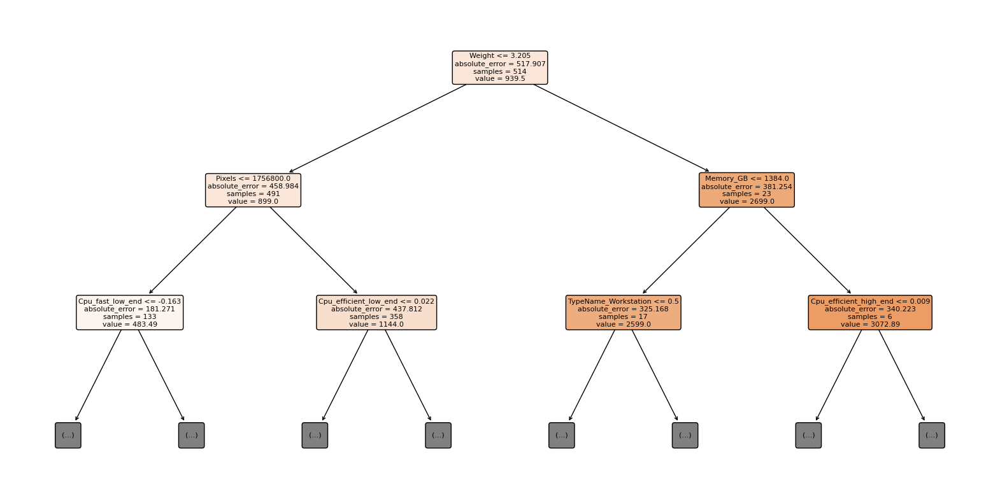

In [787]:
import random
from sklearn.tree import plot_tree

rf_gs_trees = rf_gs.estimators_
len(rf_gs_trees)
randint = random.randint(0, len(rf_gs_trees))
rand_rf_gs_tree = rf_gs_trees[randint]

plt.figure(figsize=[20, 10])
plot_tree(rand_rf_gs_tree, max_depth=2, filled=True, rounded=True, feature_names=X_test.columns)
plt.show()

Error analysis for rf_gs

In [788]:
rf_gs_error_frame = pd.DataFrame({
    'Actual Price': y_test,
    'Predicted Price': preds_rf_gs_test,
    'Error': y_test - preds_rf_gs_test
})
rf_gs_error_frame['Abs. Error'] = abs(rf_gs_error_frame['Error'])
rf_gs_error_frame.sort_values('Error', inplace=True, ascending=False)

In [789]:
rf_gs_interval = rmse_rf_gs_test * 2

In [790]:
within_interval = 0
outside_interval = 0
for resid in rf_gs_error_frame['Error']:
  if abs(resid) > rf_gs_interval:
    outside_interval += 1
  else:
    within_interval += 1

percent_within_interval = round((within_interval / len(rf_gs_error_frame['Error'])) * 100)

print(f"{percent_within_interval}% of predictions fall within the prediction interval")

96% of predictions fall within the prediction interval


Residuals plot

In [791]:
anomaly = rf_gs_error_frame.loc[(rf_gs_error_frame['Error'] < -500) & (rf_gs_error_frame['Error'] > -2000)]
anomaly

,Actual Price,Predicted Price,Error,Abs. Error
1117,1029.0,1570.79,-541.79,541.79
137,938.0,1520.13,-582.13,582.13
575,249.0,841.17,-592.17,592.17
747,539.0,1203.30,-664.30,664.30
901,1279.0,2329.34,-1050.34,1050.34


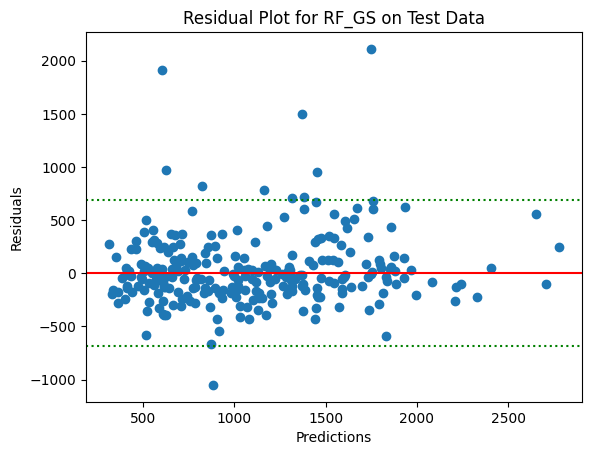

In [792]:
plt.scatter(preds_rf_gs_test, rf_gs_error_frame['Error'])
plt.axhline(y=0, color='r', linestyle='-')
plt.axhline(y=rf_gs_interval, color='g', linestyle=':')
plt.axhline(y=-rf_gs_interval, color='g', linestyle=':')
plt.title('Residual Plot for RF_GS on Test Data')
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.show()


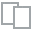
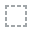
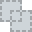
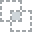
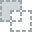
...
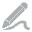
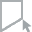
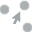
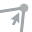
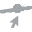

In [793]:
plot(df, 'Price_euros')

In [794]:
rf_gs_error_frame

,Actual Price,Predicted Price,Error,Abs. Error
1136,3949.4,1839.14,2110.26,2110.26
1231,3499.0,1588.53,1910.47,1910.47
911,3100.0,1605.78,1494.22,1494.22
491,2799.0,1830.94,968.06,968.06
723,3659.4,2709.93,949.47,949.47
...,...,...,...,...
1117,1029.0,1570.79,-541.79,541.79
137,938.0,1520.13,-582.13,582.13
575,249.0,841.17,-592.17,592.17
747,539.0,1203.30,-664.30,664.30


In [795]:
rf_gs_errors_top5 = rf_gs_error_frame.head()
rf_gs_errors_top5

,Actual Price,Predicted Price,Error,Abs. Error
1136,3949.4,1839.14,2110.26,2110.26
1231,3499.0,1588.53,1910.47,1910.47
911,3100.0,1605.78,1494.22,1494.22
491,2799.0,1830.94,968.06,968.06
723,3659.4,2709.93,949.47,949.47


Observing specs for greatest errors in the original dataset

In [796]:
rf_gs_error_observations = df.loc[rf_gs_errors_top5.index]
rf_gs_error_observations

,Company,Product,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price_euros,Touchscreen,IPS_display,ultrahd,Ram_Price_Ratio
1136,HP,ZBook 17,Workstation,17.3,IPS Panel Full HD 1920x1080,Intel Core i7 6700HQ 2.6GHz,8,256GB SSD,Nvidia Quadro M3000M,Windows 7,3.00,3949.4,0,1,0,493.67500
1231,Razer,Blade Pro,Gaming,14.0,Full HD 1920x1080,Intel Core i7 7700HQ 2.8GHz,16,1TB SSD,Nvidia GeForce GTX 1060,Windows 10,1.95,3499.0,0,0,0,218.68750
911,HP,Elitebook Folio,Ultrabook,12.5,4K Ultra HD / Touchscreen 3840x2160,Intel Core M 6Y75 1.2GHz,8,240GB SSD,Intel HD Graphics 515,Windows 10,1.09,3100.0,1,0,1,387.50000
491,Toshiba,Portege X30-D-10L,Ultrabook,13.3,Full HD / Touchscreen 1920x1080,Intel Core i7 7500U 2.7GHz,32,512GB SSD,Intel HD Graphics 620,Windows 10,1.05,2799.0,1,0,0,87.46875
723,Dell,Alienware 17,Gaming,17.3,4K Ultra HD 3840x2160,Intel Core i7 7700HQ 2.8GHz,32,1TB SSD + 1TB HDD,Nvidia GeForce GTX 1070,Windows 10,4.36,3659.4,0,0,1,114.35625


Feature Importances for rf_gs

In [797]:
feat_imp_rf_gs_df = pd.DataFrame(
    {
        'Feature': X_train.columns,
        'Importance (%)': (rf_gs.feature_importances_ * 100).round(2)
    }
)

feat_imp_rf_gs_df.sort_values('Importance (%)', inplace=True, ascending=False)
feat_imp_rf_gs_df.reset_index(drop=True, inplace=True)
feat_imp_rf_gs_df

,Feature,Importance (%)
0,Ram,13.10
1,Weight,10.04
2,TypeName_Notebook,6.65
3,Pixels,6.03
4,Memory_GB,5.59
5,Memory_SSD,5.44
6,Cpu_fast_high_end,5.22
7,Cpu_efficient_low_end,4.88
8,Cpu_efficient_high_end,4.84
9,Cpu_AMD_mid_range,4.78


In [798]:
cumulative_importance = feat_imp_rf_gs_df['Importance (%)'].cumsum()
feat_imp_rf_gs_df['Cumulative (%)'] = cumulative_importance
feat_imp_rf_gs_df

,Feature,Importance (%),Cumulative (%)
0,Ram,13.10,13.10
1,Weight,10.04,23.14
2,TypeName_Notebook,6.65,29.79
3,Pixels,6.03,35.82
4,Memory_GB,5.59,41.41
5,Memory_SSD,5.44,46.85
6,Cpu_fast_high_end,5.22,52.07
7,Cpu_efficient_low_end,4.88,56.95
8,Cpu_efficient_high_end,4.84,61.79
9,Cpu_AMD_mid_range,4.78,66.57


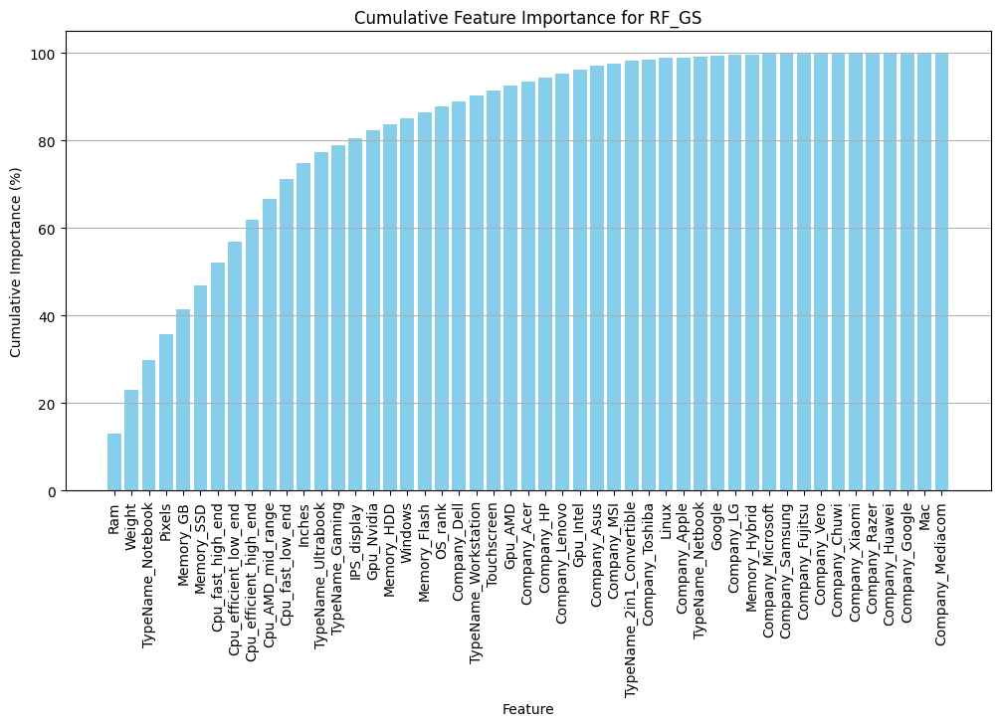

In [799]:
plt.figure(figsize=(12, 6))
plt.bar(feat_imp_rf_gs_df['Feature'], cumulative_importance, color='skyblue')
plt.xlabel('Feature')
plt.ylabel('Cumulative Importance (%)')
plt.title('Cumulative Feature Importance for RF_GS')
plt.xticks(rotation=90)
plt.grid(axis='y')
plt.show()

Because of the smoothness of the curve it's  difficult to use this visualization to refine the featureset, since we don't see any obvious cliffs in feature importance which would give us a non-arbitray cut-off point while also retaining most of the importance.

To help with feature selection, we'll calculate the jump in accumulated importance for each additional feature, to try to find natural cut-off points.

In [800]:
feat_imp_rf_gs_df['Importance_Gain'] = feat_imp_rf_gs_df['Importance (%)'].diff()
feat_imp_rf_gs_df['Percentage_Gain'] = feat_imp_rf_gs_df['Importance_Gain'] / feat_imp_rf_gs_df['Importance (%)'].shift(1) * 100
feat_imp_rf_gs_df.fillna(0, inplace=True)
feat_imp_rf_gs_df

,Feature,Importance (%),Cumulative (%),Importance_Gain,Percentage_Gain
0,Ram,13.10,13.10,0.00,0.000000
1,Weight,10.04,23.14,-3.06,-23.358779
2,TypeName_Notebook,6.65,29.79,-3.39,-33.764940
3,Pixels,6.03,35.82,-0.62,-9.323308
4,Memory_GB,5.59,41.41,-0.44,-7.296849
5,Memory_SSD,5.44,46.85,-0.15,-2.683363
6,Cpu_fast_high_end,5.22,52.07,-0.22,-4.044118
7,Cpu_efficient_low_end,4.88,56.95,-0.34,-6.513410
8,Cpu_efficient_high_end,4.84,61.79,-0.04,-0.819672
9,Cpu_AMD_mid_range,4.78,66.57,-0.06,-1.239669


The table below ranks features by importance_gain from lowest to highest, which means the biggest "cliffs" in feature immportance contribution. This can help give us an idea of natural places to make a feature-selection cut-off.

In [801]:
importance_gain = feat_imp_rf_gs_df.sort_values('Importance_Gain')
importance_gain

,Feature,Importance (%),Cumulative (%),Importance_Gain,Percentage_Gain
2,TypeName_Notebook,6.65,29.79,-3.39,-33.764940
1,Weight,10.04,23.14,-3.06,-23.358779
12,TypeName_Ultrabook,2.41,77.31,-1.26,-34.332425
11,Inches,3.67,74.90,-0.99,-21.244635
13,TypeName_Gaming,1.66,78.97,-0.75,-31.120332
3,Pixels,6.03,35.82,-0.62,-9.323308
4,Memory_GB,5.59,41.41,-0.44,-7.296849
7,Cpu_efficient_low_end,4.88,56.95,-0.34,-6.513410
29,Company_MSI,0.58,97.70,-0.27,-31.764706
6,Cpu_fast_high_end,5.22,52.07,-0.22,-4.044118


While the table below shows something similar, only calculated this time not by the absolute drop in importance contribution, but by its magnitude relative to the previous feature's importance. The rationale for this second approach is that there are large cliffs in importance where the "toe" of the cliff is still very important. For example, the biggest cliff in absolute term is between the 3rd and 4th most important features, but we would not want to exclude the 4th most important feature, which is contributing a very significant 7% importance.

In [802]:
ig_percentage = feat_imp_rf_gs_df.sort_values('Percentage_Gain')
ig_percentage

,Feature,Importance (%),Cumulative (%),Importance_Gain,Percentage_Gain
47,Mac,0.00,100.01,-0.01,-100.000000
46,Company_Google,0.01,100.01,-0.01,-50.000000
38,Company_Microsoft,0.08,99.76,-0.07,-46.666667
32,Linux,0.23,98.84,-0.19,-45.238095
39,Company_Samsung,0.05,99.81,-0.03,-37.500000
12,TypeName_Ultrabook,2.41,77.31,-1.26,-34.332425
2,TypeName_Notebook,6.65,29.79,-3.39,-33.764940
44,Company_Razer,0.02,99.98,-0.01,-33.333333
29,Company_MSI,0.58,97.70,-0.27,-31.764706
13,TypeName_Gaming,1.66,78.97,-0.75,-31.120332


In [803]:
Cpu_specs

['Cpu_Intel',
 'Cpu_AMD',
 'Cpu_frequency',
 'Cpu_model_no.',
 'Cpu_performance',
 'Cpu_efficiency',
 'Cpu_family']

This second table looks more helpful in selecting a cut-off point for feature selection.
- For a **slim** featureset, we could include only the top 12 most important features (making the cut-off just before 'IPS_display', and retain nearly 80% of importance.
- For a much **more comprehensive** featureset, we could include the top 40 most important features (making the cut-off before 'Memory_Hybrid', and retain 99.97% importance.
- Another approach might be somewhere in the **middle**, like including the top 28 (making the cut-off before 'TypeName_2_in_1_convertible'), and still retain over 96% importance. We will assign these cut-offs to variables for later use. - For any featureset though, we'll probably keep one-hot encodings together (for the same variable), and might keep some CPU specs together. E.g. We should not include model_no. without also including related specs like the CPU_brand, performance and efficiency.

In [804]:
feat_imp_rf_gs_df

,Feature,Importance (%),Cumulative (%),Importance_Gain,Percentage_Gain
0,Ram,13.10,13.10,0.00,0.000000
1,Weight,10.04,23.14,-3.06,-23.358779
2,TypeName_Notebook,6.65,29.79,-3.39,-33.764940
3,Pixels,6.03,35.82,-0.62,-9.323308
4,Memory_GB,5.59,41.41,-0.44,-7.296849
5,Memory_SSD,5.44,46.85,-0.15,-2.683363
6,Cpu_fast_high_end,5.22,52.07,-0.22,-4.044118
7,Cpu_efficient_low_end,4.88,56.95,-0.34,-6.513410
8,Cpu_efficient_high_end,4.84,61.79,-0.04,-0.819672
9,Cpu_AMD_mid_range,4.78,66.57,-0.06,-1.239669


In [805]:
# to store the desired features as a list, simply slice up to the desired feature
slim_featureset = list(feat_imp_rf_gs_df['Feature'].iloc[0:12])
mid_featureset = list(feat_imp_rf_gs_df['Feature'].iloc[0:32])
fat_featureset = list(feat_imp_rf_gs_df['Feature'].iloc[0:45])

In [806]:
slim_featureset

['Ram',
 'Weight',
 'TypeName_Notebook',
 'Pixels',
 'Memory_GB',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Cpu_efficient_low_end',
 'Cpu_efficient_high_end',
 'Cpu_AMD_mid_range',
 'Cpu_fast_low_end',
 'Inches']

To the slim featureset, we'll append also the other typenames, memory cols and CPU brand makers. We can leave out the least important typename and memory type, since these can be represented well enough by 0s in the other columns.

In [807]:
slim_featureset.extend([
    'TypeName_2in1_Convertible', 'TypeName_Gaming',
        'TypeName_Ultrabook', 'TypeName_Workstation',
    'Memory_Flash', 'Memory_HDD'
   ])
slim_featureset

['Ram',
 'Weight',
 'TypeName_Notebook',
 'Pixels',
 'Memory_GB',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Cpu_efficient_low_end',
 'Cpu_efficient_high_end',
 'Cpu_AMD_mid_range',
 'Cpu_fast_low_end',
 'Inches',
 'TypeName_2in1_Convertible',
 'TypeName_Gaming',
 'TypeName_Ultrabook',
 'TypeName_Workstation',
 'Memory_Flash',
 'Memory_HDD']

In [808]:
rf_gs_feat_imp_chart = alt.Chart(feat_imp_rf_gs_df).mark_bar().encode(
    x='Importance (%)',
    y=alt.Y("Feature", sort='-x'),
    tooltip=['Feature', 'Importance (%)']
).properties(title='Feature Importances')

rf_gs_feat_imp_chart

# index_axis = alt.Chart(feat_imp_rf_gs_df.reset_index()).mark_text().encode(
#     y=alt.Y('index:O', axis=alt.Axis(title='Index')),
#     text='index:O'
# )

# FI_chart = (rf_gs_feat_imp_chart + index_axis).resolve_scale(y='independent')

# FI_chart

alt.Chart(...)

In [809]:
feat_imp_rf_gs_top30 = feat_imp_rf_gs_df.head(30)
rf_gs_feat_imp_chart_top30 = alt.Chart(feat_imp_rf_gs_top30).mark_bar().encode(
    x='Importance (%)',
    y=alt.Y("Feature", sort='-x'),
    tooltip=['Feature', 'Importance (%)']
).properties(title='Top 30 Most Important Features for RF_GS')

rf_gs_feat_imp_chart_top30

alt.Chart(...)

In [810]:
rf_gs_feat_imp_chart_vert = alt.Chart(feat_imp_rf_gs_df).mark_bar().encode(
    x=alt.X('Feature', sort='-y'),
    y="Importance (%)",
    tooltip=['Feature', 'Importance (%)']
).properties(title='Feature Importances for RF_GS')

rf_gs_feat_imp_chart_vert

alt.Chart(...)

In [811]:
feat_imp_rf_gs_df.columns

Index(['Feature', 'Importance (%)', 'Cumulative (%)', 'Importance_Gain',
       'Percentage_Gain'],
      dtype='object')

In [812]:
rf_gs_top_20 = feat_imp_rf_gs_df.head(20)
rf_gs_top_20

,Feature,Importance (%),Cumulative (%),Importance_Gain,Percentage_Gain
0,Ram,13.10,13.10,0.00,0.000000
1,Weight,10.04,23.14,-3.06,-23.358779
2,TypeName_Notebook,6.65,29.79,-3.39,-33.764940
3,Pixels,6.03,35.82,-0.62,-9.323308
4,Memory_GB,5.59,41.41,-0.44,-7.296849
5,Memory_SSD,5.44,46.85,-0.15,-2.683363
6,Cpu_fast_high_end,5.22,52.07,-0.22,-4.044118
7,Cpu_efficient_low_end,4.88,56.95,-0.34,-6.513410
8,Cpu_efficient_high_end,4.84,61.79,-0.04,-0.819672
9,Cpu_AMD_mid_range,4.78,66.57,-0.06,-1.239669


In [813]:
rf_gs_feat_imp_chart_top20 = alt.Chart(rf_gs_top_20).mark_bar().encode(
    x=alt.X('Importance (%)'),
    y=alt.Y("Feature", sort='-x'),
    tooltip=['Feature', 'Importance (%)']
).properties(title='Top 20 Most Important Specs for RF_GS')

rf_gs_feat_imp_chart_top20

alt.Chart(...)

In [814]:
print(len(X_train))
print(len(X_val))
print(len(X_test))

828
208
259


## **[5.2]** Decision Tree

### [5.2.1] Further Feature Engineering

We use the results of Feature Importances Analysis in [5.1.5] and later coefficient analysis [6.3] above to create  new featuresets X3 (selective) and X4 (mid-range)

In [815]:
# dropping all features which had coef magnitude below constant in [6.3.2]
weak_coefs = ['TypeName_Notebook', 'Memory_GB', 'Cpu_efficient_high_end', 'Cpu_fast_low_end', 'Cpu_efficient_low_end', 'Cpu_AMD_mid_range', 'Memory_HDD']
slimmer_featureset = [x for x in slim_featureset if x not in weak_coefs]
slimmer_featureset

['Ram',
 'Weight',
 'Pixels',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Inches',
 'TypeName_2in1_Convertible',
 'TypeName_Gaming',
 'TypeName_Ultrabook',
 'TypeName_Workstation',
 'Memory_Flash']

In [816]:
X3_train = X_train[slimmer_featureset]
X3_val = X_val[slimmer_featureset]
X3_test = X_test[slimmer_featureset]

In [817]:
# scaling
scaler3 = MinMaxScaler()
scaler3.fit(X3_train)

X3_train_scaled = scaler3.transform(X3_train)
X3_val_scaled = scaler3.transform(X3_val)
X3_test_scaled = scaler3.transform(X3_test)

In [818]:
X4_train = X_train[mid_featureset]
X4_val = X_val[mid_featureset]
X4_test = X_test[mid_featureset]

We'll use the Max-Absolute Scaling method since we don't have large outliers in the features but do have negative values

In [819]:
from sklearn.preprocessing import MaxAbsScaler

scaler4 = MaxAbsScaler()
scaler4.fit(X4_train)
X4_train_scaled = scaler4.transform(X4_train)
X4_val_scaled = scaler4.transform(X4_val)
X4_test_scaled = scaler4.transform(X4_test)

In [820]:
X5_train = X_train[fat_featureset]
X5_val = X_val[fat_featureset]
X5_test = X_test[fat_featureset]

scaler5 = MaxAbsScaler()
scaler5.fit(X5_train)

X5_train_scaled = scaler5.transform(X5_train)
X5_val_scaled = scaler5.transform(X5_val)
X5_test_scaled = scaler5.transform(X5_test)

### [5.2.1] Training and Validation

Function for building DT and storing results

By default we use the refined featureset X3

In [821]:
# Define a general function to automate this process: assumes existing dicts, train-val data-split, imported functions
from sklearn.tree import DecisionTreeRegressor

def plant_tree(name, X_train=X4_train, X_val=X4_val, criterion='absolute_error', splitter='best', max_depth=None, min_samples_leaf=1, max_features=None):

  # instantiating model with specified hyperparameters
  model = DecisionTreeRegressor(criterion=criterion, splitter=splitter, max_depth=max_depth, min_samples_leaf=min_samples_leaf, max_features=max_features, random_state=2)

  # fitting model
  model.fit(X_train, y_train)

  #training results
  preds_train = model.predict(X_train).round(2)
  rmse_train = mean_squared_error(y_train, preds_train, squared=False).round(2)
  mae_train = mean_absolute_error(y_train, preds_train).round(2)
  r2_train = r2_score(y_train, preds_train).round(4)

  # validation results
  preds_val = model.predict(X_val).round(2)
  rmse_val = mean_squared_error(y_val, preds_val, squared=False).round(2)
  mae_val = mean_absolute_error(y_val, preds_val).round(2)
  r2_val = r2_score(y_val, preds_val).round(4)

  # Generalization error gain
  RMSE_generalization_gain = (rmse_val - rmse_train).round(2)
  MAE_generalization_gain = (mae_val - mae_train).round(2)

  # storing info in dicts
    # training
  models[name] = model
  train_preds[name] = preds_train
  RMSE_train_dict[name] = rmse_train
  MAE_train_dict[name] = mae_train
  R2_train_dict[name] = r2_train
    # validation
  val_preds[name] = preds_val
  RMSE_val_dict[name] = rmse_val
  MAE_val_dict[name] = mae_val
  R2_val_dict[name] = r2_val
    # Generalization error gain
  Generalization_RMSE_gain[name] = RMSE_generalization_gain
  Generalization_MAE_gain[name] = MAE_generalization_gain

  # printing results
  print(f"Training RMSE for {name}: ", rmse_train)
  print(f"Training MAE for {name}: ", mae_train)
  print(f"Training R2 for {name}: ", r2_train)
  print(" ")
  print(f"Validation RMSE for {name}: ", rmse_val)
  print(f"Validation MAE for {name}: ", mae_val)
  print(f"Validation R2 for {name}: ", r2_val)
  print(" ")
  print(f"RMSE Generalization gain for {name}: ", RMSE_generalization_gain)
  print(f"MAE Generalization gain for {name}: ", MAE_generalization_gain)

  return model

default parameters

In [822]:
from sklearn.tree import DecisionTreeRegressor

tree = plant_tree("tree")

Training RMSE for tree:  0.0
Training MAE for tree:  0.0
Training R2 for tree:  1.0
 
Validation RMSE for tree:  428.88
Validation MAE for tree:  284.72
Validation R2 for tree:  0.5557
 
RMSE Generalization gain for tree:  428.88
MAE Generalization gain for tree:  284.72


We can see that the tree has very low bias but very high variance

In [823]:
tree.get_depth()

29

limiting max depth to 15

In [824]:
tree1 = plant_tree("tree1", max_depth=15)

Training RMSE for tree1:  100.9
Training MAE for tree1:  33.61
Training R2 for tree1:  0.9761
 
Validation RMSE for tree1:  412.43
Validation MAE for tree1:  260.76
Validation R2 for tree1:  0.5891
 
RMSE Generalization gain for tree1:  311.53
MAE Generalization gain for tree1:  227.15


similar results to default tree, with very low bias and very high variance

In [825]:
tree1a = plant_tree("tree1a", max_depth=10)

Training RMSE for tree1a:  178.68
Training MAE for tree1a:  93.74
Training R2 for tree1a:  0.9252
 
Validation RMSE for tree1a:  367.98
Validation MAE for tree1a:  243.91
Validation R2 for tree1a:  0.6729
 
RMSE Generalization gain for tree1a:  189.3
MAE Generalization gain for tree1a:  150.17


tree1a with max_depth=10 performs slightly better than no max depth on val MAE and slightly worse on val RMSE

Trying with X4

In [826]:
tree1a_X4 = plant_tree("tree1a_X4", X_train=X4_train, X_val=X4_val, max_depth=10)

Training RMSE for tree1a_X4:  178.68
Training MAE for tree1a_X4:  93.74
Training R2 for tree1a_X4:  0.9252
 
Validation RMSE for tree1a_X4:  367.98
Validation MAE for tree1a_X4:  243.91
Validation R2 for tree1a_X4:  0.6729
 
RMSE Generalization gain for tree1a_X4:  189.3
MAE Generalization gain for tree1a_X4:  150.17


this one still overfits quite a bit

In [827]:
tree1b = plant_tree("tree1b", max_depth=5)

Training RMSE for tree1b:  313.72
Training MAE for tree1b:  211.72
Training R2 for tree1b:  0.7694
 
Validation RMSE for tree1b:  353.05
Validation MAE for tree1b:  252.06
Validation R2 for tree1b:  0.6989
 
RMSE Generalization gain for tree1b:  39.33
MAE Generalization gain for tree1b:  40.34


performance degrades at max_depth=5. We could experiment with md between 6 and 14. seem to be getting closer now to an inflection point between bias and variance.

trying with X4

In [828]:
tree1b_X4 = plant_tree("tree1b_X4", X_train=X4_train, X_val=X4_val, max_depth=5)

Training RMSE for tree1b_X4:  313.72
Training MAE for tree1b_X4:  211.72
Training R2 for tree1b_X4:  0.7694
 
Validation RMSE for tree1b_X4:  353.05
Validation MAE for tree1b_X4:  252.06
Validation R2 for tree1b_X4:  0.6989
 
RMSE Generalization gain for tree1b_X4:  39.33
MAE Generalization gain for tree1b_X4:  40.34


lower error scores but also lower generalization gain which is perhaps a little surprising

tuning max_features

In [829]:
tree2 = plant_tree("tree2", max_features='sqrt')

Training RMSE for tree2:  0.0
Training MAE for tree2:  0.0
Training R2 for tree2:  1.0
 
Validation RMSE for tree2:  457.04
Validation MAE for tree2:  307.25
Validation R2 for tree2:  0.4954
 
RMSE Generalization gain for tree2:  457.04
MAE Generalization gain for tree2:  307.25


worse when limiting max_features. makes sense when we only have 1 tree and a selected 11 features

tuning min_samples_leaf

In [830]:
tree3 = plant_tree("tree3", min_samples_leaf=2)

Training RMSE for tree3:  132.73
Training MAE for tree3:  72.02
Training R2 for tree3:  0.9587
 
Validation RMSE for tree3:  391.24
Validation MAE for tree3:  259.81
Validation R2 for tree3:  0.6303
 
RMSE Generalization gain for tree3:  258.51
MAE Generalization gain for tree3:  187.79


tuning up msl increases bias but reduces variance

In [831]:
tree3a = plant_tree("tree3a", min_samples_leaf=5)

Training RMSE for tree3a:  231.24
Training MAE for tree3a:  134.26
Training R2 for tree3a:  0.8747
 
Validation RMSE for tree3a:  349.23
Validation MAE for tree3a:  240.28
Validation R2 for tree3a:  0.7054
 
RMSE Generalization gain for tree3a:  117.99
MAE Generalization gain for tree3a:  106.02


tunin up msl again reduces variance at the expense of bias, ultimately with a better validation result

trying with X4

In [832]:
tree3b = plant_tree("tree3b", min_samples_leaf=10)

Training RMSE for tree3b:  289.65
Training MAE for tree3b:  181.26
Training R2 for tree3b:  0.8034
 
Validation RMSE for tree3b:  370.56
Validation MAE for tree3b:  253.68
Validation R2 for tree3b:  0.6683
 
RMSE Generalization gain for tree3b:  80.91
MAE Generalization gain for tree3b:  72.42


again succeeds in improving val scores

In [833]:
tree3c = plant_tree("tree3c", min_samples_leaf=20)

Training RMSE for tree3c:  330.43
Training MAE for tree3c:  217.56
Training R2 for tree3c:  0.7442
 
Validation RMSE for tree3c:  385.76
Validation MAE for tree3c:  261.74
Validation R2 for tree3c:  0.6406
 
RMSE Generalization gain for tree3c:  55.33
MAE Generalization gain for tree3c:  44.18


at msl=20, variance surpasses bias when measured by RMSE (better RMSE score on validation than on training). Still an overall improvement on validation scores

In [834]:
tree3d = plant_tree("tree3d", min_samples_leaf=25)

Training RMSE for tree3d:  345.04
Training MAE for tree3d:  229.34
Training R2 for tree3d:  0.7211
 
Validation RMSE for tree3d:  389.2
Validation MAE for tree3d:  257.69
Validation R2 for tree3d:  0.6341
 
RMSE Generalization gain for tree3d:  44.16
MAE Generalization gain for tree3d:  28.35


validation performance starts to degrade between 20 and 25 for msl

In [835]:
tree3E = plant_tree("tree3E", min_samples_leaf=15)

Training RMSE for tree3E:  322.44
Training MAE for tree3E:  205.84
Training R2 for tree3E:  0.7564
 
Validation RMSE for tree3E:  355.68
Validation MAE for tree3E:  253.09
Validation R2 for tree3E:  0.6944
 
RMSE Generalization gain for tree3E:  33.24
MAE Generalization gain for tree3E:  47.25


In [836]:
tree3E_depth = tree3E.get_depth()
tree3E_depth

10

msl=15 performs better than msl=20 and =10. an optimum probably between 11 and 19

gridsearch to determine optimal params for min_samples_leaf and max_depth

In [837]:
from sklearn.model_selection import GridSearchCV

dtr_se = DecisionTreeRegressor(random_state=2)
params_grid = {
    'min_samples_leaf': np.arange(11, 19, 1),
    'max_depth': np.arange(6, 14, 1)
}

tree_rmse_opt = GridSearchCV(dtr_se, params_grid, scoring='neg_root_mean_squared_error')
tree_rmse_opt.fit(X3_train, y_train)
tree_rmse_opt.best_params_

{'max_depth': 7, 'min_samples_leaf': 11}

GSCV find max_depth=7 and min_samples_leaf=11 as optimal for reducing RMSE

In [838]:
dtr_ae = DecisionTreeRegressor(criterion='absolute_error', random_state=2)
tree_mae_opt = GridSearchCV(dtr_ae, params_grid, scoring='neg_mean_absolute_error')
tree_mae_opt.fit(X_train, y_train)
tree_mae_opt.best_params_

{'max_depth': 8, 'min_samples_leaf': 11}

max_depth=8 and msl=11 for reducing MAE

In [839]:
tree_r2_opt = GridSearchCV(dtr_ae, params_grid, scoring='r2')
tree_r2_opt.fit(X_train, y_train)
tree_r2_opt.best_params_

{'max_depth': 6, 'min_samples_leaf': 11}

max_depth=6 and msl=11 for improving r2. Taking all three together we might try max_depth=9, msl=11.

In [840]:
tree_gs = plant_tree("tree_gs", max_depth=7, min_samples_leaf=11)

Training RMSE for tree_gs:  306.08
Training MAE for tree_gs:  200.87
Training R2 for tree_gs:  0.7805
 
Validation RMSE for tree_gs:  350.26
Validation MAE for tree_gs:  249.4
Validation R2 for tree_gs:  0.7037
 
RMSE Generalization gain for tree_gs:  44.18
MAE Generalization gain for tree_gs:  48.53


looks quite good on generalization gain: the small values separating train error from val error

trying same params with larger featureset X4

In [841]:
tree_gs_X4 = plant_tree("tree_gs_X4", X_train=X4_train, X_val=X4_val, max_depth=7, min_samples_leaf=11)

Training RMSE for tree_gs_X4:  306.08
Training MAE for tree_gs_X4:  200.87
Training R2 for tree_gs_X4:  0.7805
 
Validation RMSE for tree_gs_X4:  350.26
Validation MAE for tree_gs_X4:  249.4
Validation R2 for tree_gs_X4:  0.7037
 
RMSE Generalization gain for tree_gs_X4:  44.18
MAE Generalization gain for tree_gs_X4:  48.53


actually we get quite good results here

trying random splitter

In [842]:
tree_grid2 = plant_tree("tree_grid2", splitter="random", max_depth=7, min_samples_leaf=11)

Training RMSE for tree_grid2:  372.67
Training MAE for tree_grid2:  240.81
Training R2 for tree_grid2:  0.6746
 
Validation RMSE for tree_grid2:  361.66
Validation MAE for tree_grid2:  248.9
Validation R2 for tree_grid2:  0.6841
 
RMSE Generalization gain for tree_grid2:  -11.01
MAE Generalization gain for tree_grid2:  8.09


overall worse performance with random splits

### [5.2.2] Results and Analysis

In [843]:
params_list = []
model_list = []
dt_train_rmse = []
dt_val_rmse = []
dt_rmse_generalization = []
dt_train_mae = []
dt_val_mae = []
dt_mae_generalization = []
dt_train_r2 = []
dt_val_r2 = []
dt_r2_generalization = []

for name, model in models.items():
  if isinstance(model, DecisionTreeRegressor):
    hyperparameters = {
        'Model': name,
        'Tree Depth': model.get_depth(),
        'Min Samples per Leaf': model.min_samples_leaf,
        'Max Features': model.max_features
    }
    params_list.append(hyperparameters)
    model_list.append(name)
    dt_train_rmse.append(RMSE_train_dict[name])
    dt_val_rmse.append(RMSE_val_dict[name])
    dt_rmse_generalization.append(Generalization_RMSE_gain[name])
    dt_train_mae.append(MAE_train_dict[name])
    dt_val_mae.append(MAE_val_dict[name])
    dt_mae_generalization.append(Generalization_MAE_gain[name])
    dt_train_r2.append(R2_train_dict[name])
    dt_val_r2.append(R2_val_dict[name])

hyperparameters_df = pd.DataFrame(params_list)
results_df = pd.DataFrame({
    'Model': model_list,
    'Train RMSE': dt_train_rmse,
    'Train MAE': dt_train_mae,
    'Train R2': dt_train_r2,
    'Validation RMSE': dt_val_rmse,
    'Validation MAE': dt_val_mae,
    'Validation R2': dt_val_r2,
    'RMSE Generalization': dt_rmse_generalization,
    'MAE Generalization': dt_mae_generalization,
})
results_df['R2 Generalization'] = results_df['Train R2'] - results_df['Validation R2']

dt_results = hyperparameters_df.merge(results_df, on='Model')
dt_results

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,tree,29,1,None,0.00,0.00,1.0000,428.88,284.72,0.5557,428.88,284.72,0.4443
1,tree1,15,1,None,100.90,33.61,0.9761,412.43,260.76,0.5891,311.53,227.15,0.3870
2,tree1a,10,1,None,178.68,93.74,0.9252,367.98,243.91,0.6729,189.30,150.17,0.2523
3,tree1a_X4,10,1,None,178.68,93.74,0.9252,367.98,243.91,0.6729,189.30,150.17,0.2523
4,tree1b,5,1,None,313.72,211.72,0.7694,353.05,252.06,0.6989,39.33,40.34,0.0705
5,tree1b_X4,5,1,None,313.72,211.72,0.7694,353.05,252.06,0.6989,39.33,40.34,0.0705
6,tree2,27,1,sqrt,0.00,0.00,1.0000,457.04,307.25,0.4954,457.04,307.25,0.5046
7,tree3,25,2,None,132.73,72.02,0.9587,391.24,259.81,0.6303,258.51,187.79,0.3284
8,tree3a,20,5,None,231.24,134.26,0.8747,349.23,240.28,0.7054,117.99,106.02,0.1693
9,tree3b,15,10,None,289.65,181.26,0.8034,370.56,253.68,0.6683,80.91,72.42,0.1351


In [844]:
# changing R2 to percentages
dt_results['Train R2'] = (dt_results['Train R2'] * 100).round(3)
dt_results['Validation R2'] = (dt_results['Validation R2'] * 100).round(3)
dt_results['R2 Generalization'] = (dt_results['R2 Generalization'] * 100).round(3)

In [845]:
dt_results

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,tree,29,1,None,0.00,0.00,100.00,428.88,284.72,55.57,428.88,284.72,44.43
1,tree1,15,1,None,100.90,33.61,97.61,412.43,260.76,58.91,311.53,227.15,38.70
2,tree1a,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
3,tree1a_X4,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
6,tree2,27,1,sqrt,0.00,0.00,100.00,457.04,307.25,49.54,457.04,307.25,50.46
7,tree3,25,2,None,132.73,72.02,95.87,391.24,259.81,63.03,258.51,187.79,32.84
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51


In [846]:
DTs_by_RMSE = dt_results.sort_values('Validation RMSE')
DTs_by_MAE = dt_results.sort_values('Validation MAE')
DTs_by_R2 = dt_results.sort_values('Validation R2', ascending=False)
DTs_by_RMSE_gen = dt_results.sort_values('RMSE Generalization')
DTs_by_MAE_gen = dt_results.sort_values('MAE Generalization')
DTs_by_R2_gen = dt_results.sort_values('R2 Generalization')

In [847]:
DTs_by_RMSE

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
2,tree1a,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
3,tree1a_X4,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51


tree_gs_X4 is RMSE winner. tree1a_X4 wins on MAE but has high generalization.

In [848]:
DTs_by_MAE

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93
2,tree1a,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
3,tree1a_X4,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51


In [849]:
DTs_by_R2

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
2,tree1a,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
3,tree1a_X4,10,1,None,178.68,93.74,92.52,367.98,243.91,67.29,189.30,150.17,25.23
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51


In [850]:
DTs_by_RMSE_gen

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
11,tree3d,9,25,None,345.04,229.34,72.11,389.20,257.69,63.41,44.16,28.35,8.70
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
10,tree3c,9,20,None,330.43,217.56,74.42,385.76,261.74,64.06,55.33,44.18,10.36
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93


In [851]:
DTs_by_MAE_gen

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
11,tree3d,9,25,None,345.04,229.34,72.11,389.20,257.69,63.41,44.16,28.35,8.70
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
10,tree3c,9,20,None,330.43,217.56,74.42,385.76,261.74,64.06,55.33,44.18,10.36
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93


In [852]:
DTs_by_R2_gen

,Model,Tree Depth,Min Samples per Leaf,Max Features,Train RMSE,Train MAE,Train R2,Validation RMSE,Validation MAE,Validation R2,RMSE Generalization,MAE Generalization,R2 Generalization
15,tree_grid2,7,11,None,372.67,240.81,67.46,361.66,248.90,68.41,-11.01,8.09,-0.95
12,tree3E,10,15,None,322.44,205.84,75.64,355.68,253.09,69.44,33.24,47.25,6.20
4,tree1b,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
5,tree1b_X4,5,1,None,313.72,211.72,76.94,353.05,252.06,69.89,39.33,40.34,7.05
13,tree_gs,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
14,tree_gs_X4,7,11,None,306.08,200.87,78.05,350.26,249.40,70.37,44.18,48.53,7.68
11,tree3d,9,25,None,345.04,229.34,72.11,389.20,257.69,63.41,44.16,28.35,8.70
10,tree3c,9,20,None,330.43,217.56,74.42,385.76,261.74,64.06,55.33,44.18,10.36
9,tree3b,15,10,None,289.65,181.26,80.34,370.56,253.68,66.83,80.91,72.42,13.51
8,tree3a,20,5,None,231.24,134.26,87.47,349.23,240.28,70.54,117.99,106.02,16.93


### [5.2.3] Testing

In [853]:
test_preds = {}
test_rmse_list = []
test_mae_list = []
test_r2_list = []
rmse_generalization = []
mae_generalization = []
r2_generalization = []
tested_models = []

Tree1a_X4

In [854]:
preds_tree1a_X4_test = tree1a_X4.predict(X4_test)
rmse_tree1a_X4_test = (mean_squared_error(y_test, preds_tree1a_X4_test, squared=False)).round(2)
mae_tree1a_X4_test = (mean_absolute_error(y_test, preds_tree1a_X4_test)).round(2)
r2_tree1a_X4_test = (r2_score(y_test, preds_tree1a_X4_test) * 100).round(3)

test_preds["tree1a_X4"]: preds_tree1a_X4_test
test_rmse_list.append(rmse_tree1a_X4_test)
test_mae_list.append(mae_tree1a_X4_test)
test_r2_list.append(r2_tree1a_X4_test)
tested_models.append("tree1a_X4")

tree1a_X4_results = dt_results.loc[dt_results['Model'] == "tree1a_X4"]
rmse_gen_tree1a_X4 = tree1a_X4_results.iloc[0]['Train RMSE'] - rmse_tree1a_X4_test
mae_gen_tree1a_X4 = tree1a_X4_results.iloc[0]['Train MAE'] - mae_tree1a_X4_test
r2_gen_tree1a_X4 = r2_tree1a_X4_test - tree1a_X4_results.iloc[0]['Train R2']

rmse_generalization.append(rmse_gen_tree1a_X4)
mae_generalization.append(mae_gen_tree1a_X4)
r2_generalization.append(r2_gen_tree1a_X4)

print("RMSE for tree1a_X4 on testing data: ", rmse_tree1a_X4_test)
print("MAE for tree1a_X4 on testing data: ", mae_tree1a_X4_test)
print("R-squared score for tree1a_X4 on testing data: %", r2_tree1a_X4_test)
print("RMSE Generalization: ", rmse_gen_tree1a_X4)
print("MAE Generalization: ", mae_gen_tree1a_X4)
print("R2 Generalization: %", r2_gen_tree1a_X4)

RMSE for tree1a_X4 on testing data:  407.47
MAE for tree1a_X4 on testing data:  271.23
R-squared score for tree1a_X4 on testing data: % 65.833
RMSE Generalization:  -228.79000000000002
MAE Generalization:  -177.49
R2 Generalization: % -26.686999999999998


significant overfitting

Tree3: lowest validation MAE

In [855]:
preds_tree3_test = tree3.predict(X4_test)
rmse_tree3_test = (mean_squared_error(y_test, preds_tree3_test, squared=False)).round(2)
mae_tree3_test = (mean_absolute_error(y_test, preds_tree3_test)).round(2)
r2_tree3_test = (r2_score(y_test, preds_tree3_test) * 100).round(3)

test_preds["tree3"]: preds_tree3_test
test_rmse_list.append(rmse_tree3_test)
test_mae_list.append(mae_tree3_test)
test_r2_list.append(r2_tree3_test)
tested_models.append("tree3")

tree3_results = dt_results.loc[dt_results['Model'] == "tree3"]
rmse_gen_tree3 = tree3_results.iloc[0]['Train RMSE'] - rmse_tree3_test
mae_gen_tree3 = tree3_results.iloc[0]['Train MAE'] - mae_tree3_test
r2_gen_tree3 = r2_tree3_test - tree3_results.iloc[0]['Train R2']

rmse_generalization.append(rmse_gen_tree3)
mae_generalization.append(mae_gen_tree3)
r2_generalization.append(r2_gen_tree3)

print("RMSE for tree3 on testing data: ", rmse_tree3_test)
print("MAE for tree3 on testing data: ", mae_tree3_test)
print("R-squared score for tree3 on testing data: %", r2_tree3_test)
print("RMSE Generalization: ", rmse_gen_tree3)
print("MAE Generalization: ", mae_gen_tree3)
print("R2 Generalization: %", r2_gen_tree3)

RMSE for tree3 on testing data:  445.72
MAE for tree3 on testing data:  306.17
R-squared score for tree3 on testing data: % 59.116
RMSE Generalization:  -312.99
MAE Generalization:  -234.15000000000003
R2 Generalization: % -36.754000000000005


tree3a: highest R2 and lowest RMSE on validation

In [856]:
preds_tree3a_test = tree3a.predict(X4_test)
rmse_tree3a_test = (mean_squared_error(y_test, preds_tree3a_test, squared=False)).round(2)
mae_tree3a_test = (mean_absolute_error(y_test, preds_tree3a_test)).round(2)
r2_tree3a_test = (r2_score(y_test, preds_tree3a_test) * 100).round(3)

test_preds["tree3a"]: preds_tree3a_test
test_rmse_list.append(rmse_tree3a_test)
test_mae_list.append(mae_tree3a_test)
test_r2_list.append(r2_tree3a_test)
tested_models.append("tree3a")

tree3a_results = dt_results.loc[dt_results['Model'] == "tree3a"]
rmse_gen_tree3a = (tree3a_results.iloc[0]['Train RMSE'] - rmse_tree3a_test).round(2)
mae_gen_tree3a = (tree3a_results.iloc[0]['Train MAE'] - mae_tree3a_test).round(2)
r2_gen_tree3a = (r2_tree3a_test - tree3a_results.iloc[0]['Train R2']).round(3)

rmse_generalization.append(rmse_gen_tree3a)
mae_generalization.append(mae_gen_tree3a)
r2_generalization.append(r2_gen_tree3a)

print("RMSE for tree3a on testing data: ", rmse_tree3a_test)
print("MAE for tree3a on testing data: ", mae_tree3a_test)
print("R-squared score for tree3a on testing data: %", r2_tree3a_test)
print("RMSE Generalization: ", rmse_gen_tree3a)
print("MAE Generalization: ", mae_gen_tree3a)
print("R2 Generalization: %", r2_gen_tree3a)

RMSE for tree3a on testing data:  396.16
MAE for tree3a on testing data:  267.14
R-squared score for tree3a on testing data: % 67.702
RMSE Generalization:  -164.92
MAE Generalization:  -132.88
R2 Generalization: % -19.768


tree3d: lowest MAE generalization

In [857]:
preds_tree3d_test = tree3d.predict(X4_test)
rmse_tree3d_test = (mean_squared_error(y_test, preds_tree3d_test, squared=False)).round(2)
mae_tree3d_test = (mean_absolute_error(y_test, preds_tree3d_test)).round(2)
r2_tree3d_test = (r2_score(y_test, preds_tree3d_test) * 100).round(3)

test_preds["tree3d"]: preds_tree3d_test
test_rmse_list.append(rmse_tree3d_test)
test_mae_list.append(mae_tree3d_test)
test_r2_list.append(r2_tree3d_test)
tested_models.append("tree3d")

tree3d_results = dt_results.loc[dt_results['Model'] == "tree3d"]
rmse_gen_tree3d = (tree3d_results.iloc[0]['Train RMSE'] - rmse_tree3d_test).round(2)
mae_gen_tree3d = (tree3d_results.iloc[0]['Train MAE'] - mae_tree3d_test).round(2)
r2_gen_tree3d = (r2_tree3d_test - tree3d_results.iloc[0]['Train R2']).round(3)

rmse_generalization.append(rmse_gen_tree3d)
mae_generalization.append(mae_gen_tree3d)
r2_generalization.append(r2_gen_tree3d)

print("RMSE for tree3d on testing data: ", rmse_tree3d_test)
print("MAE for tree3d on testing data: ", mae_tree3d_test)
print("R-squared score for tree3d on testing data: %", r2_tree3d_test)
print("RMSE Generalization: ", rmse_gen_tree3d)
print("MAE Generalization: ", mae_gen_tree3d)
print("R2 Generalization: %", r2_gen_tree3d)

RMSE for tree3d on testing data:  397.86
MAE for tree3d on testing data:  272.04
R-squared score for tree3d on testing data: % 67.424
RMSE Generalization:  -52.82
MAE Generalization:  -42.7
R2 Generalization: % -4.686


tree_gs: five-fold cross-validated parameters, so may be less overfitted to the validation set than other models.

In [858]:
preds_tree_gs_test = tree_gs.predict(X4_test)
rmse_tree_gs_test = (mean_squared_error(y_test, preds_tree_gs_test, squared=False)).round(2)
mae_tree_gs_test = (mean_absolute_error(y_test, preds_tree_gs_test)).round(2)
r2_tree_gs_test = (r2_score(y_test, preds_tree_gs_test) * 100).round(3)

test_preds["tree_gs"]: preds_tree_gs_test
test_rmse_list.append(rmse_tree_gs_test)
test_mae_list.append(mae_tree_gs_test)
test_r2_list.append(r2_tree_gs_test)
tested_models.append("tree_gs")

tree_gs_results = dt_results.loc[dt_results['Model'] == "tree_gs"]
rmse_gen_tree_gs = (tree_gs_results.iloc[0]['Train RMSE'] - rmse_tree_gs_test).round(2)
mae_gen_tree_gs = (tree_gs_results.iloc[0]['Train MAE'] - mae_tree_gs_test).round(2)
r2_gen_tree_gs = (r2_tree_gs_test - tree_gs_results.iloc[0]['Train R2']).round(3)

rmse_generalization.append(rmse_gen_tree_gs)
mae_generalization.append(mae_gen_tree_gs)
r2_generalization.append(r2_gen_tree_gs)

print("RMSE for tree_gs on testing data: ", rmse_tree_gs_test)
print("MAE for tree_gs on testing data: ", mae_tree_gs_test)
print("R-squared score for tree_gs on testing data: %", r2_tree_gs_test)
print("RMSE Generalization: ", rmse_gen_tree_gs)
print("MAE Generalization: ", mae_gen_tree_gs)
print("R2 Generalization: %", r2_gen_tree_gs)

RMSE for tree_gs on testing data:  388.83
MAE for tree_gs on testing data:  265.61
R-squared score for tree_gs on testing data: % 68.887
RMSE Generalization:  -82.75
MAE Generalization:  -64.74
R2 Generalization: % -9.163


tree_gs actually has lower RMSE on the test set than on the training set, with low MAE and R2 gains.

tree_gs_X4

In [859]:
preds_tree_gs_X4_test = tree_gs_X4.predict(X4_test)
rmse_tree_gs_X4_test = (mean_squared_error(y_test, preds_tree_gs_X4_test, squared=False)).round(2)
mae_tree_gs_X4_test = (mean_absolute_error(y_test, preds_tree_gs_X4_test)).round(2)
r2_tree_gs_X4_test = (r2_score(y_test, preds_tree_gs_X4_test) * 100).round(3)

test_preds["tree_gs_X4"]: preds_tree_gs_X4_test
test_rmse_list.append(rmse_tree_gs_X4_test)
test_mae_list.append(mae_tree_gs_X4_test)
test_r2_list.append(r2_tree_gs_X4_test)
tested_models.append("tree_gs_X4")

tree_gs_X4_results = dt_results.loc[dt_results['Model'] == "tree_gs_X4"]
rmse_gen_tree_gs_X4 = tree_gs_X4_results.iloc[0]['Train RMSE'] - rmse_tree_gs_X4_test
mae_gen_tree_gs_X4 = tree_gs_X4_results.iloc[0]['Train MAE'] - mae_tree_gs_X4_test
r2_gen_tree_gs_X4 = r2_tree_gs_X4_test - tree_gs_X4_results.iloc[0]['Train R2']

rmse_generalization.append(rmse_gen_tree_gs_X4)
mae_generalization.append(mae_gen_tree_gs_X4)
r2_generalization.append(r2_gen_tree_gs_X4)

print("RMSE for tree_gs_X4 on testing data: ", rmse_tree_gs_X4_test)
print("MAE for tree_gs_X4 on testing data: ", mae_tree_gs_X4_test)
print("R-squared score for tree_gs_X4 on testing data: %", r2_tree_gs_X4_test)
print("RMSE Generalization: ", rmse_gen_tree_gs_X4)
print("MAE Generalization: ", mae_gen_tree_gs_X4)
print("R2 Generalization: %", r2_gen_tree_gs_X4)

RMSE for tree_gs_X4 on testing data:  388.83
MAE for tree_gs_X4 on testing data:  265.61
R-squared score for tree_gs_X4 on testing data: % 68.887
RMSE Generalization:  -82.75
MAE Generalization:  -64.74000000000001
R2 Generalization: % -9.162999999999997


not too much overfitting here

tree_grid2: lowest R2 and MAE generalization, 5-fold cross-validated

In [860]:
preds_tree_grid2_test = tree_grid2.predict(X4_test)
rmse_tree_grid2_test = (mean_squared_error(y_test, preds_tree_grid2_test, squared=False)).round(2)
mae_tree_grid2_test = (mean_absolute_error(y_test, preds_tree_grid2_test)).round(2)
r2_tree_grid2_test = (r2_score(y_test, preds_tree_grid2_test) * 100).round(3)

test_preds["tree_grid2"]: preds_tree_grid2_test
test_rmse_list.append(rmse_tree_grid2_test)
test_mae_list.append(mae_tree_grid2_test)
test_r2_list.append(r2_tree_grid2_test)
tested_models.append("tree_grid2")

tree_grid2_results = dt_results.loc[dt_results['Model'] == "tree_grid2"]
rmse_gen_tree_grid2 = (tree_grid2_results.iloc[0]['Train RMSE'] - rmse_tree_grid2_test).round(2) # positive is good (test error lower than training error)
mae_gen_tree_grid2 = (tree_grid2_results.iloc[0]['Train MAE'] - mae_tree_grid2_test).round(2)
r2_gen_tree_grid2 = (r2_tree_grid2_test - tree_grid2_results.iloc[0]['Train R2']).round(3) # positive is good (better fit to test than train data)

rmse_generalization.append(rmse_gen_tree_grid2)
mae_generalization.append(mae_gen_tree_grid2)
r2_generalization.append(r2_gen_tree_grid2)

print("RMSE for tree_grid2 on testing data: ", rmse_tree_grid2_test)
print("MAE for tree_grid2 on testing data: ", mae_tree_grid2_test)
print("R-squared score for tree_grid2 on testing data: %", r2_tree_grid2_test)
print("RMSE Generalization: ", rmse_gen_tree_grid2)
print("MAE Generalization: ", mae_gen_tree_grid2)
print("R2 Generalization: %", r2_gen_tree_grid2)

RMSE for tree_grid2 on testing data:  395.89
MAE for tree_grid2 on testing data:  281.22
R-squared score for tree_grid2 on testing data: % 67.747
RMSE Generalization:  -23.22
MAE Generalization:  -40.41
R2 Generalization: % 0.287


Test results comparison

In [861]:
tree_tests = pd.DataFrame({
    'Model': tested_models,
    'RMSE': test_rmse_list,
    'MAE': test_mae_list,
    'R2': test_r2_list,
    'RMSE Generalization': rmse_generalization,
    'MAE Generalization': mae_generalization,
    'R2 Generalization': r2_generalization
})

trees_by_rmse = tree_tests.sort_values('RMSE')
trees_by_mae = tree_tests.sort_values('MAE')
trees_by_r2 = tree_tests.sort_values('R2', ascending=False)
trees_by_rmse_gen = tree_tests.sort_values('RMSE Generalization', ascending=False)
trees_by_mae_gen = tree_tests.sort_values('MAE Generalization', ascending=False)
trees_by_r2_gen = tree_tests.sort_values('R2 Generalization', ascending=False)

In [862]:
trees_by_rmse

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,tree_gs,388.83,265.61,68.887,-82.75,-64.74,-9.163
5,tree_gs_X4,388.83,265.61,68.887,-82.75,-64.74,-9.163
6,tree_grid2,395.89,281.22,67.747,-23.22,-40.41,0.287
2,tree3a,396.16,267.14,67.702,-164.92,-132.88,-19.768
3,tree3d,397.86,272.04,67.424,-52.82,-42.70,-4.686
0,tree1a_X4,407.47,271.23,65.833,-228.79,-177.49,-26.687
1,tree3,445.72,306.17,59.116,-312.99,-234.15,-36.754


tree_gs_X4 has the lowest RMSE and highest R2, tree3a lowest MAE

In [863]:
trees_by_mae

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,tree_gs,388.83,265.61,68.887,-82.75,-64.74,-9.163
5,tree_gs_X4,388.83,265.61,68.887,-82.75,-64.74,-9.163
2,tree3a,396.16,267.14,67.702,-164.92,-132.88,-19.768
0,tree1a_X4,407.47,271.23,65.833,-228.79,-177.49,-26.687
3,tree3d,397.86,272.04,67.424,-52.82,-42.70,-4.686
6,tree_grid2,395.89,281.22,67.747,-23.22,-40.41,0.287
1,tree3,445.72,306.17,59.116,-312.99,-234.15,-36.754


In [864]:
trees_by_r2

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,tree_gs,388.83,265.61,68.887,-82.75,-64.74,-9.163
5,tree_gs_X4,388.83,265.61,68.887,-82.75,-64.74,-9.163
6,tree_grid2,395.89,281.22,67.747,-23.22,-40.41,0.287
2,tree3a,396.16,267.14,67.702,-164.92,-132.88,-19.768
3,tree3d,397.86,272.04,67.424,-52.82,-42.70,-4.686
0,tree1a_X4,407.47,271.23,65.833,-228.79,-177.49,-26.687
1,tree3,445.72,306.17,59.116,-312.99,-234.15,-36.754


In [865]:
trees_by_rmse_gen

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
6,tree_grid2,395.89,281.22,67.747,-23.22,-40.41,0.287
3,tree3d,397.86,272.04,67.424,-52.82,-42.70,-4.686
4,tree_gs,388.83,265.61,68.887,-82.75,-64.74,-9.163
5,tree_gs_X4,388.83,265.61,68.887,-82.75,-64.74,-9.163
2,tree3a,396.16,267.14,67.702,-164.92,-132.88,-19.768
0,tree1a_X4,407.47,271.23,65.833,-228.79,-177.49,-26.687
1,tree3,445.72,306.17,59.116,-312.99,-234.15,-36.754


tree3d is the least overfitted

In [866]:
tree_winners = tree_tests.iloc[[1, 6]]
tree_winners

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
1,tree3,445.72,306.17,59.116,-312.99,-234.15,-36.754
6,tree_grid2,395.89,281.22,67.747,-23.22,-40.41,0.287


graphing tree_gs_X4

In [867]:
data = pd.DataFrame({'Target': y_test, 'Predictions': preds_tree_gs_X4_test})
perf_test_chart = alt.Chart(data).mark_line(color='green').encode(
    x=alt.X('Target:Q', title=''),
    y=alt.Y('Target:Q', title='')
)

tree_gs_X4_test_chart = alt.Chart(data).mark_line(color='blue').encode(
    x=alt.X('Target:Q', title='Actual Price (€)'),
    y=alt.X('Predictions:Q', title='Predicted Price (€)')
).properties(title='Tree_gs_X4 Predictions (blue) against Target (green)')

perf_test_chart + tree_gs_X4_test_chart

alt.LayerChart(...)

We can see a fair bit of variation around the actual price, though generally trending wth actuals. Variation from the target increases most significantly when approaching the 2k mark.

Analyzing tree_gs_X4

In [868]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

plt.figure(figsize=(200,100))
plot_tree(tree_gs_X4, filled=True, rounded=True, feature_names=X4_test.columns)
plt.show()

# **[6]** Parametric Models

## [6.1] Defining and Importing Functions

The compute_errors function automates the process of calculating, storing and printing errors and making comparisons

In [869]:
from sklearn.metrics import mean_squared_error as mse, mean_absolute_error as mae, r2_score

In [870]:
def compute_errors(targets, predictions, comparison=None, comparison_index=None, test_index=None):

  #unpack comparison dict
  if comparison is not None:
    rmse_comparison = comparison[f"rmse_{comparison_index}"]
    mae_comparison = comparison[f"mae_{comparison_index}"]
    r2_comparison = comparison[f"r2_{comparison_index}"]
  else:
    rmse_comparison = None
    mae_comparison = None
    r2_comparison = None

  RMSE = mse(targets, predictions, squared=False)
  MAE = mae(targets, predictions)
  R2 = r2_score(targets, predictions)

  results = {}
  results[f"rmse_{test_index}"] = RMSE
  results[f"mae_{test_index}"] = MAE
  results[f"r2_{test_index}"] = R2

  print(f"RMSE for {test_index}: ", RMSE)
  if rmse_comparison is not None:
    print(f"{comparison_index} RMSE: ", rmse_comparison)
    rmse_improvement = rmse_comparison - RMSE # by default expecting the comparison to have more error, so positive values show improvement while negative values show degradation
    print("RMSE improvement: ", rmse_improvement)
    print("RMSE improvement relative to overall errors: %", rmse_improvement / RMSE * 100)


  print("")
  print(f"MAE for {test_index}: ", MAE)
  if mae_comparison is not None:
    print(f"{comparison_index} MAE: ", mae_comparison)
    mae_improvement = mae_comparison - MAE
    print("MAE improvement: ", mae_improvement)
    print("MAE improvement relative to overall errors: %", mae_improvement / RMSE * 100)
  print("")

  print(f"R2 for {test_index}: ", R2)
  if r2_comparison is not None:
    print(f"{comparison_index} R2: ", r2_comparison)
    R2_improvement = R2 - r2_comparison
    print("R2 improvement: ", R2_improvement)
    print("R2 improvement relative to overall errors: %", R2_improvement / R2 * 100)

  return results
  # returns a results dict

## [6.2] Feature Engineering: Refining Featureset and Scaling Features

We'll start with a basic featureset containing the three features which showed highest correlation with the target in our EDA in section [2.8].

In [871]:
# Prepare data for modeling
basic_predictors = ['Inches', 'Ram', 'Weight']

X_basic_train = X_train[basic_predictors]
X_basic_val = X_val[basic_predictors]
X_basic_test = X_test[basic_predictors]

We'll now scale the features so that the models treat the magnitudes as equally important. This step wasn't necessary for the Decision Tree (meta-)models in sections [5] and [6], since DTs only deal with one feature at a time at each node of the tree. However, scaling may improve performance for Linear Regression models. Here we'll use Min-Max scaling, which scales features as values between 0 and 1. For these features, we don't have to worry about outliers or negative values. We'll fit the scaler only to the training set to avoid sharing information about the validation or testing sets with the training set.

In [872]:
from sklearn.preprocessing import MinMaxScaler

basic_scaler = MinMaxScaler()
basic_scaler.fit(X_basic_train)

Xb_train_scaled = basic_scaler.transform(X_basic_train)
Xb_val_scaled = basic_scaler.transform(X_basic_val)
Xb_test_scaled = basic_scaler.transform(X_basic_test)

We create a larger featureset called X2, which takes the top 10 most important features for the Random Forest models in [5], along with their corresponding dummy columns.

In [873]:
X2_train = X_train[slim_featureset]
X2_val = X_val[slim_featureset]
X2_test = X_test[slim_featureset]

In [874]:
scaler2 = MinMaxScaler()
scaler2.fit(X2_train)

X2_train_scaled = scaler2.transform(X2_train)
X2_val_scaled = scaler2.transform(X2_val)
X2_test_scaled = scaler2.transform(X2_test)

## [6.3] Ordinary Least Squares (OLS) Models

### [6.3.1] OLS: fitted to sparse featureset X

Let's take a look at some descriptive statistics for an Ordinary Least Squares model, taking only three basic predictors: Ram, Weight and Inches.

In [875]:
basic_predictors

['Inches', 'Ram', 'Weight']

The results table below shows descriptive statistics for an Ordinary Least Squares (OLS) model for the scaled features. The advantage of using the scaled features is that coefficient values are also scaled, so e.g. a 1 unit increase in RAM is the same as a 1 unit increase in Inches. The drawback is that the scaled units involved are more obscure.

In [876]:
import statsmodels.api as sm

# adding a constant column to our features
X_train_with_const = sm.add_constant(Xb_train_scaled)

# fitting ols model, obtaining and printing results
ols = sm.OLS(y_train, X_train_with_const)
ols_results = ols.fit()
ols_summary = ols_results.summary(xname=['Constant'] + basic_predictors)
print(ols_summary)

                            OLS Regression Results                            
Dep. Variable:            Price_euros   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.541
Method:                 Least Squares   F-statistic:                     325.5
Date:                Sun, 12 May 2024   Prob (F-statistic):          2.32e-139
Time:                        13:30:18   Log-Likelihood:                -6218.4
No. Observations:                 828   AIC:                         1.244e+04
Df Residuals:                     824   BIC:                         1.246e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Constant     803.8037     61.757     13.016      0.0

- The coefficient of the constant is ~613, indicating that this price would be the estimate if no features were taken into account. This would be a basic price estimate if we had no information at all about laptop specs.
- The coefficient for Inches is highly negative; suggesting that smaller laptops are pricier, ceteris paribus.
- Coef for Ram on the other hand is highly positive. However, we need to bear in mind that this feature is denominated as an integer, and its values are always exponents of 2 due to the binary nature of computing, whereas the other two variables are more continuous. The high t-value shows we can absolutely reject the null hypothesis that RAM has no coefficient weight.
- Coef for Weight is positive. Although lower than the coef for Ram, we need to remember that Weight is denominated to the 10s of grams. Weight has the highest value for P>|t|, but even this value means (essentially) that there's a better than 50% chance that Weight is predictive of price.
- The R2 Score is low compared to previous models, but we expect this model to fit less well to its training data -- this is  the potential advantage of a simple OLS model. The fact that only three features can explain nearly 60% of the variance in the target is actually quite significant. The adjusted R2 Score, which penalizes less explanatory features, is very close to the unadjusted R2, which suggests that the selected number of features is near-optimal, and there may be some slack for including more features.
- The high F-statistic shows we can reject the null hypothesis that the predictor variables do not explain the response variable.

- The overall takeaway from the analysis is that there is some slack in the model that would allow for including more features to reduce bias without much additional risk of overfitting.

Validation results

In [877]:
ols

In [878]:
X_val_with_const = sm.add_constant(Xb_val_scaled)
preds_ols_val = ols_results.predict(X_val_with_const)
val_residuals = y_val - preds_ols_val
SSE_ols_val = sum(val_residuals**2)
print("Sum of Squared Erors for OLS on the validation set: ", SSE_ols_val)
rmse_ols_val = mean_squared_error(y_val, preds_ols_val, squared=False)
print("Root Mean Squared Error: ", rmse_ols_val)
mae_ols_val = mean_absolute_error(y_val, preds_ols_val)
print("Mean Absolute Error: ", mae_ols_val)
r2_ols_val = r2_score(y_val, preds_ols_val)
print("R-squared score: ", r2_ols_val)

Sum of Squared Erors for OLS on the validation set:  34279273.67452527
Root Mean Squared Error:  405.9608359907327
Mean Absolute Error:  309.6287319021862
R-squared score:  0.6019299771460189


In [879]:
# Defining a prediction interval as +- 2 * Standard Error
interval = 2 * rmse_ols_val

Residuals plot

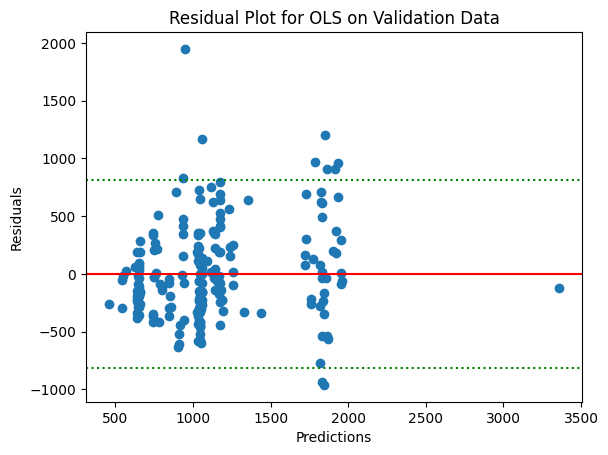

In [880]:
plt.scatter(preds_ols_val, val_residuals)
plt.axhline(y=0, color='r', linestyle='-')
plt.axhline(y=interval, color='g', linestyle=':')
plt.axhline(y=-interval, color='g', linestyle=':')
plt.title('Residual Plot for OLS on Validation Data')
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.show()

- The dotted green lines show intervals set at +- 2 * the standard error, which is a common rule of thumb for assessing model performance.
- We can see two deltas in which the model didn't make predictions: between 1500 and around 1750, then again between 2000 and around 3200. The model was quite impressive in getting close to predicting a laptop worth some nearly 3.5K.
- Residuals are predominantly positive, meaning the model was low-balling its predictions for the most part. There are only two negative residuals outside the prediction interval. This suggests we need to find ways to bias the model a little more toward predicting higher prices.
- The largest error is for a laptop worth about double at 2000euros what the model would predict at 1000euros.

Let's look at how prices are distributed in the validation set to see if there are anomalies that might affect performance.

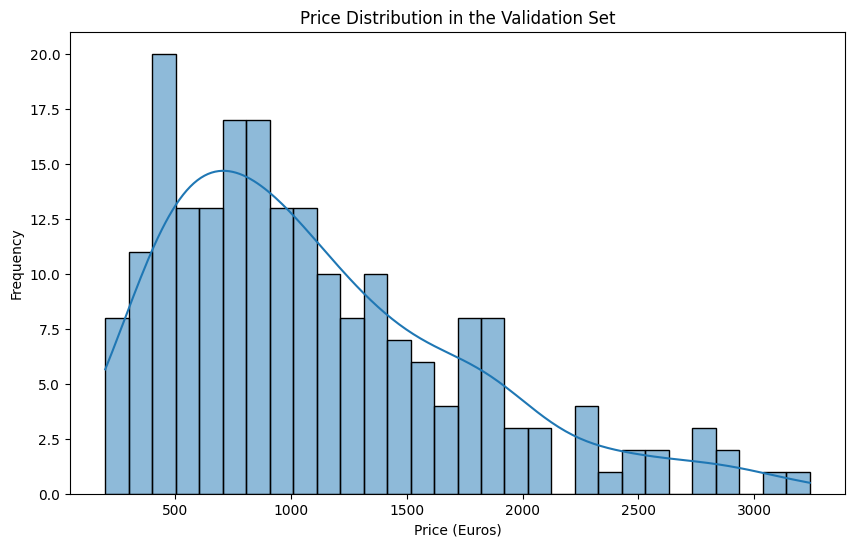

In [881]:
plt.figure(figsize=(10, 6))
sns.histplot(y_val, bins=30, kde=True)
plt.title('Price Distribution in the Validation Set')
plt.xlabel('Price (Euros)')
plt.ylabel('Frequency')
plt.show()

We can see from the histogram that the validation prices are not normally distributed, which is confirmed by the normaltest below.

In [882]:
from scipy import stats

statistic, p_value = stats.normaltest(y_val)

alpha = 0.05
if p_value < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

The data does not appear to be normally distributed: reject the Null Hypothesis


How about the training sample to which the model was fitted?

In [883]:
statistic_train, p_value_train = stats.normaltest(y_train)

alpha = 0.05
if p_value_train < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

The data does not appear to be normally distributed: reject the Null Hypothesis


Now we'll calculate what percentage of predictions fall within our prediction interval defined as +- 2 times the standard error.

In [884]:
within_interval = 0
outside_interval = 0
for resid in val_residuals:
  if abs(resid) > interval:
    outside_interval += 1
  else:
    within_interval += 1

percent_within_interval = round((within_interval / len(val_residuals)) * 100)

print(f"{percent_within_interval}% of predictions fall within the prediction interval")

95% of predictions fall within the prediction interval


Even with this simple model we get 95% of predictions falling within the prediction interval, which suggests even this basic model can be quite useful.

Let's try a log transformation of the target variable to see if it improves the performance

In [885]:
print(y_train_log.shape)
print(X_train_with_const.shape)

(828,)
(828, 4)


In [886]:
# fitting ols model, obtaining and printing results
log_ols = sm.OLS(y_train_log, X_train_with_const)
log_ols_results = log_ols.fit()
print(log_ols_results.summary(xname=['Constant'] + basic_predictors))

                            OLS Regression Results                            
Dep. Variable:        Log_Price_euros   R-squared:                       0.458
Model:                            OLS   Adj. R-squared:                  0.457
Method:                 Least Squares   F-statistic:                     232.6
Date:                Sun, 12 May 2024   Prob (F-statistic):          2.72e-109
Time:                        13:30:19   Log-Likelihood:                -521.95
No. Observations:                 828   AIC:                             1052.
Df Residuals:                     824   BIC:                             1071.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Constant       6.5250      0.064    102.743      0.0

- The R2 measure actually takes a big hit after the log transformation of nearly 8%, but this could be positive if it means the model has reduced its overfitting to the training data (we'll see when we validate)
- The kurtosis has been reduced from 6.304 to 5.651, meaning the distribution of residuals is a little more normal. However, this is still a high degree of kurtosis. Most likely even after log-transformation, the distribution of the target variable isn't normal enough for a simple OLS model.

Let's try validating this model

In [887]:
# predicting and calculating residuals
preds_ols_val_log = log_ols_results.predict(X_val_with_const)

# now we'll use the exponential function to reverse the log-transformation so that results are more directly commparable/interpretable
preds_ols_val_log = np.exp(preds_ols_val_log)
val_residuals_log = y_val - preds_ols_val_log

# Calculating error scores and printing
SSE_ols_val_log = sum(val_residuals_log**2)
print("Errors following log transformation for OLS on the validation set: ")
print("   Sum of Squared Errors: ", SSE_ols_val_log)
rmse_ols_val_log = mean_squared_error(y_val, preds_ols_val_log, squared=False)
print("   Root Mean Squared Error: ", rmse_ols_val_log)
mae_ols_val_log = mean_absolute_error(y_val, preds_ols_val_log)
print("   Mean Absolute Error: ", mae_ols_val_log)
r2_ols_val_log = r2_score(y_val, preds_ols_val_log)
print("   R-squared score: ", r2_ols_val_log)

Errors following log transformation for OLS on the validation set: 
   Sum of Squared Errors:  45822199.936042145
   Root Mean Squared Error:  469.3602434740813
   Mean Absolute Error:  322.9820039662181
   R-squared score:  0.46788708684585


- Comparing the validation results, we have actually gained SSE by ~ 9M, RMSE by ~ 64, MAE by ~ 13, and lost R2 by ~ 13%.  Clearly log-transforming the target variable did not help improve model performance. This may be because the target distribution remains non-normal even after log-transformation.

### [6.3.2] OLS2: Fitted to Larger Featureset X2

In [888]:
X2_train_with_const = sm.add_constant(X2_train_scaled)

# fitting ols model, obtaining and printing results
ols2 = sm.OLS(y_train, X2_train_with_const)
ols2_results = ols2.fit()
feature_names = ['Constant'] + list(slim_featureset)
print(ols2_results.summary(xname=feature_names))

                            OLS Regression Results                            
Dep. Variable:            Price_euros   R-squared:                       0.722
Model:                            OLS   Adj. R-squared:                  0.716
Method:                 Least Squares   F-statistic:                     116.6
Date:                Sun, 12 May 2024   Prob (F-statistic):          2.45e-210
Time:                        13:30:19   Log-Likelihood:                -6012.3
No. Observations:                 828   AIC:                         1.206e+04
Df Residuals:                     809   BIC:                         1.215e+04
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Constant              

- The R2 is over 20% higher for this second model, and there is still only a small difference between R2 and adj. R2 of 0.6. However we are starting to see the adj. R2 score exact a penalty for the number of features in the model. We would expect a higher degree of fit when including more variables.
- Some coef magnitudes are very low: TypeName_Notebook, Memory_GB, Memory_HDD and all CPU PCs expect "fast_high_end" have coefficient magnitudes below the constant. We included these mainly because we wanted to include one or more of their corresponding dummies, like "TypeName_Workstation" e.g., which did have a high coef of 917. However, we likely didn't need to include these if all the model needs to know is that the laptop is negative for some more predictive dummy variable. Most of these variables have P>|t| > 50%, meaning there's a better than even chance the null hypothesis is true that the coef=0.

Let's validate this model now

In [889]:
X2_val_with_const = sm.add_constant(X2_val_scaled)
preds_ols2_val = ols2_results.predict(X2_val_with_const)
val2_residuals = y_val - preds_ols2_val
SSE_ols2_val = sum(val2_residuals**2)
print("Sum of Squared Erors for OLS2 on the validation set: ", SSE_ols2_val)
rmse_ols2_val = mean_squared_error(y_val, preds_ols2_val, squared=False)
print("Root Mean Squared Error: ", rmse_ols2_val)
mae_ols2_val = mean_absolute_error(y_val, preds_ols2_val)
print("Mean Absolute Error: ", mae_ols2_val)
r2_ols2_val = r2_score(y_val, preds_ols2_val)
print("R-squared score: ", r2_ols2_val)

Sum of Squared Erors for OLS2 on the validation set:  24498712.744081095
Root Mean Squared Error:  343.19422024282716
Mean Absolute Error:  255.70353821260233
R-squared score:  0.7155072994099974


And compare with OLS

In [890]:
twov1_SSE = SSE_ols2_val - SSE_ols_val
twov1_rmse = rmse_ols2_val - rmse_ols_val
twov1_mae = mae_ols2_val - mae_ols_val
twov1_r2 = r2_ols2_val - r2_ols_val

print("OLS2's performance relative to OLS: ")
print("   SSE reduction: ", twov1_SSE)
print("   RMSE reduction: ", twov1_rmse)
print("   MAE reduction: ", twov1_mae)
print("   R2 gain: ", twov1_r2)

OLS2's performance relative to OLS: 
   SSE reduction:  -9780560.930444174
   RMSE reduction:  -62.76661574790552
   MAE reduction:  -53.925193689583864
   R2 gain:  0.11357732226397843


We can see that this second model performs better even with some questionable features.

### [6.3.3] OLS3: Further Feature Refinement

We'll now see how an OLS model performs if we exclude any variables with coefficient magnitudes below the constant and P>|t|=>0.5 in the previous experiment.

In [891]:
# dropping all features which had coef magnitude below constant in [7.5]
weak_coefs = ['TypeName_Notebook', 'Memory_GB', 'Cpu_efficient_high_end', 'Cpu_fast_low_end', 'Cpu_efficient_low_end', 'Cpu_AMD_mid_range', 'Memory_HDD']
slimmer_featureset = [x for x in slim_featureset if x not in weak_coefs]
slimmer_featureset

['Ram',
 'Weight',
 'Pixels',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Inches',
 'TypeName_2in1_Convertible',
 'TypeName_Gaming',
 'TypeName_Ultrabook',
 'TypeName_Workstation',
 'Memory_Flash']

In [892]:
X3_train = X_train[slimmer_featureset]
X3_val = X_val[slimmer_featureset]
X3_test = X_test[slimmer_featureset]

In [893]:
# scaling
scaler3 = MinMaxScaler()
scaler3.fit(X3_train)

X3_train_scaled = scaler3.transform(X3_train)
X3_val_scaled = scaler3.transform(X3_val)
X3_test_scaled = scaler3.transform(X3_test)

In [894]:
X3_train_with_const = sm.add_constant(X3_train_scaled)

# fitting ols model, obtaining and printing results
ols3 = sm.OLS(y_train, X3_train_with_const)
ols3_results = ols3.fit()
feature_names = ['Constant'] + list(slimmer_featureset)
print(ols3_results.summary(xname=feature_names))

                            OLS Regression Results                            
Dep. Variable:            Price_euros   R-squared:                       0.721
Model:                            OLS   Adj. R-squared:                  0.717
Method:                 Least Squares   F-statistic:                     191.8
Date:                Sun, 12 May 2024   Prob (F-statistic):          1.41e-217
Time:                        13:30:19   Log-Likelihood:                -6013.4
No. Observations:                 828   AIC:                         1.205e+04
Df Residuals:                     816   BIC:                         1.211e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Constant              

- We have only one coef below constant, which is 'Memory_Flash'. 'TypeName_Gaming' is also very close to constant coef magnitude. P>|t| is very low for all features.
- R2 is actually 0.01 lower than the X2 model but adj. is 0.01 higher. Difference between R2 and adj. might suggest slack for more features?
- The omnibus statistic means we cannot assume the residuals are normally distributed.



In [895]:
preds_ols3_train = ols3_results.predict(X3_train_with_const)
train3_residuals = y_train - preds_ols3_train
SSE_ols3_train = sum(train3_residuals**2)
print("Sum of Squared Erors for OLS3 on the training set: ", SSE_ols3_train)
rmse_ols3_train = mean_squared_error(y_train, preds_ols3_train, squared=False)
print("Root Mean Squared Error: ", rmse_ols3_train)
mae_ols3_train = mean_absolute_error(y_train, preds_ols3_train)
print("Mean Absolute Error: ", mae_ols3_train)
r2_ols3_train = r2_score(y_train, preds_ols3_train)
print("R-squared score: ", r2_ols3_train)

Sum of Squared Erors for OLS3 on the training set:  98566442.21597339
Root Mean Squared Error:  345.0240526096619
Mean Absolute Error:  258.29709840407344
R-squared score:  0.721099788702461


Validating OLS3

In [896]:
X3_val_with_const = sm.add_constant(X3_val_scaled)
preds_ols3_val = ols3_results.predict(X3_val_with_const)
val3_residuals = y_val - preds_ols3_val
SSE_ols3_val = sum(val3_residuals**2)
print("Sum of Squared Erors for OLS3 on the validation set: ", SSE_ols3_val)
rmse_ols3_val = mean_squared_error(y_val, preds_ols3_val, squared=False)
print("Root Mean Squared Error: ", rmse_ols3_val)
mae_ols3_val = mean_absolute_error(y_val, preds_ols3_val)
print("Mean Absolute Error: ", mae_ols3_val)
r2_ols3_val = r2_score(y_val, preds_ols3_val)
print("R-squared score: ", r2_ols3_val)

Sum of Squared Erors for OLS3 on the validation set:  24449731.56725383
Root Mean Squared Error:  342.85096817863604
Mean Absolute Error:  256.2721564188163
R-squared score:  0.7160760961226746


And compare with OLS2's performance

In [897]:
threev2_SSE = SSE_ols2_val - SSE_ols3_val
threev2_rmse = rmse_ols2_val - rmse_ols3_val
threev2_mae = mae_ols2_val - mae_ols3_val
threev2_r2 = r2_ols3_val - r2_ols2_val

print("OLS3's performance relative to OLS2: ")
print("   SSE reduction: ", threev2_SSE)
print("   RMSE reduction: ", threev2_rmse)
print("   MAE reduction: ", threev2_mae)
print("   R2 gain: ", threev2_r2)

OLS3's performance relative to OLS2: 
   SSE reduction:  48981.17682726309
   RMSE reduction:  0.34325206419111964
   MAE reduction:  -0.5686182062139551
   R2 gain:  0.0005687967126772886


SSE is reduced, but actually not by all that much, as can be seen in the tiny 34c reduction in RMSE and slight gain of 57c in MAE. There is a tiny R2 improvement. OLS3 is slightly sparser and therefore probably a little less biased. This suggests that between OLS2 and OLS3, there is no significant difference. Most likely adding or subtracting more features now would not much improve performance either way.

### [5.3.4] OLS Results Comparison

In [898]:
ols_results_df = pd.DataFrame({
    'Model': ['OLS', 'OLS2', 'OLS3'],
    'SSE': [SSE_ols_val, SSE_ols2_val, SSE_ols3_val],
    'RMSE': [rmse_ols_val, rmse_ols2_val, rmse_ols3_val],
    'MAE': [mae_ols_val, mae_ols2_val, mae_ols3_val],
    'R2': [r2_ols_val, r2_ols2_val, r2_ols3_val]
})
ols_by_r2 = ols_results_df.sort_values('R2', ascending=False)
ols_by_r2

,Model,SSE,RMSE,MAE,R2
2,OLS3,2.444973e+07,342.850968,256.272156,0.716076
1,OLS2,2.449871e+07,343.194220,255.703538,0.715507
0,OLS,3.427927e+07,405.960836,309.628732,0.601930


In [899]:
ols_by_rmse = ols_results_df.sort_values('RMSE')
ols_by_rmse

,Model,SSE,RMSE,MAE,R2
2,OLS3,2.444973e+07,342.850968,256.272156,0.716076
1,OLS2,2.449871e+07,343.194220,255.703538,0.715507
0,OLS,3.427927e+07,405.960836,309.628732,0.601930


In [900]:
ols_by_mae = ols_results_df.sort_values('MAE')
ols_by_mae

,Model,SSE,RMSE,MAE,R2
1,OLS2,2.449871e+07,343.194220,255.703538,0.715507
2,OLS3,2.444973e+07,342.850968,256.272156,0.716076
0,OLS,3.427927e+07,405.960836,309.628732,0.601930


- OLS3 has the best R2 score at ~ 72%, lowest RMSE at 342.85
- OLS2 has best MAE at 255.70
- OLS3 with the slightly narrower featureset is better at reducing large outlier errors whereas OLS2 is better at reducing overall error

## [6.4] Lasso (L1 Regularization)

In [901]:
from sklearn.linear_model import Lasso

### [6.4.1] Feature Engineering: X4 and X5

We'll use Lasso models first on the medium-sized featureset

In [902]:
mid_featureset

['Ram',
 'Weight',
 'TypeName_Notebook',
 'Pixels',
 'Memory_GB',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Cpu_efficient_low_end',
 'Cpu_efficient_high_end',
 'Cpu_AMD_mid_range',
 'Cpu_fast_low_end',
 'Inches',
 'TypeName_Ultrabook',
 'TypeName_Gaming',
 'IPS_display',
 'Gpu_Nvidia',
 'Memory_HDD',
 'Windows',
 'Memory_Flash',
 'OS_rank',
 'Company_Dell',
 'TypeName_Workstation',
 'Touchscreen',
 'Gpu_AMD',
 'Company_Acer',
 'Company_HP',
 'Company_Lenovo',
 'Gpu_Intel',
 'Company_Asus',
 'Company_MSI',
 'TypeName_2in1_Convertible',
 'Company_Toshiba']

In [903]:
fat_featureset

['Ram',
 'Weight',
 'TypeName_Notebook',
 'Pixels',
 'Memory_GB',
 'Memory_SSD',
 'Cpu_fast_high_end',
 'Cpu_efficient_low_end',
 'Cpu_efficient_high_end',
 'Cpu_AMD_mid_range',
 'Cpu_fast_low_end',
 'Inches',
 'TypeName_Ultrabook',
 'TypeName_Gaming',
 'IPS_display',
 'Gpu_Nvidia',
 'Memory_HDD',
 'Windows',
 'Memory_Flash',
 'OS_rank',
 'Company_Dell',
 'TypeName_Workstation',
 'Touchscreen',
 'Gpu_AMD',
 'Company_Acer',
 'Company_HP',
 'Company_Lenovo',
 'Gpu_Intel',
 'Company_Asus',
 'Company_MSI',
 'TypeName_2in1_Convertible',
 'Company_Toshiba',
 'Linux',
 'Company_Apple',
 'TypeName_Netbook',
 'Google',
 'Company_LG',
 'Memory_Hybrid',
 'Company_Microsoft',
 'Company_Samsung',
 'Company_Fujitsu',
 'Company_Vero',
 'Company_Chuwi',
 'Company_Xiaomi',
 'Company_Razer']

### [6.4.2] Modelling

In [904]:
train_results_list = []
val_results_list = []
models_list = []
alpha_list = []

In [905]:
lasso = Lasso(random_state=2)
lasso.fit(X4_train_scaled, y_train)
preds_lasso_train = lasso.predict(X4_train_scaled)
errors_lasso_train = compute_errors(y_train, preds_lasso_train, test_index="lasso_train")
train_results_list.append(errors_lasso_train)
models_list.append("Lasso")
alpha_list.append(lasso.alpha)

RMSE for lasso_train:  329.68526361658706

MAE for lasso_train:  247.18133658146755

R2 for lasso_train:  0.7453467812624639


In [906]:
preds_lasso_val = lasso.predict(X4_val_scaled)
errors_lasso_val = compute_errors(y_val, preds_lasso_val, errors_lasso_train, "lasso_train", "lasso_val")
val_results_list.append(errors_lasso_val)

RMSE for lasso_val:  334.02028062927724
lasso_train RMSE:  329.68526361658706
RMSE improvement:  -4.335017012690173
RMSE improvement relative to overall errors: % -1.29783048038976

MAE for lasso_val:  242.9460946150099
lasso_train MAE:  247.18133658146755
MAE improvement:  4.235241966457636
MAE improvement relative to overall errors: % 1.267959525834376

R2 for lasso_val:  0.7305135890072888
lasso_train R2:  0.7453467812624639
R2 improvement:  -0.014833192255175098
R2 improvement relative to overall errors: % -2.0305155822401955


The default lasso model gains some RMSE, loses some MAE and loses some R2, over its training error, but magnitudes are small, which suggests the model is not significantly under or overfitting. The results might suggest that the medium sized featureset X4 doesn't take much advantage of Regularization.

lc: default lasso model with more comprehensive featureset

In [907]:
lc = Lasso(random_state=2)
lc.fit(X5_train_scaled, y_train)
preds_lc_train = lc.predict(X5_train_scaled)
print("lc errors compared with lasso errors: ")
errors_lc_train = compute_errors(y_train, preds_lc_train, errors_lasso_train, "lasso_train", "lc_train")
train_results_list.append(errors_lc_train)
models_list.append("lc")
alpha_list.append(lc.alpha)

lc errors compared with lasso errors: 
RMSE for lc_train:  325.6068102999007
lasso_train RMSE:  329.68526361658706
RMSE improvement:  4.078453316686364
RMSE improvement relative to overall errors: % 1.2525700285353054

MAE for lc_train:  243.84449796656892
lasso_train MAE:  247.18133658146755
MAE improvement:  3.3368386148986247
MAE improvement relative to overall errors: % 1.0248061494245848

R2 for lc_train:  0.751608311898295
lasso_train R2:  0.7453467812624639
R2 improvement:  0.006261530635831125
R2 improvement relative to overall errors: % 0.8330842723142228


As expected the lasso model fitted to the larger featureset has less training error, but margins are very small

In [908]:
preds_lc_val = lc.predict(X5_val_scaled)
print("lc errors compared with training error: ")
errors_lc_val = compute_errors(y_val, preds_lc_val, errors_lc_train, "lc_train", "lc_val")
val_results_list.append(errors_lc_val)

lc errors compared with training error: 
RMSE for lc_val:  331.5385706510382
lc_train RMSE:  325.6068102999007
RMSE improvement:  -5.931760351137484
RMSE improvement relative to overall errors: % -1.789161466036775

MAE for lc_val:  240.59663532949884
lc_train MAE:  243.84449796656892
MAE improvement:  3.247862637070085
MAE improvement relative to overall errors: % 0.9796334196326834

R2 for lc_val:  0.7345031828759426
lc_train R2:  0.751608311898295
R2 improvement:  -0.017105129022352394
R2 improvement relative to overall errors: % -2.328802573104907


The results here are very similar to the lasso model in terms of under/over fitting.

comprehensive lasso with a stronger penalty

In [909]:
lc2 = Lasso(alpha=2.0, random_state=2)
lc2.fit(X5_train_scaled, y_train)
preds_lc2_train = lc2.predict(X5_train_scaled)
errors_lc2_train = compute_errors(y_train, preds_lc2_train, errors_lc_train, "lc_train", "lc2_train")
train_results_list.append(errors_lc2_train)
models_list.append("LC2")
alpha_list.append(lc2.alpha)

RMSE for lc2_train:  332.96462999398466
lc_train RMSE:  325.6068102999007
RMSE improvement:  -7.3578196940839575
RMSE improvement relative to overall errors: % -2.2097901792802688

MAE for lc2_train:  249.15512447725555
lc_train MAE:  243.84449796656892
MAE improvement:  -5.310626510686632
MAE improvement relative to overall errors: % -1.5949521457527105

R2 for lc2_train:  0.7402555342126911
lc_train R2:  0.751608311898295
R2 improvement:  -0.011352777685603943
R2 improvement relative to overall errors: % -1.5336295591060114


LC2 performs slightly worse than LC on training, as expected.

In [910]:
preds_lc2_val = lc2.predict(X5_val_scaled)
errors_lc2_val = compute_errors(y_val, preds_lc2_val, errors_lc_val, "lc_val", "lc2_val")
val_results_list.append(errors_lc2_val)

RMSE for lc2_val:  334.53142119011915
lc_val RMSE:  331.5385706510382
RMSE improvement:  -2.992850539080962
RMSE improvement relative to overall errors: % -0.8946395912329206

MAE for lc2_val:  243.71035076525774
lc_val MAE:  240.59663532949884
MAE improvement:  -3.1137154357589054
MAE improvement relative to overall errors: % -0.9307692008964786

R2 for lc2_val:  0.7296881850604797
lc_val R2:  0.7345031828759426
R2 improvement:  -0.004814997815462907
R2 improvement relative to overall errors: % -0.6598706014492778


LC2 performs 17% better for RMSE than LC on validation, and 3% better for MAE, but loses 4% R2.

let's compare LC2 now when predicting the log-transformed target

In [911]:
lc2_log = Lasso(alpha=2.0, random_state=2)
lc2_log.fit(X5_train_scaled, y_train_log)
preds_lc2_log_train = np.exp(lc2_log.predict(X5_train_scaled))
print("LC2 training results when fitted to log-y compared with raw y (X5 featureset): ")
print("")
errors_lc2_log_train = compute_errors(y_train, preds_lc2_train, errors_lc2_train, "lc2_train", "lc2_log_train")
train_results_list.append(errors_lc2_log_train)
models_list.append("LC2_log")
alpha_list.append(lc2_log.alpha)

LC2 training results when fitted to log-y compared with raw y (X5 featureset): 

RMSE for lc2_log_train:  332.96462999398466
lc2_train RMSE:  332.96462999398466
RMSE improvement:  0.0
RMSE improvement relative to overall errors: % 0.0

MAE for lc2_log_train:  249.15512447725555
lc2_train MAE:  249.15512447725555
MAE improvement:  0.0
MAE improvement relative to overall errors: % 0.0

R2 for lc2_log_train:  0.7402555342126911
lc2_train R2:  0.7402555342126911
R2 improvement:  0.0
R2 improvement relative to overall errors: % 0.0


Results are identical after log-transformation

In [912]:
preds_lc2_log_val = np.exp(lc2_log.predict(X5_val_scaled))
errors_lc2_log_val = compute_errors(y_val, preds_lc2_log_val, errors_lc2_val, "lc2_val", "lc2_log_val")
val_results_list.append(errors_lc2_log_val)

RMSE for lc2_log_val:  670.2862906268036
lc2_val RMSE:  334.53142119011915
RMSE improvement:  -335.7548694366845
RMSE improvement relative to overall errors: % -50.09126311127602

MAE for lc2_log_val:  500.15909364443934
lc2_val MAE:  243.71035076525774
MAE improvement:  -256.4487428791816
MAE improvement relative to overall errors: % -38.25958347430456

R2 for lc2_log_val:  -0.08520521247024027
lc2_val R2:  0.7296881850604797
R2 improvement:  -0.81489339753072
R2 improvement relative to overall errors: % 956.3891385346159


In [913]:
preds_lc2_log_val = lc2_log.predict(X5_val_scaled)
errors_lc2_log_val = compute_errors(y_val_log, preds_lc2_log_val, errors_lc2_val, "lc2_val", "lc2_log_val")
val_results_list.append(errors_lc2_log_val)

RMSE for lc2_log_val:  0.5921505220086247
lc2_val RMSE:  334.53142119011915
RMSE improvement:  333.9392706681105
RMSE improvement relative to overall errors: % 56394.32175713706

MAE for lc2_log_val:  0.4884200316966705
lc2_val MAE:  243.71035076525774
MAE improvement:  243.22193073356107
MAE improvement relative to overall errors: % 41074.342028532155

R2 for lc2_log_val:  -0.0008883259415792821
lc2_val R2:  0.7296881850604797
R2 improvement:  -0.730576511002059
R2 improvement relative to overall errors: % 82241.94260309754


In [914]:
errors_lc2_val

{'rmse_lc2_val': 334.53142119011915,
 'mae_lc2_val': 243.71035076525774,
 'r2_lc2_val': 0.7296881850604797}

In [915]:
errors_lc2_log_val


{'rmse_lc2_log_val': 0.5921505220086247,
 'mae_lc2_log_val': 0.4884200316966705,
 'r2_lc2_log_val': -0.0008883259415792821}

In [916]:
for key, value in errors_lc2_log_val.items():
  print(key)
  print("   ", np.exp(value))


rmse_lc2_log_val
    1.8078721066734988
mae_lc2_log_val
    1.6297392483696254
r2_lc2_log_val
    0.9991120685031029


compare when fitted to X4

In [917]:
lc2_X4 = Lasso(alpha=2.0, random_state=2)
lc2_X4.fit(X4_train_scaled, y_train_log)
preds_lc2_X4_train = np.exp(lc2_X4.predict(X4_train_scaled))
errors_lc2_X4_train = compute_errors(y_train, preds_lc2_X4_train, errors_lc2_log_train, "lc2_log_train", "lc2_X4_train")
train_results_list.append(errors_lc2_X4_train)
models_list.append("LC2_X4")
alpha_list.append(lc2_X4.alpha)

RMSE for lc2_X4_train:  677.9267507630882
lc2_log_train RMSE:  332.96462999398466
RMSE improvement:  -344.96212076910354
RMSE improvement relative to overall errors: % -50.88486630462762

MAE for lc2_X4_train:  510.5681127901171
lc2_log_train MAE:  249.15512447725555
MAE improvement:  -261.41298831286156
MAE improvement relative to overall errors: % -38.560653937701936

R2 for lc2_X4_train:  -0.07675188803040234
lc2_log_train R2:  0.7402555342126911
R2 improvement:  -0.8170074222430934
R2 improvement relative to overall errors: % 1064.4785987798332


Big gains in training error which is to be expected, but training R2 is unacceptably low; the model now explains less variance than simply predicting the mean price.

In [918]:
preds_lc2_X4_val = np.exp(lc2_X4.predict(X4_val_scaled))
errors_lc2_X4_val = compute_errors(y_val, preds_lc2_X4_val, errors_lc2_val, "lc2_val", "lc2_X4_val")
val_results_list.append(errors_lc2_X4_val)

RMSE for lc2_X4_val:  670.2862906268036
lc2_val RMSE:  334.53142119011915
RMSE improvement:  -335.7548694366845
RMSE improvement relative to overall errors: % -50.09126311127602

MAE for lc2_X4_val:  500.15909364443934
lc2_val MAE:  243.71035076525774
MAE improvement:  -256.4487428791816
MAE improvement relative to overall errors: % -38.25958347430456

R2 for lc2_X4_val:  -0.08520521247024027
lc2_val R2:  0.7296881850604797
R2 improvement:  -0.81489339753072
R2 improvement relative to overall errors: % 956.3891385346159


Trying LC with alpha=5

In [919]:
lc5 = Lasso(alpha=5.0, random_state=2)
lc5.fit(X5_train_scaled, y_train)
preds_lc5_train = lc5.predict(X5_train_scaled)
print("Training Results")
print("")
errors_lc5_train = compute_errors(y_train, preds_lc5_train, errors_lc2_train, "lc2_train", "lc5_train")
train_results_list.append(errors_lc5_train)
models_list.append("lc5")
alpha_list.append(lc5.alpha)
print("")
print("Validation Results")
print("")
preds_lc5_val = lc5.predict(X5_val_scaled)
errors_lc5_val = compute_errors(y_val, preds_lc5_val, errors_lc2_val, "lc2_val", "lc5_val")
val_results_list.append(errors_lc5_val)

Training Results

RMSE for lc5_train:  346.63067893998226
lc2_train RMSE:  332.96462999398466
RMSE improvement:  -13.666048945997602
RMSE improvement relative to overall errors: % -3.9425387815611743

MAE for lc5_train:  261.3670421856135
lc2_train MAE:  249.15512447725555
MAE improvement:  -12.211917708357959
MAE improvement relative to overall errors: % -3.5230342985516305

R2 for lc5_train:  0.7184963081876891
lc2_train R2:  0.7402555342126911
R2 improvement:  -0.02175922602500202
R2 improvement relative to overall errors: % -3.0284395030347144

Validation Results

RMSE for lc5_val:  348.5595649503012
lc2_val RMSE:  334.53142119011915
RMSE improvement:  -14.028143760182047
RMSE improvement relative to overall errors: % -4.024604449509864

MAE for lc5_val:  255.73936381533574
lc2_val MAE:  243.71035076525774
MAE improvement:  -12.029013050077992
MAE improvement relative to overall errors: % -3.4510638237091933

R2 for lc5_val:  0.7065425042438542
lc2_val R2:  0.7296881850604797
R2 im

On validation lc5 loses performance over lc2, except for an improvement in R2.

Trying Gridsearch to determine an optimal alpha between 2 and 5

In [920]:
from sklearn.model_selection import GridSearchCV

In [921]:
alpha_grid = {'alpha': np.arange(0, 5, 0.1)}

In [922]:
l = Lasso(random_state=2)

In [923]:
lc_rmse_opt = GridSearchCV(l, alpha_grid, scoring='neg_root_mean_squared_error', verbose=1)

In [924]:
lc_rmse_opt.fit(X5_train_scaled, y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.098e+07, tolerance: 2.832e+04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.e

GridSearchCV(estimator=Lasso(random_state=2),
             param_grid={'alpha': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
       1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2, 2.3, 2.4, 2.5,
       2.6, 2.7, 2.8, 2.9, 3. , 3.1, 3.2, 3.3, 3.4, 3.5, 3.6, 3.7, 3.8,
       3.9, 4. , 4.1, 4.2, 4.3, 4.4, 4.5, 4.6, 4.7, 4.8, 4.9])},
             scoring='neg_root_mean_squared_error', verbose=1)

In [925]:
lc_rmse_opt.best_params_

{'alpha': 0.30000000000000004}

In [926]:
lc_mae_opt = GridSearchCV(l, alpha_grid, scoring='neg_mean_absolute_error', verbose=1)
lc_mae_opt.fit(X5_train_scaled, y_train)
lc_mae_opt.best_params_

Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.098e+07, tolerance: 2.832e+04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.e

{'alpha': 0.2}

In [927]:
lc_r2_opt = GridSearchCV(l, alpha_grid, scoring='r2', verbose=1)
lc_r2_opt.fit(X5_train_scaled, y_train)
lc_r2_opt.best_params_

Fitting 5 folds for each of 50 candidates, totalling 250 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.098e+07, tolerance: 2.832e+04 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.e

{'alpha': 0.30000000000000004}

gs finds 0.3 as best value for alpha

In [928]:
lc_gs = Lasso(alpha=0.3, random_state=2)
lc_gs.fit(X5_train_scaled, y_train)
preds_lc_gs_train = lc_gs.predict(X5_train_scaled)
print("Training Results")
print("")
errors_lc_gs_train = compute_errors(y_train, preds_lc_gs_train, errors_lc2_train, "lc2_train", "lc_gs_train")
train_results_list.append(errors_lc_gs_train)
models_list.append("lc_gs")
alpha_list.append(lc_gs.alpha)
print("")
print("Validation Results")
print("")
preds_lc_gs_val = lc_gs.predict(X5_val_scaled)
errors_lc_gs_val = compute_errors(y_val, preds_lc_gs_val, errors_lc2_val, "lc2_val", "lc_gs_val")
val_results_list.append(errors_lc_gs_val)

Training Results

RMSE for lc_gs_train:  317.02262377916867
lc2_train RMSE:  332.96462999398466
RMSE improvement:  15.94200621481599
RMSE improvement relative to overall errors: % 5.028665154800074

MAE for lc_gs_train:  236.04616743717304
lc2_train MAE:  249.15512447725555
MAE improvement:  13.108957040082515
MAE improvement relative to overall errors: % 4.135022568362168

R2 for lc_gs_train:  0.7645326960561505
lc2_train R2:  0.7402555342126911
R2 improvement:  0.024277161843459405
R2 improvement relative to overall errors: % 3.1754249319477617

Validation Results

RMSE for lc_gs_val:  344.6709162995447
lc2_val RMSE:  334.53142119011915
RMSE improvement:  -10.139495109425525
RMSE improvement relative to overall errors: % -2.9417901627109

MAE for lc_gs_val:  243.59441946404667
lc2_val MAE:  243.71035076525774
MAE improvement:  0.1159313012110772
MAE improvement relative to overall errors: % 0.03363535933224034

R2 for lc_gs_val:  0.7130538019598016
lc2_val R2:  0.7296881850604797
R2 

lc_gs has lower training error than lc2 but greater validation error, suggesting overfitting.

## [6.5] Ridge (L2 Regularization)

In [929]:
from sklearn.linear_model import Ridge

with the middle-sized featureset X4

In [930]:
ridge = Ridge(random_state=2)
ridge.fit(X4_train_scaled, y_train)
preds_ridge_train = ridge.predict(X4_train_scaled)
print("Ridge Training errors")
print("")
errors_ridge_train = compute_errors(y_train, preds_ridge_train, errors_lasso_train, "lasso_train", "ridge_train")
models_list.append("ridge")
alpha_list.append(ridge.alpha)
train_results_list.append(errors_ridge_train)
print("Ridge Validation errors compared to training errors")
print("")
preds_ridge_val = ridge.predict(X4_val_scaled)
errors_ridge_val = compute_errors(y_val, preds_ridge_val, errors_ridge_train, "ridge_train", "ridge_val")
val_results_list.append(errors_ridge_val)
print("")
print("Ridge validation errors compared to Lasso validation errors")
print("")
compute_errors(y_val, preds_ridge_val, errors_lasso_val, "lasso_val", "ridge_val")


Ridge Training errors

RMSE for ridge_train:  332.551333236852
lasso_train RMSE:  329.68526361658706
RMSE improvement:  -2.866069620264909
RMSE improvement relative to overall errors: % -0.8618427694660955

MAE for ridge_train:  251.00827164655402
lasso_train MAE:  247.18133658146755
MAE improvement:  -3.8269350650864737
MAE improvement relative to overall errors: % -1.150780250326294

R2 for ridge_train:  0.7408999565324503
lasso_train R2:  0.7453467812624639
R2 improvement:  -0.0044468247300135655
R2 improvement relative to overall errors: % -0.6001923324203625
Ridge Validation errors compared to training errors

RMSE for ridge_val:  342.5859052606384
ridge_train RMSE:  332.551333236852
RMSE improvement:  -10.034572023786438
RMSE improvement relative to overall errors: % -2.9290673870987667

MAE for ridge_val:  250.4010315684695
ridge_train MAE:  251.00827164655402
MAE improvement:  0.6072400780845157
MAE improvement relative to overall errors: % 0.17725191514301478

R2 for ridge_val

{'rmse_ridge_val': 342.5859052606384,
 'mae_ridge_val': 250.4010315684695,
 'r2_ridge_val': 0.7165149375671467}

- Ridge training errors very similar to Lasso's
- Ridge improves over its training error on validation
- Ridge validation error very similar to Lasso validation errors

With the comprehensive featureset X2

In [931]:
rc = Ridge(random_state=2)
rc.fit(X5_train_scaled, y_train)
preds_rc_train = rc.predict(X5_train_scaled)
print("RC training Errors compared to LC training errors")
print("")
errors_rc_train = compute_errors(y_train, preds_rc_train, errors_lc_train, "lc_train", "rc_train")
train_results_list.append(errors_rc_train)
models_list.append("RC")
alpha_list.append(rc.alpha)
print("")
preds_rc_val = rc.predict(X5_val_scaled)
print("RC validation errors compared to training errors")
print("")
errors_rc_val = compute_errors(y_val, preds_rc_val, errors_rc_train, "rc_train", "rc_val")
val_results_list.append(errors_rc_val)
print("")
print("RC valiation errors compared to LC validation errors")
print("")
compute_errors(y_val, preds_rc_val, errors_lc_val, "lc_val", "rc_val")
print("")
print("RC validation error (comprehensive featureset) against Ridge validation error (restricted featureset)")
print("")
compute_errors(y_val, preds_rc_val, errors_ridge_val, "ridge_val", "rc_val")


RC training Errors compared to LC training errors

RMSE for rc_train:  323.28103779321776
lc_train RMSE:  325.6068102999007
RMSE improvement:  2.325772506682938
RMSE improvement relative to overall errors: % 0.7194274438609624

MAE for rc_train:  242.3440935601353
lc_train MAE:  243.84449796656892
MAE improvement:  1.5004044064336313
MAE improvement relative to overall errors: % 0.4641176657547555

R2 for rc_train:  0.7551441060459975
lc_train R2:  0.751608311898295
R2 improvement:  0.0035357941477024424
R2 improvement relative to overall errors: % 0.4682277355266902

RC validation errors compared to training errors

RMSE for rc_val:  350.3751464699187
rc_train RMSE:  323.28103779321776
RMSE improvement:  -27.094108676700955
RMSE improvement relative to overall errors: % -7.732885437131627

MAE for rc_val:  252.18924731781772
rc_train MAE:  242.3440935601353
MAE improvement:  -9.845153757682425
MAE improvement relative to overall errors: % -2.8098893020449087

R2 for rc_val:  0.7034774

{'rmse_rc_val': 350.3751464699187,
 'mae_rc_val': 252.18924731781772,
 'r2_rc_val': 0.7034774119203113}

Model overfits a bit, and doesn't perform as well as LC or R2 (narrower featureset)

- RC improves slightly over LC on training RMSE and MAE, but loses some R2.
- RC improves over its training errors on validation
- RC improves over LC on validation RMSE and MAE quite significantly, but loses R2 by ~ 6%
- RC improves over Ridge (restricted featureset) on RMSE and MAE validation but loses R2.

Trying Ridge with alpha=2 (best alpha value for LC models)

In [932]:
rc2 = Ridge(alpha=2.0, random_state=2)
rc2.fit(X5_train_scaled, y_train)
preds_rc2_train = rc2.predict(X5_train_scaled)
print("RC2 training Errors compared to LC2 training errors")
print("")
errors_rc2_train = compute_errors(y_train, preds_rc2_train, errors_lc2_train, "lc2_train", "rc2_train")
train_results_list.append(errors_rc2_train)
models_list.append("RC2")
alpha_list.append(rc2.alpha)
print("")
preds_rc2_val = rc2.predict(X5_val_scaled)
print("RC2 validation errors compared to training errors")
print("")
errors_rc2_val = compute_errors(y_val, preds_rc2_val, errors_rc2_train, "rc2_train", "rc2_val")
val_results_list.append(errors_rc2_val)
print("")
print("RC2 validation errors compared to LC2 validation errors")
print("")
compute_errors(y_val, preds_rc2_val, errors_lc2_val, "lc2_val", "rc2_val")
print("")
print("RC2 validation errors compared to RC validation errors")
print("")
compute_errors(y_val, preds_rc2_val, errors_rc_val, "rc_val", "rc2_val")

RC2 training Errors compared to LC2 training errors

RMSE for rc2_train:  332.7601142864481
lc2_train RMSE:  332.96462999398466
RMSE improvement:  0.20451570753658643
RMSE improvement relative to overall errors: % 0.061460403082003484

MAE for rc2_train:  251.05723338287436
lc2_train MAE:  249.15512447725555
MAE improvement:  -1.9021089056188032
MAE improvement relative to overall errors: % -0.5716156546278324

R2 for rc2_train:  0.740574520098872
lc2_train R2:  0.7402555342126911
R2 improvement:  0.0003189858861809558
R2 improvement relative to overall errors: % 0.04307276006989397

RC2 validation errors compared to training errors

RMSE for rc2_val:  353.638556582131
rc2_train RMSE:  332.7601142864481
RMSE improvement:  -20.87844229568293
RMSE improvement relative to overall errors: % -5.903893087187738

MAE for rc2_val:  257.64492184676277
rc2_train MAE:  251.05723338287436
MAE improvement:  -6.587688463888412
MAE improvement relative to overall errors: % -1.86283094455467

R2 for r

{'rmse_rc2_val': 353.638556582131,
 'mae_rc2_val': 257.64492184676277,
 'r2_rc2_val': 0.697928038307903}

- RC2 has lower training error than LC2 except for R2
- RC2 reduces errors on validation relative to training quite significantly
- RC2 performs slightly better than LC2 on validation
- RC2 has slightly lower RMSE and MAE on validation than RC, but very slightly worse R2.

rc3 with alpha=3

In [933]:
rc3 = Ridge(alpha=3.0, random_state=2)
rc3.fit(X5_train_scaled, y_train)
preds_rc3_train = rc3.predict(X5_train_scaled)
print("rc3 training Errors compared to rc2 training errors")
print("")
errors_rc3_train = compute_errors(y_train, preds_rc3_train, errors_rc2_train, "rc2_train", "rc3_train")
train_results_list.append(errors_rc3_train)
models_list.append("rc3")
alpha_list.append(rc3.alpha)
print("")
preds_rc3_val = rc3.predict(X5_val_scaled)
print("rc3 validation errors compared to training errors")
print("")
errors_rc3_val = compute_errors(y_val, preds_rc3_val, errors_rc3_train, "rc3_train", "rc3_val")
val_results_list.append(errors_rc3_val)
print("")
print("rc3 validation errors compared to rc2 validation errors")
print("")
compute_errors(y_val, preds_rc3_val, errors_rc2_val, "rc2_val", "rc3_val")

rc3 training Errors compared to rc2 training errors

RMSE for rc3_train:  340.7308029755312
rc2_train RMSE:  332.7601142864481
RMSE improvement:  -7.970688689083147
RMSE improvement relative to overall errors: % -2.339292080280615

MAE for rc3_train:  257.80179701864995
rc2_train MAE:  251.05723338287436
MAE improvement:  -6.744563635775592
MAE improvement relative to overall errors: % -1.979440536892092

R2 for rc3_train:  0.7279975018913494
rc2_train R2:  0.740574520098872
R2 improvement:  -0.012577018207522661
R2 improvement relative to overall errors: % -1.7276183194100754

rc3 validation errors compared to training errors

RMSE for rc3_val:  358.1101650083196
rc3_train RMSE:  340.7308029755312
RMSE improvement:  -17.37936203278838
RMSE improvement relative to overall errors: % -4.853076994445165

MAE for rc3_val:  262.78950574214065
rc3_train MAE:  257.80179701864995
MAE improvement:  -4.987708723490698
MAE improvement relative to overall errors: % -1.392786134226272

R2 for rc3_v

{'rmse_rc3_val': 358.1101650083196,
 'mae_rc3_val': 262.78950574214065,
 'r2_rc3_val': 0.690240599726554}

rc3 performs slightly worse than rc2 but slightly better than rc5. alpha=3 is too high.

rc4 with alpha=0.5

In [934]:
rc4 = Ridge(alpha=0.5, random_state=2)
rc4.fit(X5_train_scaled, y_train)
preds_rc4_train = rc4.predict(X5_train_scaled)
print("rc4 training errors compared to rc training errors")
print("")
errors_rc4_train = compute_errors(y_train, preds_rc4_train, errors_rc_train, "rc_train", "rc4_train")
train_results_list.append(errors_rc4_train)
models_list.append("rc4")
alpha_list.append(rc4.alpha)
print("")
preds_rc4_val = rc4.predict(X5_val_scaled)
print("rc4 validation errors compared to training errors")
print("")
errors_rc4_val = compute_errors(y_val, preds_rc4_val, errors_rc4_train, "rc4_train", "rc4_val")
val_results_list.append(errors_rc4_val)
print("")
print("rc4 validation errors compared to RC validation errors")
print("")
compute_errors(y_val, preds_rc4_val, errors_rc_val, "rc_val", "rc4_val")
print("")
print("rc4 validation errors compared to RC2 validation errors")
print("")
compute_errors(y_val, preds_rc4_val, errors_rc2_val, "rc2_val", "rc4_val")

rc4 training errors compared to rc training errors

RMSE for rc4_train:  318.51962485707213
rc_train RMSE:  323.28103779321776
RMSE improvement:  4.761412936145632
RMSE improvement relative to overall errors: % 1.4948570086638144

MAE for rc4_train:  237.84829193141238
rc_train MAE:  242.3440935601353
MAE improvement:  4.495801628722916
MAE improvement relative to overall errors: % 1.4114677017908381

R2 for rc4_train:  0.762303662335457
rc_train R2:  0.7551441060459975
R2 improvement:  0.007159556289459523
R2 improvement relative to overall errors: % 0.9392000384105346

rc4 validation errors compared to training errors

RMSE for rc4_val:  351.3317975944664
rc4_train RMSE:  318.51962485707213
RMSE improvement:  -32.81217273739429
RMSE improvement relative to overall errors: % -9.33936892762225

MAE for rc4_val:  249.3122149222977
rc4_train MAE:  237.84829193141238
MAE improvement:  -11.463922990885322
MAE improvement relative to overall errors: % -3.2629904464604835

R2 for rc4_val:  0

{'rmse_rc4_val': 351.3317975944664,
 'mae_rc4_val': 249.3122149222977,
 'r2_rc4_val': 0.7018559731320109}

performs about the same as RC, more overfitting

RC5 with alpha=5.0

In [935]:
rc5 = Ridge(alpha=5.0, random_state=2)
rc5.fit(X5_train_scaled, y_train)
preds_rc5_train = rc5.predict(X5_train_scaled)
print("RC5 training Errors compared to LC5 training errors")
print("")
errors_rc5_train = compute_errors(y_train, preds_rc5_train, errors_lc5_train, "lc5_train", "rc5_train")
train_results_list.append(errors_rc5_train)
models_list.append("RC5")
alpha_list.append(rc5.alpha)
print("")
preds_rc5_val = rc5.predict(X5_val_scaled)
print("RC5 validation errors compared to training errors")
print("")
errors_rc5_val = compute_errors(y_val, preds_rc5_val, errors_rc5_train, "rc5_train", "rc5_val")
val_results_list.append(errors_rc5_val)
print("")
print("RC5 validation errors compared to LC5 validation errors")
print("")
compute_errors(y_val, preds_rc5_val, errors_lc5_val, "lc5_val", "rc5_val")
print("")
print("RC5 validation errors compared to RC2 validation errors")
print("")
compute_errors(y_val, preds_rc5_val, errors_rc2_val, "rc2_val", "rc5_val")

RC5 training Errors compared to LC5 training errors

RMSE for rc5_train:  352.88113305393995
lc5_train RMSE:  346.63067893998226
RMSE improvement:  -6.250454113957687
RMSE improvement relative to overall errors: % -1.7712633316109505

MAE for rc5_train:  267.3720595266179
lc5_train MAE:  261.3670421856135
MAE improvement:  -6.005017341004361
MAE improvement relative to overall errors: % -1.7017110801688735

R2 for rc5_train:  0.7082526112116957
lc5_train R2:  0.7184963081876891
R2 improvement:  -0.010243696975993366
R2 improvement relative to overall errors: % -1.4463338099761045

RC5 validation errors compared to training errors

RMSE for rc5_val:  366.4101636288715
rc5_train RMSE:  352.88113305393995
RMSE improvement:  -13.52903057493154
RMSE improvement relative to overall errors: % -3.692318586619444

MAE for rc5_val:  270.33908738406785
rc5_train MAE:  267.3720595266179
MAE improvement:  -2.9670278574499775
MAE improvement relative to overall errors: % -0.80975588342446

R2 for rc

{'rmse_rc5_val': 366.4101636288715,
 'mae_rc5_val': 270.33908738406785,
 'r2_rc5_val': 0.675715477585776}

- RC5 gains some RMSE and MAE over RC2 on validation but improves R2 slightly.
- RC5 performs better than LC5 on RMSE and MAE but not o

Using GridSearch to determine an optimal value for alpha with Ridge models

In [936]:
from sklearn.model_selection import GridSearchCV

r = Ridge(random_state=2)

alpha_grid = {'alpha': np.arange(1, 3, 0.1)}

ridge_rmse_opt = GridSearchCV(r, alpha_grid, scoring='neg_root_mean_squared_error', verbose=1)
ridge_rmse_opt.fit(X_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


GridSearchCV(estimator=Ridge(random_state=2),
             param_grid={'alpha': array([1. , 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2,
       2.3, 2.4, 2.5, 2.6, 2.7, 2.8, 2.9])},
             scoring='neg_root_mean_squared_error', verbose=1)

In [937]:
ridge_rmse_opt.best_params_

{'alpha': 1.0}

Optimizing alpha for MAE

In [938]:
ridge_mae_opt = GridSearchCV(r, alpha_grid, scoring='neg_mean_absolute_error', verbose=1)
ridge_mae_opt.fit(X_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


GridSearchCV(estimator=Ridge(random_state=2),
             param_grid={'alpha': array([1. , 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2,
       2.3, 2.4, 2.5, 2.6, 2.7, 2.8, 2.9])},
             scoring='neg_mean_absolute_error', verbose=1)

In [939]:
ridge_mae_opt.best_params_

{'alpha': 1.0}

In [940]:
ridge_r2_opt = GridSearchCV(r, alpha_grid, scoring='r2', verbose=1)
ridge_r2_opt.fit(X_train, y_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


GridSearchCV(estimator=Ridge(random_state=2),
             param_grid={'alpha': array([1. , 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2,
       2.3, 2.4, 2.5, 2.6, 2.7, 2.8, 2.9])},
             scoring='r2', verbose=1)

In [941]:
ridge_r2_opt.best_params_

{'alpha': 1.0}

Most likely 2 is as good a value as any for alpha if we want to balance RMSE, MAE and R2

## [6.6] ElasticNet (L1:L2 Regularization)

In [942]:
from sklearn.linear_model import ElasticNet

In [943]:
EN = ElasticNet(random_state=2)
EN.fit(X2_train, y_train)
preds_EN_train = EN.predict(X2_train)
errors_EN_train = compute_errors(y_train, preds_EN_train, errors_rc_train, "rc_train", "EN_train")

RMSE for EN_train:  385.63558520946606
rc_train RMSE:  323.28103779321776
RMSE improvement:  -62.354547416248295
RMSE improvement relative to overall errors: % -16.16929293036562

MAE for EN_train:  293.90049364631165
rc_train MAE:  242.3440935601353
MAE improvement:  -51.55640008617635
MAE improvement relative to overall errors: % -13.369201926262175

R2 for EN_train:  0.6515790151699433
rc_train R2:  0.7551441060459975
R2 improvement:  -0.10356509087605414
R2 improvement relative to overall errors: % -15.89447917518377


EN does way worse than RC on training data; much more biased and much worse at explaining variance.

In [944]:
# validation
preds_EN_val = EN.predict(X2_val)
print("EN validation results compared with RC validation results: ")
print("")
errors_EN_val = compute_errors(y_val, preds_EN_val, errors_rc_val, "rc_val", "EN_val")

EN validation results compared with RC validation results: 

RMSE for EN_val:  378.03321755927385
rc_val RMSE:  350.3751464699187
RMSE improvement:  -27.658071089355133
RMSE improvement relative to overall errors: % -7.316307087489865

MAE for EN_val:  283.5284959164428
rc_val MAE:  252.18924731781772
MAE improvement:  -31.33924859862509
MAE improvement relative to overall errors: % -8.290077999220067

R2 for EN_val:  0.6548156297931397
rc_val R2:  0.7034774119203113
R2 improvement:  -0.04866178212717165
R2 improvement relative to overall errors: % -7.4313715056777445


compared with the default lasso model LC

In [945]:
print("EN validation results compared with LC validation results: ")
print("")
compute_errors(y_val, preds_EN_val, errors_lc_val, "lc_val", "EN_val")

EN validation results compared with LC validation results: 

RMSE for EN_val:  378.03321755927385
lc_val RMSE:  331.5385706510382
RMSE improvement:  -46.494646908235666
RMSE improvement relative to overall errors: % -12.299090330850495

MAE for EN_val:  283.5284959164428
lc_val MAE:  240.59663532949884
MAE improvement:  -42.93186058694397
MAE improvement relative to overall errors: % -11.356637087113238

R2 for EN_val:  0.6548156297931397
lc_val R2:  0.7345031828759426
R2 improvement:  -0.07968755308280295
R2 improvement relative to overall errors: % -12.169464114345704


{'rmse_EN_val': 378.03321755927385,
 'mae_EN_val': 283.5284959164428,
 'r2_EN_val': 0.6548156297931397}

also much worse than LC - not sure what to make of this!

trying alpha=2

In [946]:
EN2 = ElasticNet(alpha=2.0, random_state=2)
EN2.fit(X5_train_scaled, y_train)
preds_EN2_train = EN2.predict(X5_train_scaled)
print("EN2 training results compared with EN's: ")
print("")
errors_EN2_train = compute_errors(y_train, preds_EN2_train, errors_EN_train, "EN_train", "EN2_train")
print("")
preds_EN2_val = EN2.predict(X5_val_scaled)
print("EN2 validation results compared with RC2 validation results: ")
print("")
errors_EN2_val = compute_errors(y_val, preds_EN2_val, errors_rc2_val, "rc2_val", "EN2_val")
print("")
print("EN validation results compared with LC validation results: ")
print("")
compute_errors(y_val, preds_EN2_val, errors_lc2_val, "lc2_val", "EN2_val")

EN2 training results compared with EN's: 

RMSE for EN2_train:  548.3529479921668
EN_train RMSE:  385.63558520946606
RMSE improvement:  -162.71736278270077
RMSE improvement relative to overall errors: % -29.673837512591465

MAE for EN2_train:  428.9901903103101
EN_train MAE:  293.90049364631165
MAE improvement:  -135.08969666399844
MAE improvement relative to overall errors: % -24.635537596476674

R2 for EN2_train:  0.2955170861046893
EN_train R2:  0.6515790151699433
R2 improvement:  -0.356061929065254
R2 improvement relative to overall errors: % -120.48776392547273

EN2 validation results compared with RC2 validation results: 

RMSE for EN2_val:  544.4333968042702
rc2_val RMSE:  353.638556582131
RMSE improvement:  -190.79484022213916
RMSE improvement relative to overall errors: % -35.04466135657215

MAE for EN2_val:  427.86379643444036
rc2_val MAE:  257.64492184676277
MAE improvement:  -170.2188745876776
MAE improvement relative to overall errors: % -31.26532567377992

R2 for EN2_val:

{'rmse_EN2_val': 544.4333968042702,
 'mae_EN2_val': 427.86379643444036,
 'r2_EN2_val': 0.2840532642162743}

worse on every measure!

trying alpha=0.5

In [947]:
EN3 = ElasticNet(alpha=0.5, random_state=2)
EN3.fit(X5_train_scaled, y_train)
preds_EN3_train = EN3.predict(X5_train_scaled)
print("EN3 training results compared with EN's: ")
print("")
errors_EN3_train = compute_errors(y_train, preds_EN3_train, errors_EN_train, "EN_train", "EN3_train")
print("")
preds_EN3_val = EN3.predict(X5_val_scaled)
print("EN3 validation results compared with EN's validation results: ")
print("")
errors_EN3_val = compute_errors(y_val, preds_EN3_val, errors_EN_val, "EN_val", "EN3_val")
print("")
print("EN validation results compared with EN2's validation results: ")
print("")
compute_errors(y_val, preds_EN3_val, errors_EN2_val, "EN2_val", "EN3_val")

EN3 training results compared with EN's: 

RMSE for EN3_train:  468.43864399007714
EN_train RMSE:  385.63558520946606
RMSE improvement:  -82.80305878061108
RMSE improvement relative to overall errors: % -17.67639366285184

MAE for EN3_train:  358.5035164678027
EN_train MAE:  293.90049364631165
MAE improvement:  -64.60302282149104
MAE improvement relative to overall errors: % -13.791138636901081

R2 for EN3_train:  0.48589061788255106
EN_train R2:  0.6515790151699433
R2 improvement:  -0.16568839728739226
R2 improvement relative to overall errors: % -34.099937555790035

EN3 validation results compared with EN's validation results: 

RMSE for EN3_val:  470.67935211229786
EN_val RMSE:  378.03321755927385
RMSE improvement:  -92.64613455302401
RMSE improvement relative to overall errors: % -19.683492410969382

MAE for EN3_val:  361.08976166433354
EN_val MAE:  283.5284959164428
MAE improvement:  -77.56126574789073
MAE improvement relative to overall errors: % -16.478578335721352

R2 for EN3_v

{'rmse_EN3_val': 470.67935211229786,
 'mae_EN3_val': 361.08976166433354,
 'r2_EN3_val': 0.46489194145580237}

results are better for EN3, but still nowhere near competitive with other models

trying alpha=0.25

In [948]:
EN4 = ElasticNet(alpha=0.25, random_state=2)
EN4.fit(X5_train_scaled, y_train)
preds_EN4_train = EN4.predict(X5_train_scaled)
print("EN4 training results compared with EN3's: ")
print("")
errors_EN4_train = compute_errors(y_train, preds_EN4_train, errors_EN3_train, "EN3_train", "EN4_train")
print("")
preds_EN4_val = EN4.predict(X5_val_scaled)
print("EN4 validation results compared with training results: ")
print("")
errors_EN4_val = compute_errors(y_val, preds_EN4_val, errors_EN4_train, "EN4_train", "EN4_val")
print("")
print("EN validation results compared with EN's validation results: ")
print("")
compute_errors(y_val, preds_EN4_val, errors_EN_val, "EN_val", "EN4_val")

EN4 training results compared with EN3's: 

RMSE for EN4_train:  441.4236428507526
EN3_train RMSE:  468.43864399007714
RMSE improvement:  27.01500113932451
RMSE improvement relative to overall errors: % 6.119971500588247

MAE for EN4_train:  333.4761061034735
EN3_train MAE:  358.5035164678027
MAE improvement:  25.02741036432917
MAE improvement relative to overall errors: % 5.669703190952791

R2 for EN4_train:  0.5434784531434133
EN3_train R2:  0.48589061788255106
R2 improvement:  0.0575878352608622
R2 improvement relative to overall errors: % 10.596157939248771

EN4 validation results compared with training results: 

RMSE for EN4_val:  446.45432109097925
EN4_train RMSE:  441.4236428507526
RMSE improvement:  -5.030678240226621
RMSE improvement relative to overall errors: % -1.1268069324389987

MAE for EN4_val:  337.5319583975707
EN4_train MAE:  333.4761061034735
MAE improvement:  -4.055852294097178
MAE improvement relative to overall errors: % -0.9084585146776236

R2 for EN4_val:  0.51

{'rmse_EN4_val': 446.45432109097925,
 'mae_EN4_val': 337.5319583975707,
 'r2_EN4_val': 0.5185565762782194}

improves again over other EN models, still nowhere near competitive

In [949]:
EN5 = ElasticNet(alpha=0.1, random_state=2)
EN5.fit(X5_train_scaled, y_train)
preds_EN5_train = EN5.predict(X5_train_scaled)
print("EN5 training results compared with EN4's: ")
print("")
errors_EN5_train = compute_errors(y_train, preds_EN5_train, errors_EN4_train, "EN4_train", "EN5_train")
print("")
preds_EN5_val = EN5.predict(X5_val_scaled)
print("EN5 validation results compared with training results: ")
print("")
errors_EN5_val = compute_errors(y_val, preds_EN5_val, errors_EN5_train, "EN5_train", "EN5_val")
print("")
print("EN validation results compared with LC validation results: ")
print("")
compute_errors(y_val, preds_EN5_val, errors_lc2_val, "lc2_val", "EN5_val")

EN5 training results compared with EN4's: 

RMSE for EN5_train:  413.63353801834353
EN4_train RMSE:  441.4236428507526
RMSE improvement:  27.7901048324091
RMSE improvement relative to overall errors: % 6.718532777962672

MAE for EN5_train:  309.7401804127773
EN4_train MAE:  333.4761061034735
MAE improvement:  23.735925690696206
MAE improvement relative to overall errors: % 5.738394861405939

R2 for EN5_train:  0.5991502761648826
EN4_train R2:  0.5434784531434133
R2 improvement:  0.055671823021469335
R2 improvement relative to overall errors: % 9.291796271516493

EN5 validation results compared with training results: 

RMSE for EN5_val:  420.8992352012187
EN5_train RMSE:  413.63353801834353
RMSE improvement:  -7.265697182875158
RMSE improvement relative to overall errors: % -1.7262319755467497

MAE for EN5_val:  315.0596528072065
EN5_train MAE:  309.7401804127773
MAE improvement:  -5.3194723944291695
MAE improvement relative to overall errors: % -1.2638351295378565

R2 for EN5_val:  0.5

{'rmse_EN5_val': 420.8992352012187,
 'mae_EN5_val': 315.0596528072065,
 'r2_EN5_val': 0.5720948921699598}

EN5 improves again on both training and validation over EN4

EN6 (alpha=0.05)

In [950]:
EN6 = ElasticNet(alpha=0.05, random_state=2)
EN6.fit(X5_train_scaled, y_train)
preds_EN6_train = EN6.predict(X5_train_scaled)
print("EN6 training results compared with EN5's: ")
print("")
errors_EN6_train = compute_errors(y_train, preds_EN6_train, errors_EN5_train, "EN5_train", "EN6_train")
print("")
preds_EN6_val = EN6.predict(X5_val_scaled)
print("EN6 validation results compared with training results: ")
print("")
errors_EN6_val = compute_errors(y_val, preds_EN6_val, errors_EN6_train, "EN6_train", "EN6_val")
print("")
print("EN validation results compared with EN5's validation results: ")
print("")
compute_errors(y_val, preds_EN6_val, errors_EN5_val, "EN5_val", "EN6_val")

EN6 training results compared with EN5's: 

RMSE for EN6_train:  393.3343967707113
EN5_train RMSE:  413.63353801834353
RMSE improvement:  20.299141247632235
RMSE improvement relative to overall errors: % 5.160784669301457

MAE for EN6_train:  295.4888606204512
EN5_train MAE:  309.7401804127773
MAE improvement:  14.251319792326115
MAE improvement relative to overall errors: % 3.623207100454456

R2 for EN6_train:  0.6375284267832428
EN5_train R2:  0.5991502761648826
R2 improvement:  0.03837815061836025
R2 improvement relative to overall errors: % 6.019833627184858

EN6 validation results compared with training results: 

RMSE for EN6_val:  401.496075391559
EN6_train RMSE:  393.3343967707113
RMSE improvement:  -8.161678620847681
RMSE improvement relative to overall errors: % -2.0328165382159726

MAE for EN6_val:  299.3447380016242
EN6_train MAE:  295.4888606204512
MAE improvement:  -3.855877381173002
MAE improvement relative to overall errors: % -0.9603773529822323

R2 for EN6_val:  0.610

{'rmse_EN6_val': 401.496075391559,
 'mae_EN6_val': 299.3447380016242,
 'r2_EN6_val': 0.6106377828583631}

again a definite improvement! Surprising how much ElasticNet wants a smaller alpha penalty, but there you go.

EN7 (alpha=0.01)

In [951]:
EN7 = ElasticNet(alpha=0.01, random_state=2)
EN7.fit(X5_train_scaled, y_train)
preds_EN7_train = EN7.predict(X5_train_scaled)
print("EN7 training results compared with EN6's: ")
print("")
errors_EN7_train = compute_errors(y_train, preds_EN7_train, errors_EN6_train, "EN6_train", "EN7_train")
print("")
preds_EN7_val = EN7.predict(X5_val_scaled)
print("EN7 validation results compared with training results: ")
print("")
errors_EN7_val = compute_errors(y_val, preds_EN7_val, errors_EN7_train, "EN7_train", "EN7_val")
print("")
print("EN validation results compared with EN6's validation results: ")
print("")
compute_errors(y_val, preds_EN7_val, errors_EN6_val, "EN6_val", "EN7_val")

EN7 training results compared with EN6's: 

RMSE for EN7_train:  348.19595153072817
EN6_train RMSE:  393.3343967707113
RMSE improvement:  45.13844523998313
RMSE improvement relative to overall errors: % 12.96351811143895

MAE for EN7_train:  263.840706388962
EN6_train MAE:  295.4888606204512
MAE improvement:  31.648154231489173
MAE improvement relative to overall errors: % 9.08917926597324

R2 for EN7_train:  0.7159482077944754
EN6_train R2:  0.6375284267832428
R2 improvement:  0.07841978101123259
R2 improvement relative to overall errors: % 10.953275691940032

EN7 validation results compared with training results: 

RMSE for EN7_val:  363.00302882705955
EN7_train RMSE:  348.19595153072817
RMSE improvement:  -14.807077296331386
RMSE improvement relative to overall errors: % -4.0790506195433744

MAE for EN7_val:  267.43615073483767
EN7_train MAE:  263.840706388962
MAE improvement:  -3.5954443458756487
MAE improvement relative to overall errors: % -0.9904722716758861

R2 for EN7_val:  0.

{'rmse_EN7_val': 363.00302882705955,
 'mae_EN7_val': 267.43615073483767,
 'r2_EN7_val': 0.6817182810962591}

again an improvement on all measures! Not much overfitting.

EN8: alpha=0.001

In [952]:
EN8 = ElasticNet(alpha=0.001, random_state=2)
EN8.fit(X5_train_scaled, y_train)
preds_EN8_train = EN8.predict(X5_train_scaled)
print("EN8 training results compared with EN7's: ")
print("")
errors_EN8_train = compute_errors(y_train, preds_EN8_train, errors_EN7_train, "EN7_train", "EN8_train")
print("")
preds_EN8_val = EN8.predict(X5_val_scaled)
print("EN8 validation results compared with training results: ")
print("")
errors_EN8_val = compute_errors(y_val, preds_EN8_val, errors_EN8_train, "EN8_train", "EN8_val")
print("")
print("EN validation results compared with EN7's validation results: ")
print("")
compute_errors(y_val, preds_EN8_val, errors_EN7_val, "EN7_val", "EN8_val")

EN8 training results compared with EN7's: 

RMSE for EN8_train:  317.8076790938773
EN7_train RMSE:  348.19595153072817
RMSE improvement:  30.388272436850855
RMSE improvement relative to overall errors: % 9.561843352398812

MAE for EN8_train:  237.16041336046095
EN7_train MAE:  263.840706388962
MAE improvement:  26.68029302850107
MAE improvement relative to overall errors: % 8.39510646960169

R2 for EN8_train:  0.7633650586314632
EN7_train R2:  0.7159482077944754
R2 improvement:  0.04741685083698777
R2 improvement relative to overall errors: % 6.211556358368721

EN8 validation results compared with training results: 

RMSE for EN8_val:  351.96900144598
EN8_train RMSE:  317.8076790938773
RMSE improvement:  -34.16132235210267
RMSE improvement relative to overall errors: % -9.705775852918608

MAE for EN8_val:  248.86625942751823
EN8_train MAE:  237.16041336046095
MAE improvement:  -11.70584606705728
MAE improvement relative to overall errors: % -3.3258173358922596

R2 for EN8_val:  0.70077

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.311e+05, tolerance: 3.534e+04
  model = cd_fast.enet_coordinate_descent(


{'rmse_EN8_val': 351.96900144598,
 'mae_EN8_val': 248.86625942751823,
 'r2_EN8_val': 0.7007735160145032}

Between alpha=0.01 and =0.001, val RMSE still improves a little but MAE falls off. Difference is in cents though. R2 still improves a tiny bit. This model did not converge, suggesting alpha=0.001 is too low for this large featureset

In [953]:
X4_train_scaled.shape

(828, 32)

In [954]:
X5_train_scaled.shape

(828, 45)

EN8_X4: same parameters with a smaller featureset

In [955]:
EN8_X4 = ElasticNet(alpha=0.001, random_state=2)
EN8_X4.fit(X4_train_scaled, y_train)
preds_EN8_X4_train = EN8_X4.predict(X4_train_scaled)
print("EN8_X4 training results compared with EN7's: ")
print("")
errors_EN8_X4_train = compute_errors(y_train, preds_EN8_X4_train, errors_EN7_train, "EN7_train", "EN8_X4_train")
print("")
preds_EN8_X4_val = EN8_X4.predict(X4_val_scaled)
print("EN8_X4 validation results compared with training results: ")
print("")
errors_EN8_X4_val = compute_errors(y_val, preds_EN8_X4_val, errors_EN8_X4_train, "EN8_X4_train", "EN8_X4_val")
print("")
print("EN8_X4 validation results compared with EN7's validation results: ")
print("")
compute_errors(y_val, preds_EN8_X4_val, errors_EN7_val, "EN7_val", "EN8_X4_val")

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.085e+06, tolerance: 3.534e+04
  model = cd_fast.enet_coordinate_descent(


EN8_X4 training results compared with EN7's: 

RMSE for EN8_X4_train:  328.3329498772634
EN7_train RMSE:  348.19595153072817
RMSE improvement:  19.863001653464778
RMSE improvement relative to overall errors: % 6.049652238951319

MAE for EN8_X4_train:  246.69714771540808
EN7_train MAE:  263.840706388962
MAE improvement:  17.14355867355394
MAE improvement relative to overall errors: % 5.221394526489803

R2 for EN8_X4_train:  0.7474315864279193
EN7_train R2:  0.7159482077944754
R2 improvement:  0.03148337863344386
R2 improvement relative to overall errors: % 4.212208743265368

EN8_X4 validation results compared with training results: 

RMSE for EN8_X4_val:  337.51780379744645
EN8_X4_train RMSE:  328.3329498772634
RMSE improvement:  -9.184853920183059
RMSE improvement relative to overall errors: % -2.7212946448582422

MAE for EN8_X4_val:  245.77370140343658
EN8_X4_train MAE:  246.69714771540808
MAE improvement:  0.9234463119715031
MAE improvement relative to overall errors: % 0.27359928915

{'rmse_EN8_X4_val': 337.51780379744645,
 'mae_EN8_X4_val': 245.77370140343658,
 'r2_EN8_X4_val': 0.7248404628038028}

Model also doesn't converge with X4

EN8_X3

In [956]:
EN8_X3 = ElasticNet(alpha=0.001, random_state=2)
EN8_X3.fit(X3_train_scaled, y_train)
preds_EN8_X3_train = EN8_X3.predict(X3_train_scaled)
print("EN8_X3 training results compared with EN7's: ")
print("")
errors_EN8_X3_train = compute_errors(y_train, preds_EN8_X3_train, errors_EN7_train, "EN7_train", "EN8_X3_train")
print("")
preds_EN8_X3_val = EN8_X3.predict(X3_val_scaled)
print("EN8_X3 validation results compared with training results: ")
print("")
errors_EN8_X3_val = compute_errors(y_val, preds_EN8_X3_val, errors_EN8_X3_train, "EN8_X3_train", "EN8_X3_val")
print("")
print("EN8_X3 validation results compared with EN7's validation results: ")
print("")
compute_errors(y_val, preds_EN8_X3_val, errors_EN7_val, "EN7_val", "EN8_X3_val")

EN8_X3 training results compared with EN7's: 

RMSE for EN8_X3_train:  346.03281591464076
EN7_train RMSE:  348.19595153072817
RMSE improvement:  2.163135616087402
RMSE improvement relative to overall errors: % 0.6251244149690715

MAE for EN8_X3_train:  259.90378717287086
EN7_train MAE:  263.840706388962
MAE improvement:  3.9369192160911552
MAE improvement relative to overall errors: % 1.1377300172196134

R2 for EN8_X3_train:  0.7194665368369162
EN7_train R2:  0.7159482077944754
R2 improvement:  0.00351832904244076
R2 improvement relative to overall errors: % 0.48901913602665176

EN8_X3 validation results compared with training results: 

RMSE for EN8_X3_val:  347.2977554917381
EN8_X3_train RMSE:  346.03281591464076
RMSE improvement:  -1.2649395770973229
RMSE improvement relative to overall errors: % -0.3642233665766995

MAE for EN8_X3_val:  260.7559930625646
EN8_X3_train MAE:  259.90378717287086
MAE improvement:  -0.852205889693721
MAE improvement relative to overall errors: % -0.24538

{'rmse_EN8_X3_val': 347.2977554917381,
 'mae_EN8_X3_val': 260.7559930625646,
 'r2_EN8_X3_val': 0.7086633309149062}

Model converges for X3. Beats EN7 on validation and doesn't overfit too much.

Gridsearch to determine optimal alpha

In [957]:
EN_alpha_grid = {
    'alpha': np.arange(0.001, 0.01, 0.001)
}
E = ElasticNet(random_state=2)
EN_RMSE_opt = GridSearchCV(E, EN_alpha_grid, scoring='neg_root_mean_squared_error')
EN_RMSE_opt.fit(X5_train_scaled, y_train)
EN_RMSE_opt.best_params_

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.063e+06, tolerance: 2.832e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+06, tolerance: 2.863e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.580e+06, tolerance: 2.718e

{'alpha': 0.001}

In [958]:
EN_MAE_opt = GridSearchCV(E, EN_alpha_grid, scoring='neg_mean_absolute_error')
EN_MAE_opt.fit(X5_train_scaled, y_train)
EN_MAE_opt.best_params_

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.063e+06, tolerance: 2.832e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+06, tolerance: 2.863e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.580e+06, tolerance: 2.718e

{'alpha': 0.001}

In [959]:
EN_R2_opt = GridSearchCV(E, EN_alpha_grid, scoring='r2')
EN_R2_opt.fit(X5_train_scaled, y_train)
EN_R2_opt.best_params_

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.063e+06, tolerance: 2.832e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+06, tolerance: 2.863e+04
  model = cd_fast.enet_coordinate_descent(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.580e+06, tolerance: 2.718e

{'alpha': 0.001}

best value for alpha would be about 0.0025

EN_opt takes optimal alpha value from GridSearch

In [960]:
EN_opt = ElasticNet(alpha=0.0025)
EN_opt.fit(X5_train_scaled, y_train)
preds_EN_opt_train = EN_opt.predict(X5_train_scaled)
print("EN_opt training results compared with EN7's: ")
print("")
errors_EN_opt_train = compute_errors(y_train, preds_EN_opt_train, errors_EN7_train, "EN7_train", "EN_opt_train")
print("")
preds_EN_opt_val = EN_opt.predict(X5_val_scaled)
print("EN_opt validation results compared with training results: ")
print("")
errors_EN_opt_val = compute_errors(y_val, preds_EN_opt_val, errors_EN_opt_train, "EN_opt_train", "EN_opt_val")
print("")
print("EN validation results compared with EN7's validation results: ")
print("")
compute_errors(y_val, preds_EN_opt_val, errors_EN7_val, "EN7_val", "EN_opt_val")

EN_opt training results compared with EN7's: 

RMSE for EN_opt_train:  323.6381263086464
EN7_train RMSE:  348.19595153072817
RMSE improvement:  24.55782522208176
RMSE improvement relative to overall errors: % 7.588050734993292

MAE for EN_opt_train:  242.6829868886628
EN7_train MAE:  263.840706388962
MAE improvement:  21.15771950029921
MAE improvement relative to overall errors: % 6.537461992386387

R2 for EN_opt_train:  0.7546028833519874
EN7_train R2:  0.7159482077944754
R2 improvement:  0.03865467555751201
R2 improvement relative to overall errors: % 5.122518931521414

EN_opt validation results compared with training results: 

RMSE for EN_opt_val:  350.3969504793947
EN_opt_train RMSE:  323.6381263086464
RMSE improvement:  -26.758824170748312
RMSE improvement relative to overall errors: % -7.636717195779899

MAE for EN_opt_val:  252.38047782325552
EN_opt_train MAE:  242.6829868886628
MAE improvement:  -9.697490934592707
MAE improvement relative to overall errors: % -2.76757286880639

{'rmse_EN_opt_val': 350.3969504793947,
 'mae_EN_opt_val': 252.38047782325552,
 'r2_EN_opt_val': 0.7034405052929016}

Model fits to training data but not fatally. Validation result better than EN7

## [6.7] Testing

### [6.7.1] OLS3

Predictions and metrics

In [961]:
X3_test_with_const = sm.add_constant(X3_test_scaled)
preds_ols3_test = ols3_results.predict(X3_test_with_const)
test3_residuals = y_test - preds_ols3_test
SSE_ols3_test = sum(test3_residuals**2)
print("Sum of Squared Erors for OLS3 on the test set: ", SSE_ols3_val)
rmse_ols3_test = mean_squared_error(y_test, preds_ols3_test, squared=False)
print("Root Mean Squared Error: ", rmse_ols3_test)
mae_ols3_test = mean_absolute_error(y_test, preds_ols3_test)
print("Mean Absolute Error: ", mae_ols3_test)
r2_ols3_test = r2_score(y_test, preds_ols3_test)
print("R-squared score: ", r2_ols3_test)

Sum of Squared Erors for OLS3 on the test set:  24449731.56725383
Root Mean Squared Error:  382.6818709052762
Mean Absolute Error:  279.5102690622122
R-squared score:  0.6986301373706083


Generalization

In [962]:
SSE_gen_ols3 = SSE_ols3_test - SSE_ols3_train
rmse_gen_ols3 = rmse_ols3_test - rmse_ols3_train
mae_gen_ols3 = mae_ols3_test - mae_ols3_train
r2_gen_ols3 = r2_ols3_train - r2_ols3_test

print("Error generalization for OLS3 (test error gain over training error): ")
print("   SSE: ", SSE_gen_ols3)
print("   RMSE: ", rmse_gen_ols3)
print("   MAE: ", mae_gen_ols3)
print("   R2: ", r2_gen_ols3)

Error generalization for OLS3 (test error gain over training error): 
   SSE:  -60637079.9072067
   RMSE:  37.65781829561428
   MAE:  21.21317065813878
   R2:  0.022469651331852747


There is of course some error generalization, but not at all fatal.

Residuals plot

In [963]:
# Defining a prediction interval as +- 2 * Standard Error
test_interval = 2 * rmse_ols3_test

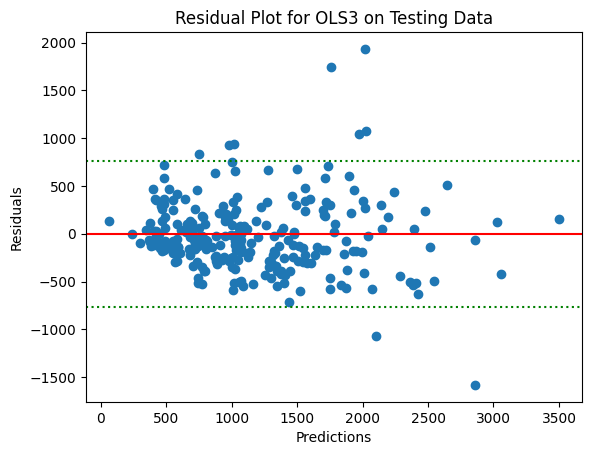

In [964]:
ols3_test_resids_plot = plt.scatter(preds_ols3_test, test3_residuals)
plt.axhline(y=0, color='r', linestyle='-')
plt.axhline(y=test_interval, color='g', linestyle=':')
plt.axhline(y=-test_interval, color='g', linestyle=':')
plt.title('Residual Plot for OLS3 on Testing Data')
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.show()

We can see a decent number of predictions falling outside the prediction interval. Most are positive (prediction significantly undershoots actual) but two are negative (overshoots). The shape of the residuals appears quite regular, fanning outwards.

We'll apply a normaltest to these residuals

In [965]:
statistic_train, p_value_train = stats.normaltest(test3_residuals)

alpha = 0.05
if p_value_train < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

The data does not appear to be normally distributed: reject the Null Hypothesis


Now we'll calculate what percentage of predictions fall within our prediction interval defined as +- 2 times the standard error.

In [966]:
within_interval = 0
outside_interval = 0
for resid in test3_residuals:
  if abs(resid) > interval:
    outside_interval += 1
  else:
    within_interval += 1

percent_within_interval = round((within_interval / len(test3_residuals)) * 100)

print(f"{percent_within_interval}% of predictions fall within the prediction interval")

97% of predictions fall within the prediction interval


We get 97% of predictions falling within the prediction interval, which is quite strong

Linechart

In [967]:
test_data_ols3 = pd.DataFrame({
    'Test Targets': y_test,
    'Test Preds': preds_ols3_test
})

ols3_test_chart = alt.Chart(test_data_ols3).mark_line(color='orange').encode(
    x=alt.X('Test Preds', title="Predicted Price (€)"),
    y=alt.Y('Test Targets', title="Actual Price (€)")
).properties(title="OLS3 Test Predictions against Targets")

ols3_test_chart + perf_test_chart

alt.LayerChart(...)

We can observe some very large errors occurring especially above 1500euros, even though the model does a good job of tracking the general trend line overall.

### [6.7.2] LC2

In [968]:
preds_lc2_test = lc2.predict(X5_test_scaled)
errors_lc2_test = compute_errors(y_test, preds_lc2_test, errors_lc2_train, "lc2_train", "lc2_test")

RMSE for lc2_test:  367.7789657967318
lc2_train RMSE:  332.96462999398466
RMSE improvement:  -34.814335802747166
RMSE improvement relative to overall errors: % -9.466103023952908

MAE for lc2_test:  268.2487198318375
lc2_train MAE:  249.15512447725555
MAE improvement:  -19.093595354581936
MAE improvement relative to overall errors: % -5.191595259728583

R2 for lc2_test:  0.721645775069534
lc2_train R2:  0.7402555342126911
R2 improvement:  -0.0186097591431571
R2 improvement relative to overall errors: % -2.5787941655120146


Model doesn't overfit fatally.

Graphing LC2

In [969]:
train_data_lc2 = pd.DataFrame({
    'Train Targets': y_train,
    'Train Preds': preds_lc2_train,
})

val_data_lc2 = pd.DataFrame({
    'Val Targets': y_val,
    'Val Preds': preds_lc2_val,
})

test_data_lc2 = pd.DataFrame({
    'Test Targets': y_test,
    'Test Preds': preds_lc2_test
})

perf_train_chart = alt.Chart(train_data_lc2).mark_line(color='green').encode(
    x='Train Targets',
    y='Train Targets'
)

perf_val_chart = alt.Chart(val_data_lc2).mark_line(color='green').encode(
    x='Val Targets',
    y='Val Targets'
)

perf_test_chart = alt.Chart(test_data_lc2).mark_line(color='green').encode(
    x=alt.X('Test Targets'),
    y=alt.Y('Test Targets')
)

lc2_train_chart = alt.Chart(train_data_lc2).mark_line(color='red').encode(
    x=alt.X('Train Targets', title='Actual Price'),
    y=alt.Y('Train Preds', title='Predicted Price'),
    color=alt.value('red')
).properties(title='LC2 Training Results')

lc2_val_chart = alt.Chart(val_data_lc2).mark_line(color='red').encode(
    x=alt.X('Val Targets', title='Actual Price'),
    y=alt.Y('Val Preds', title='Predicted Price')
).properties(title='LC2 Validation Results')

lc2_test_chart = perf_test_chart + alt.Chart(test_data_lc2).mark_line(color='red').encode(
    x=alt.X('Test Preds', title='Predicted Price (€)'),
    y=alt.Y('Test Targets', title='Actual Price (€)')).properties(
    title='LC2 Predictions (red) against target (green)')

In [970]:
lc2_train_chart = lc2_train_chart + perf_train_chart
lc2_train_chart

alt.LayerChart(...)

In [971]:
lc2_val_chart + perf_val_chart

alt.LayerChart(...)

In [972]:
perf_test_chart + lc2_test_chart

alt.LayerChart(...)

graphing MLR (blue) against LC2 (red)

In [973]:
ols3vlc2_chart = ols3_test_chart + lc2_test_chart + perf_test_chart

# ols3vlc2_chart.encode(
#     x=alt.X(title="Predicted Price (€)"),
#     y=alt.Y(title="Actual Price (€)")
# ).properties(title="OLS3 Predictions (orange) vs. LC2 Predictions (red)")

ols3vlc2_chart

alt.LayerChart(...)

Graphing LC2 preds against RF_gs preds (best parametric vs. best non-parametric)

In [974]:
rf_gs_test_chart

alt.Chart(...)

In [975]:
lc2_v_rf_gs = (perf_test_chart + lc2_test_chart + rf_gs_test_chart).encode(
    x=alt.X(axis=alt.Axis(title='')),
    y=alt.Y(axis=alt.Axis(title=''))
    ).properties(
        title="LC2 (red) vs. RF_GS (blue) predictions on test data").configure_legend(
        )
lc2_v_rf_gs

alt.LayerChart(...)

In [976]:
rf_gs_test_chart

alt.Chart(...)

In [977]:
lc2_test_chart

alt.LayerChart(...)

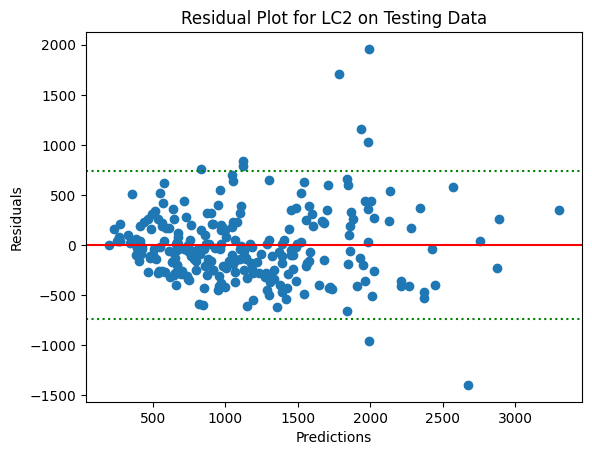

In [979]:
rmse_lc2_test = errors_lc2_test['rmse_lc2_test']

resids_lc2_test = y_test - preds_lc2_test
lc2_test_interval = 2 * rmse_lc2_test

lc2_test_resids_plot = plt.scatter(preds_lc2_test, resids_lc2_test)
plt.axhline(y=0, color='r', linestyle='-')
plt.axhline(y=lc2_test_interval, color='g', linestyle=':')
plt.axhline(y=-lc2_test_interval, color='g', linestyle=':')
plt.title('Residual Plot for LC2 on Testing Data')
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.show()

Residuals normality test

In [980]:
statistic, p_value = stats.normaltest(resids_lc2_test)

print("p-value: ", p_value)

alpha = 0.05
if p_value < alpha:
  print("The data does not appear to be normally distributed: reject the Null Hypothesis")
else:
  print("The data appears to be normally distributed: cannot reject the Null Hypothesis")

p-value:  1.5013795445862427e-16
The data does not appear to be normally distributed: reject the Null Hypothesis


(tests null hypothesis that a sample comes from a normal distribution: p-value is the probability that distribution is normal. as a rule if less than 0.05 we can reject)

Now we'll calculate what percentage of predictions fall within our prediction interval defined as +- 2 times the standard error.

In [981]:
within_interval = 0
outside_interval = 0
for resid in resids_lc2_test:
  if abs(resid) > lc2_test_interval:
    outside_interval += 1
  else:
    within_interval += 1

percent_within_interval = round((within_interval / len(resids_lc2_test)) * 100)

print(f"{percent_within_interval}% of predictions fall within the prediction interval")

97% of predictions fall within the prediction interval


Coefficients

In [982]:
lc2_coefs = lc2.coef_
lc2_coef_df = pd.DataFrame({
    'Feature': X5_train.columns,
    'Coefficient Weight': (lc2_coefs).round(2)
})
lc2_coef_df.sort_values('Coefficient Weight', ascending=False, inplace=True)
lc2_coef_df

,Feature,Coefficient Weight
0,Ram,3383.37
3,Pixels,693.79
21,TypeName_Workstation,471.19
1,Weight,365.30
5,Memory_SSD,247.15
6,Cpu_fast_high_end,222.64
12,TypeName_Ultrabook,171.65
17,Windows,154.98
33,Company_Apple,76.70
31,Company_Toshiba,66.84


In [983]:
lc2_coefs_nonzero = lc2_coef_df.loc[lc2_coef_df['Coefficient Weight'] != 0]
lc2_coefs_nonzero

,Feature,Coefficient Weight
0,Ram,3383.37
3,Pixels,693.79
21,TypeName_Workstation,471.19
1,Weight,365.30
5,Memory_SSD,247.15
6,Cpu_fast_high_end,222.64
12,TypeName_Ultrabook,171.65
17,Windows,154.98
33,Company_Apple,76.70
31,Company_Toshiba,66.84


### [6.7.3] RC2

Testing RC2

In [984]:
preds_rc2_test = rc2.predict(X5_test_scaled)
print("RC2 test errors compared with its training error: ")
errors_rc2_test = compute_errors(y_test, preds_rc2_test, errors_rc2_train, "rc2_train", "rc2_test")
print("")
print("RC2 test errors compared with LC2 test errors: ")
compute_errors(y_test, preds_lc2_test, errors_lc2_test, "lc2_test", "rc2_test")

RC2 test errors compared with its training error: 
RMSE for rc2_test:  372.76700459623146
rc2_train RMSE:  332.7601142864481
RMSE improvement:  -40.00689030978339
RMSE improvement relative to overall errors: % -10.732411886378594

MAE for rc2_test:  276.84866722977176
rc2_train MAE:  251.05723338287436
MAE improvement:  -25.791433846897405
MAE improvement relative to overall errors: % -6.918915442860564

R2 for rc2_test:  0.7140441597347805
rc2_train R2:  0.740574520098872
R2 improvement:  -0.02653036036409151
R2 improvement relative to overall errors: % -3.715506947629928

RC2 test errors compared with LC2 test errors: 
RMSE for rc2_test:  367.7789657967318
lc2_test RMSE:  367.7789657967318
RMSE improvement:  0.0
RMSE improvement relative to overall errors: % 0.0

MAE for rc2_test:  268.2487198318375
lc2_test MAE:  268.2487198318375
MAE improvement:  0.0
MAE improvement relative to overall errors: % 0.0

R2 for rc2_test:  0.721645775069534
lc2_test R2:  0.721645775069534
R2 improvemen

{'rmse_rc2_test': 367.7789657967318,
 'mae_rc2_test': 268.2487198318375,
 'r2_rc2_test': 0.721645775069534}

doesn't fatally overfit, results are literally identical to lc2's results

- On testing RC2 improves RMSE and R2 over training but gains MAE
- Literally no difference at all with LC2, which is a bit weird!

Graping RC2

In [985]:
errors_rc2_test

{'rmse_rc2_test': 372.76700459623146,
 'mae_rc2_test': 276.84866722977176,
 'r2_rc2_test': 0.7140441597347805}

In [986]:
train_data_rc2 = pd.DataFrame({
    'Train Targets': y_train,
    'Train Preds': preds_rc2_train,
})

val_data_rc2 = pd.DataFrame({
    'Val Targets': y_val,
    'Val Preds': preds_rc2_val,
})

test_data_rc2 = pd.DataFrame({
    'Test Targets': y_test,
    'Test Preds': preds_rc2_test
})

rc2_train_chart = alt.Chart(train_data_rc2).mark_line(color='purple').encode(
    x='Train Targets',
    y='Train Preds'
)

rc2_val_chart = alt.Chart(val_data_rc2).mark_line(color='purple').encode(
    x='Val Targets',
    y='Val Preds'
)

rc2_test_chart = alt.Chart(test_data_rc2).mark_line(color='purple').encode(
    x='Test Targets',
    y='Test Preds'
)

In [987]:
rc2_train_chart = alt.Chart(train_data_rc2).mark_line(color='purple').encode(
    x=alt.X('Train Targets', title='Actual Price'),
    y=alt.Y('Train Preds', title='Predicted Price')
)
rc2_train_chart + perf_train_chart

alt.LayerChart(...)

In [988]:
rc2_train_chart + perf_train_chart

alt.LayerChart(...)

In [989]:
rc2_val_chart + perf_val_chart

alt.LayerChart(...)

In [990]:
rc2_test_chart + perf_test_chart

alt.LayerChart(...)

### [6.7.4] EN_opt

In [991]:
preds_EN_opt_test = EN_opt.predict(X5_test_scaled)
errors_EN_opt_test = compute_errors(y_test, preds_EN_opt_test, errors_rc2_test, "rc2_test", "EN_opt_test")

RMSE for EN_opt_test:  369.0928979916272
rc2_test RMSE:  372.76700459623146
RMSE improvement:  3.674106604604276
RMSE improvement relative to overall errors: % 0.9954422381455907

MAE for EN_opt_test:  269.57653822226433
rc2_test MAE:  276.84866722977176
MAE improvement:  7.272129007507431
MAE improvement relative to overall errors: % 1.9702706410981656

R2 for EN_opt_test:  0.7196533180062772
rc2_test R2:  0.7140441597347805
R2 improvement:  0.0056091582714966615
R2 improvement relative to overall errors: % 0.7794250552524702


EN_opt performs slightly better on MAE and slightly worse on RMSE and R2 compared to RC2.

# **[7]** Model Evaluation and Comparison

In [992]:
rmse_generalization = []
mae_generalization = []
r2_generalization = []

r2_ols3_train = (r2_ols3_train * 100).round(3)
r2_ols3_test = (r2_ols3_test * 100).round(3)
gen_rmse_ols3 = rmse_ols3_test - rmse_ols3_train
gen_mae_ols3 = mae_ols3_test - mae_ols3_train
gen_r2_ols3 = -(r2_ols3_test - r2_ols3_train)  # r2 generalization here shows negative of test-train, so positive values are bad and negative is good (to keep consistent with the other generalization measures)
rmse_generalization.append(gen_rmse_ols3)
mae_generalization.append(gen_mae_ols3)
r2_generalization.append(gen_r2_ols3)

rmse_lc2_train = errors_lc2_train['rmse_lc2_train']
gen_rmse_lc2 = rmse_lc2_test - rmse_lc2_train
mae_lc2_test = errors_lc2_test['mae_lc2_test']
mae_lc2_train = errors_lc2_train['mae_lc2_train']
r2_lc2_test = (errors_lc2_test['r2_lc2_test'] * 100).round(3)
r2_lc2_train = (errors_lc2_train['r2_lc2_train'] * 100).round(3)
gen_mae_lc2= mae_lc2_test - mae_lc2_train
gen_r2_lc2 = -(r2_lc2_test - r2_lc2_train)
rmse_generalization.append(gen_rmse_lc2)
mae_generalization.append(gen_mae_lc2)
r2_generalization.append(gen_r2_lc2)

rmse_rc2_test = errors_rc2_test['rmse_rc2_test']
rmse_rc2_train = errors_rc2_train['rmse_rc2_train']
mae_rc2_test = errors_rc2_test['mae_rc2_test']
mae_rc2_train = errors_rc2_train['mae_rc2_train']
r2_rc2_test = (errors_rc2_test['r2_rc2_test'] * 100).round(3)
r2_rc2_train = (errors_rc2_train['r2_rc2_train'] * 100).round(3)
gen_rmse_rc2 = rmse_rc2_test - rmse_rc2_train
gen_mae_rc2 = mae_rc2_test - mae_rc2_train
gen_r2_rc2 = -(r2_rc2_test - r2_rc2_train)
rmse_generalization.append(gen_rmse_rc2)
mae_generalization.append(gen_mae_rc2)
r2_generalization.append(gen_r2_rc2)

rmse_EN_opt_test = errors_EN_opt_test['rmse_EN_opt_test']
rmse_EN_opt_train = errors_EN_opt_train['rmse_EN_opt_train']
mae_EN_opt_test = errors_EN_opt_test['mae_EN_opt_test']
mae_EN_opt_train = errors_EN_opt_train['mae_EN_opt_train']
r2_EN_opt_test = (errors_EN_opt_test['r2_EN_opt_test'] * 100).round(3)
r2_EN_opt_train = (errors_EN_opt_train['r2_EN_opt_train'] * 100).round(3)
gen_rmse_EN_opt = rmse_EN_opt_test - rmse_EN_opt_train
gen_mae_EN_opt = mae_EN_opt_test - mae_EN_opt_train
gen_r2_EN_opt = -(r2_EN_opt_test - r2_EN_opt_train)
rmse_generalization.append(gen_rmse_EN_opt)
mae_generalization.append(gen_mae_EN_opt)
r2_generalization.append(gen_r2_EN_opt)

In [993]:
test_frame = pd.DataFrame({
    'Model Name': ["OLS3", "LC2", "RC2", "EN_opt"],
    'Model Type': ["Multivariate Linear Regression", "Lasso", "Ridge", "ElasticNet"],
    'RMSE': [rmse_ols3_test, rmse_lc2_test, rmse_rc2_test, rmse_EN_opt_test],
    'MAE': [mae_ols3_test, mae_lc2_test, mae_rc2_test, mae_EN_opt_test],
    'R2': [r2_ols3_test, r2_lc2_test, r2_rc2_test, r2_EN_opt_test]
})

In [994]:
test_frame['RMSE Generalization'] = rmse_generalization
test_frame['MAE Generalization'] = mae_generalization
test_frame['R2 Generalization'] = r2_generalization

In [995]:
rf_test_frame['Model Type'] = "Random Forest"

In [996]:
rf_test_frame

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization,Model Type
0,rf7,370.41,244.16,71.765,76.58,49.15,8.005,Random Forest
1,rf15,350.29,231.78,74.749,138.14,81.91,14.711,Random Forest
2,rf16,350.69,232.00,74.691,135.01,79.11,14.409,Random Forest
3,rf17,348.18,227.48,75.052,153.03,91.69,16.028,Random Forest
4,rf_gs,343.68,226.42,75.692,210.04,133.02,20.128,Random Forest
5,rf_rand,351.03,230.58,74.642,146.65,85.84,15.568,Random Forest
6,rf_rand2,351.80,232.99,74.531,216.27,138.22,21.169,Random Forest


In [997]:
rf_test_frame.rename({'Model': 'Model Name'}, inplace=True, axis=1)

In [998]:
test_results = pd.concat([test_frame, rf_test_frame])

In [999]:
test_results.reset_index(inplace=True, drop=True)

In [1000]:
test_results['RMSE'] = test_results['RMSE'].round(2)
test_results['MAE'] = test_results['MAE'].round(2)
test_results['R2'] = test_results['R2']
test_results['RMSE Generalization'] = test_results['RMSE Generalization'].round(2)
test_results['MAE Generalization'] = test_results['MAE Generalization'].round(2)
test_results['R2 Generalization'] = test_results['R2 Generalization'].round(1)
test_results

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.2
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.9
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.7
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.5
4,rf7,Random Forest,370.41,244.16,71.765,76.58,49.15,8.0
5,rf15,Random Forest,350.29,231.78,74.749,138.14,81.91,14.7
6,rf16,Random Forest,350.69,232.00,74.691,135.01,79.11,14.4
7,rf17,Random Forest,348.18,227.48,75.052,153.03,91.69,16.0
8,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.1
9,rf_rand,Random Forest,351.03,230.58,74.642,146.65,85.84,15.6


In [1001]:
test_results.drop([4, 5, 6, 7, 9, 10], inplace=True)

In [1002]:
test_results.reset_index(drop=True, inplace=True)

In [1003]:
test_results

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.2
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.9
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.7
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.5
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.1


In [1004]:
tree_winners[['RMSE Generalization', 'MAE Generalization', 'R2 Generalization']] = tree_winners[['RMSE Generalization', 'MAE Generalization', 'R2 Generalization']] * -1
tree_winners

<ipython-input-1004-8e28089ebe44>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tree_winners[['RMSE Generalization', 'MAE Generalization', 'R2 Generalization']] = tree_winners[['RMSE Generalization', 'MAE Generalization', 'R2 Generalization']] * -1


,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
1,tree3,445.72,306.17,59.116,312.99,234.15,36.754
6,tree_grid2,395.89,281.22,67.747,23.22,40.41,-0.287


In [1005]:
tree_winners['Model Type'] = "Decision Tree"

<ipython-input-1005-f84cea72affa>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tree_winners['Model Type'] = "Decision Tree"


In [1006]:
tree_winners

,Model,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization,Model Type
1,tree3,445.72,306.17,59.116,312.99,234.15,36.754,Decision Tree
6,tree_grid2,395.89,281.22,67.747,23.22,40.41,-0.287,Decision Tree


In [1007]:
tree_winners = tree_winners.rename({'Model': 'Model Name'}, axis=1)
tree_winners

,Model Name,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization,Model Type
1,tree3,445.72,306.17,59.116,312.99,234.15,36.754,Decision Tree
6,tree_grid2,395.89,281.22,67.747,23.22,40.41,-0.287,Decision Tree


In [1008]:
test_results = pd.concat([test_results, tree_winners])
test_results

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287


Models ranked by RMSE score

In [1009]:
models_by_rmse_generalization = test_results.sort_values('RMSE Generalization')
models_by_mae_generalization = test_results.sort_values('MAE Generalization')
models_by_r2_generalization = test_results.sort_values('R2 Generalization')

In [1010]:
models_by_rmse_score = test_results.sort_values('RMSE')
models_by_rmse_score.reset_index(inplace=True, drop=True)
models_by_rmse_score.to_csv("models_by_rmse")
models_by_rmse_score

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
2,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
3,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
4,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
5,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
6,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


LC2 has the best RMSE for a linear model

In [1011]:
models_by_mae = test_results.sort_values('MAE')
models_by_mae

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


In [1012]:
models_by_r2 = test_results.sort_values('R2', ascending=False)
models_by_r2

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


LC2 is the best of the linear models on all measures

RC2 is highest performing Linear Regression model on RMSE, but RF models are better

In [1013]:
models_by_rmse_generalization

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


LC2 has lowest RMSE generalization

In [1014]:
models_by_mae_generalization

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


and lowest mae generalization

In [1015]:
models_by_r2_generalization

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
6,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
0,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
2,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
3,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
4,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


and again lowest r2 generalization

anayzing RC2

In [1016]:
len(rc2.coef_)

45

In [1017]:
len(X5_train.columns)

45

In [1018]:
rc2

Ridge(alpha=2.0, random_state=2)

In [1019]:
rc2_coefficient_weights = pd.DataFrame({
    'Feature': X5_test.columns,
    'Coefficient Weight': rc2.coef_
})
rc2_coefficient_weights.sort_values('Coefficient Weight', ascending=False, inplace=True)
rc2_coefficient_weights.reset_index(drop=True, inplace=True)
rc2_coefficient_weights.to_csv("RC2 Coefficients")
rc2_coefficient_weights

,Feature,Coefficient Weight
0,Ram,2143.731519
1,Pixels,778.897422
2,Weight,737.308955
3,TypeName_Workstation,438.106367
4,Windows,415.695193
5,Company_Apple,344.855678
6,Company_LG,341.664371
7,Company_Microsoft,341.347102
8,Memory_SSD,294.717745
9,Memory_GB,279.690490


In [1020]:
models_by_mae_score = test_results.sort_values('MAE')
models_by_mae_score.reset_index(inplace=True, drop=True)
models_by_mae_score.to_csv("models_by_mae")
models_by_mae_score

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
2,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
3,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
4,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
5,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
6,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


In [1021]:
models_by_r2 = test_results.sort_values('R2', ascending=False)
models_by_r2.reset_index(inplace=True, drop=True)
models_by_r2.to_csv("models_by_r2")
models_by_r2

,Model Name,Model Type,RMSE,MAE,R2,RMSE Generalization,MAE Generalization,R2 Generalization
0,rf_gs,Random Forest,343.68,226.42,75.692,210.04,133.02,20.100
1,LC2,Lasso,367.78,268.25,72.165,34.81,19.09,1.900
2,EN_opt,ElasticNet,369.09,269.58,71.965,45.45,26.89,3.500
3,RC2,Ridge,372.77,276.85,71.404,40.01,25.79,2.700
4,OLS3,Multivariate Linear Regression,382.68,279.51,69.863,37.66,21.21,2.200
5,tree_grid2,Decision Tree,395.89,281.22,67.747,23.22,40.41,-0.287
6,tree3,Decision Tree,445.72,306.17,59.116,312.99,234.15,36.754


We can see that rf_grid is the winner so far on all measures